# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [2]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [3]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [4]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [5]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

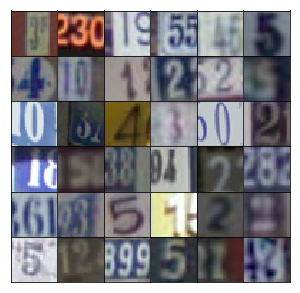

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [10]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512)
        
        layer = tf.reshape(x, (-1,4,4,512))
        layer = tf.layers.batch_normalization(layer, training=training)
        layer = tf.maximum(alpha * layer, layer)
        
        conv1 = tf.layers.conv2d_transpose(layer, 256, 5, strides=2, padding='same')
        layer = tf.layers.batch_normalization(conv1, training=training)
        layer = tf.maximum(alpha * layer, layer)
        
        conv2 = tf.layers.conv2d_transpose(layer, 128, 5, strides=2, padding='same')
        layer = tf.layers.batch_normalization(conv2, training=training)
        layer = tf.maximum(alpha * layer, layer)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(layer, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [11]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        x = tf.maximum(alpha * x, x)
        
        x = tf.layers.conv2d(x, 128, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha * x, x)
        
        x = tf.layers.conv2d(x, 256, 5, strides=2, padding='same')
        x = tf.layers.batch_normalization(x, training=True)
        x = tf.maximum(alpha * x, x)
        
        flat = tf.reshape(x, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [21]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.0978... Generator Loss: 0.7499
Epoch 1/25... Discriminator Loss: 0.5546... Generator Loss: 1.2746
Epoch 1/25... Discriminator Loss: 0.1268... Generator Loss: 2.8738
Epoch 1/25... Discriminator Loss: 0.1286... Generator Loss: 2.9214
Epoch 1/25... Discriminator Loss: 0.1590... Generator Loss: 2.4942
Epoch 1/25... Discriminator Loss: 0.0778... Generator Loss: 3.4066
Epoch 1/25... Discriminator Loss: 0.1204... Generator Loss: 3.0515
Epoch 1/25... Discriminator Loss: 0.2611... Generator Loss: 2.3105
Epoch 1/25... Discriminator Loss: 0.1474... Generator Loss: 2.9332
Epoch 1/25... Discriminator Loss: 0.1933... Generator Loss: 3.3474


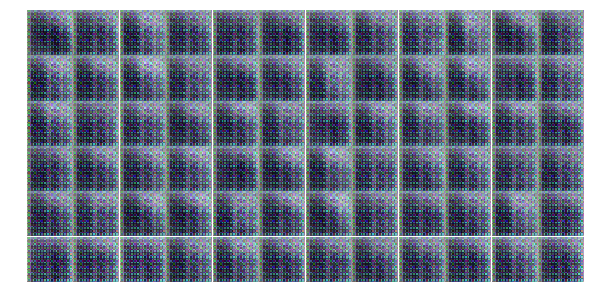

Epoch 1/25... Discriminator Loss: 0.1400... Generator Loss: 2.9197
Epoch 1/25... Discriminator Loss: 0.7230... Generator Loss: 2.1334
Epoch 1/25... Discriminator Loss: 0.4970... Generator Loss: 1.7186
Epoch 1/25... Discriminator Loss: 0.3443... Generator Loss: 2.2782
Epoch 1/25... Discriminator Loss: 0.4527... Generator Loss: 1.9517
Epoch 1/25... Discriminator Loss: 0.6703... Generator Loss: 1.0713
Epoch 1/25... Discriminator Loss: 0.2478... Generator Loss: 2.3422
Epoch 1/25... Discriminator Loss: 0.2876... Generator Loss: 2.6777
Epoch 1/25... Discriminator Loss: 2.3408... Generator Loss: 8.4816
Epoch 1/25... Discriminator Loss: 1.0006... Generator Loss: 1.7227


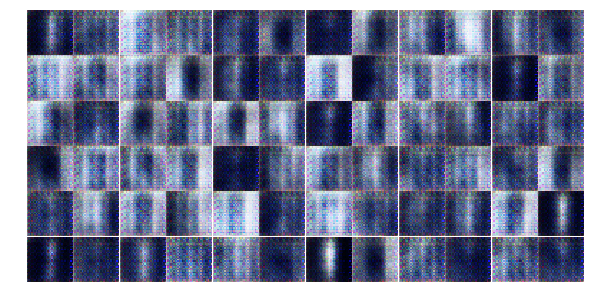

Epoch 1/25... Discriminator Loss: 0.7817... Generator Loss: 0.8887
Epoch 1/25... Discriminator Loss: 0.3146... Generator Loss: 4.1442
Epoch 1/25... Discriminator Loss: 0.7251... Generator Loss: 3.7840
Epoch 1/25... Discriminator Loss: 0.6663... Generator Loss: 1.6775
Epoch 1/25... Discriminator Loss: 0.6334... Generator Loss: 4.3576
Epoch 1/25... Discriminator Loss: 0.9458... Generator Loss: 0.7031
Epoch 1/25... Discriminator Loss: 0.6778... Generator Loss: 1.2382
Epoch 1/25... Discriminator Loss: 0.3213... Generator Loss: 2.1621
Epoch 1/25... Discriminator Loss: 0.6778... Generator Loss: 3.7323
Epoch 1/25... Discriminator Loss: 0.8041... Generator Loss: 1.7927


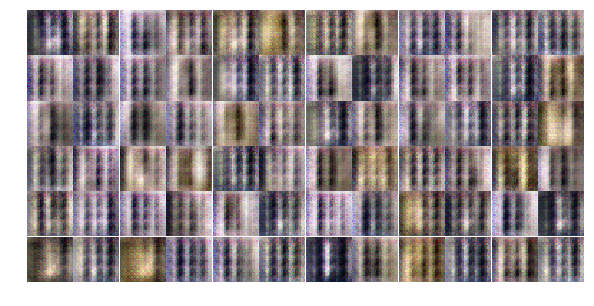

Epoch 1/25... Discriminator Loss: 0.6464... Generator Loss: 1.6249
Epoch 1/25... Discriminator Loss: 0.8582... Generator Loss: 1.9180
Epoch 1/25... Discriminator Loss: 0.6274... Generator Loss: 1.4804
Epoch 1/25... Discriminator Loss: 0.5733... Generator Loss: 1.6166
Epoch 1/25... Discriminator Loss: 0.4081... Generator Loss: 1.6181
Epoch 1/25... Discriminator Loss: 0.3461... Generator Loss: 2.3237
Epoch 1/25... Discriminator Loss: 0.5061... Generator Loss: 1.3290
Epoch 1/25... Discriminator Loss: 0.7124... Generator Loss: 1.7495
Epoch 1/25... Discriminator Loss: 0.4214... Generator Loss: 2.1931
Epoch 1/25... Discriminator Loss: 0.4845... Generator Loss: 1.7086


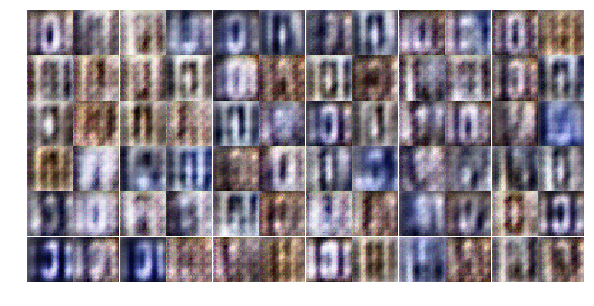

Epoch 1/25... Discriminator Loss: 0.4267... Generator Loss: 2.0048
Epoch 1/25... Discriminator Loss: 0.5126... Generator Loss: 1.4328
Epoch 1/25... Discriminator Loss: 0.3729... Generator Loss: 1.8504
Epoch 1/25... Discriminator Loss: 0.6924... Generator Loss: 1.4272
Epoch 1/25... Discriminator Loss: 0.2747... Generator Loss: 2.1164
Epoch 1/25... Discriminator Loss: 1.4224... Generator Loss: 0.5603
Epoch 1/25... Discriminator Loss: 0.7749... Generator Loss: 1.1756
Epoch 1/25... Discriminator Loss: 0.8641... Generator Loss: 0.8376
Epoch 1/25... Discriminator Loss: 0.7430... Generator Loss: 1.0124
Epoch 1/25... Discriminator Loss: 0.5970... Generator Loss: 1.6505


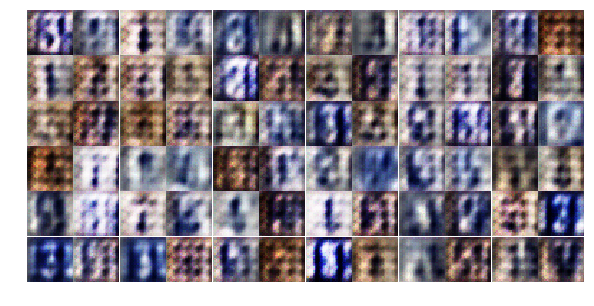

Epoch 1/25... Discriminator Loss: 0.6181... Generator Loss: 1.7504
Epoch 1/25... Discriminator Loss: 1.1225... Generator Loss: 0.6346
Epoch 1/25... Discriminator Loss: 0.5677... Generator Loss: 1.8586
Epoch 1/25... Discriminator Loss: 0.7419... Generator Loss: 1.1144
Epoch 1/25... Discriminator Loss: 0.7592... Generator Loss: 1.4654
Epoch 1/25... Discriminator Loss: 0.5511... Generator Loss: 1.5868
Epoch 1/25... Discriminator Loss: 0.8040... Generator Loss: 1.4531
Epoch 2/25... Discriminator Loss: 0.6334... Generator Loss: 1.6392
Epoch 2/25... Discriminator Loss: 0.8030... Generator Loss: 2.4224
Epoch 2/25... Discriminator Loss: 1.2333... Generator Loss: 0.6660


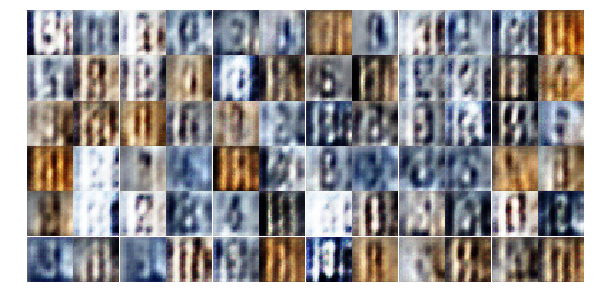

Epoch 2/25... Discriminator Loss: 0.8237... Generator Loss: 1.1433
Epoch 2/25... Discriminator Loss: 1.0002... Generator Loss: 0.9243
Epoch 2/25... Discriminator Loss: 1.0863... Generator Loss: 1.2182
Epoch 2/25... Discriminator Loss: 0.8158... Generator Loss: 1.3108
Epoch 2/25... Discriminator Loss: 1.1888... Generator Loss: 0.9343
Epoch 2/25... Discriminator Loss: 0.9123... Generator Loss: 1.0356
Epoch 2/25... Discriminator Loss: 0.6980... Generator Loss: 1.4164
Epoch 2/25... Discriminator Loss: 0.6173... Generator Loss: 1.7986
Epoch 2/25... Discriminator Loss: 0.8341... Generator Loss: 1.8725
Epoch 2/25... Discriminator Loss: 1.0992... Generator Loss: 1.2425


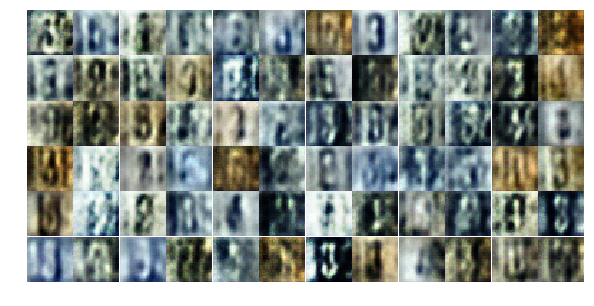

Epoch 2/25... Discriminator Loss: 1.0927... Generator Loss: 1.5003
Epoch 2/25... Discriminator Loss: 0.9452... Generator Loss: 1.3764
Epoch 2/25... Discriminator Loss: 1.2377... Generator Loss: 1.1831
Epoch 2/25... Discriminator Loss: 0.6406... Generator Loss: 1.1948
Epoch 2/25... Discriminator Loss: 1.4815... Generator Loss: 2.0258
Epoch 2/25... Discriminator Loss: 0.9815... Generator Loss: 1.5837
Epoch 2/25... Discriminator Loss: 1.2272... Generator Loss: 1.3873
Epoch 2/25... Discriminator Loss: 1.0307... Generator Loss: 1.1210
Epoch 2/25... Discriminator Loss: 0.9537... Generator Loss: 1.3013
Epoch 2/25... Discriminator Loss: 1.0536... Generator Loss: 0.8468


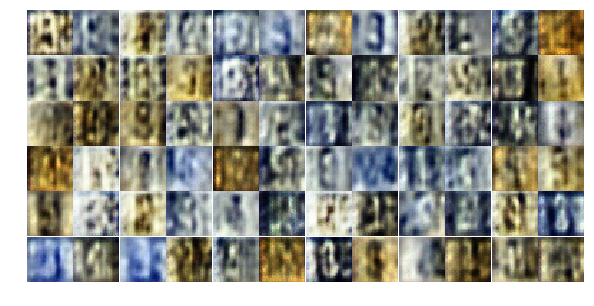

Epoch 2/25... Discriminator Loss: 1.0456... Generator Loss: 1.1004
Epoch 2/25... Discriminator Loss: 0.9355... Generator Loss: 1.1937
Epoch 2/25... Discriminator Loss: 0.7626... Generator Loss: 1.2790
Epoch 2/25... Discriminator Loss: 0.9460... Generator Loss: 1.2429
Epoch 2/25... Discriminator Loss: 0.8378... Generator Loss: 1.5294
Epoch 2/25... Discriminator Loss: 0.9566... Generator Loss: 1.3530
Epoch 2/25... Discriminator Loss: 1.0045... Generator Loss: 0.7277
Epoch 2/25... Discriminator Loss: 1.1260... Generator Loss: 0.7896
Epoch 2/25... Discriminator Loss: 0.8974... Generator Loss: 1.1347
Epoch 2/25... Discriminator Loss: 0.7458... Generator Loss: 1.5445


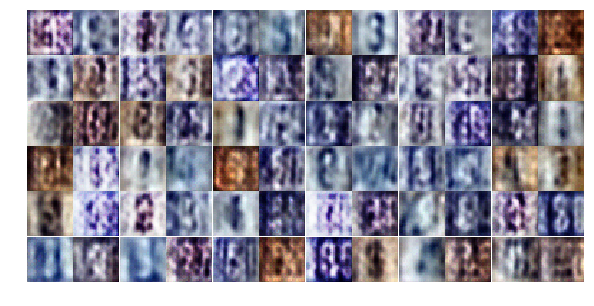

Epoch 2/25... Discriminator Loss: 1.2966... Generator Loss: 1.5795
Epoch 2/25... Discriminator Loss: 0.9507... Generator Loss: 1.1381
Epoch 2/25... Discriminator Loss: 1.1695... Generator Loss: 0.7633
Epoch 2/25... Discriminator Loss: 1.3465... Generator Loss: 0.5057
Epoch 2/25... Discriminator Loss: 0.7245... Generator Loss: 1.7471
Epoch 2/25... Discriminator Loss: 0.9472... Generator Loss: 1.2475
Epoch 2/25... Discriminator Loss: 0.8277... Generator Loss: 1.1186
Epoch 2/25... Discriminator Loss: 1.3202... Generator Loss: 0.8364
Epoch 2/25... Discriminator Loss: 0.8729... Generator Loss: 1.4139
Epoch 2/25... Discriminator Loss: 0.7854... Generator Loss: 1.1247


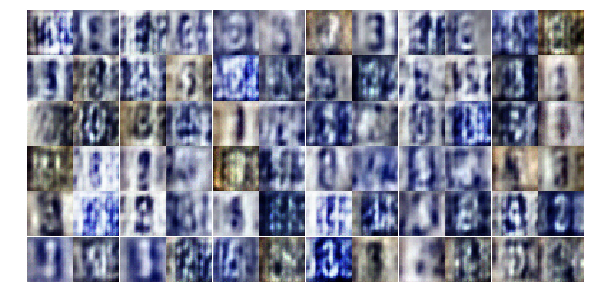

Epoch 2/25... Discriminator Loss: 0.6591... Generator Loss: 1.5129
Epoch 2/25... Discriminator Loss: 0.7701... Generator Loss: 1.4792
Epoch 2/25... Discriminator Loss: 0.8712... Generator Loss: 1.2553
Epoch 2/25... Discriminator Loss: 1.2498... Generator Loss: 0.6353
Epoch 2/25... Discriminator Loss: 1.2149... Generator Loss: 0.5496
Epoch 2/25... Discriminator Loss: 1.4705... Generator Loss: 0.4289
Epoch 2/25... Discriminator Loss: 0.9644... Generator Loss: 1.5301
Epoch 2/25... Discriminator Loss: 0.7598... Generator Loss: 1.1050
Epoch 2/25... Discriminator Loss: 0.5337... Generator Loss: 1.7475
Epoch 2/25... Discriminator Loss: 0.9605... Generator Loss: 1.1082


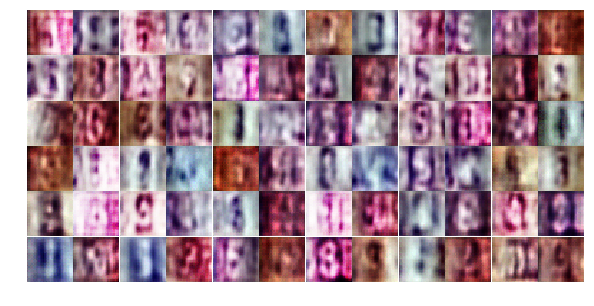

Epoch 2/25... Discriminator Loss: 0.9135... Generator Loss: 0.9712
Epoch 2/25... Discriminator Loss: 0.8406... Generator Loss: 1.5045
Epoch 2/25... Discriminator Loss: 0.9973... Generator Loss: 0.8629
Epoch 2/25... Discriminator Loss: 1.1259... Generator Loss: 0.8410
Epoch 3/25... Discriminator Loss: 0.8440... Generator Loss: 1.3354
Epoch 3/25... Discriminator Loss: 0.6600... Generator Loss: 1.2537
Epoch 3/25... Discriminator Loss: 0.6549... Generator Loss: 1.2105
Epoch 3/25... Discriminator Loss: 0.4716... Generator Loss: 1.5857
Epoch 3/25... Discriminator Loss: 0.8576... Generator Loss: 1.4631
Epoch 3/25... Discriminator Loss: 0.8921... Generator Loss: 1.2448


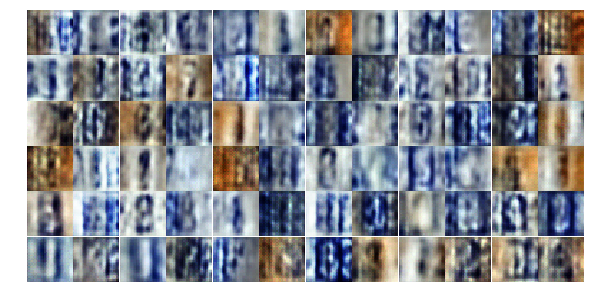

Epoch 3/25... Discriminator Loss: 0.9330... Generator Loss: 1.8168
Epoch 3/25... Discriminator Loss: 0.6740... Generator Loss: 1.3817
Epoch 3/25... Discriminator Loss: 0.7304... Generator Loss: 1.0686
Epoch 3/25... Discriminator Loss: 0.7419... Generator Loss: 1.4681
Epoch 3/25... Discriminator Loss: 1.0909... Generator Loss: 0.6671
Epoch 3/25... Discriminator Loss: 0.8782... Generator Loss: 0.9546
Epoch 3/25... Discriminator Loss: 0.5872... Generator Loss: 1.4030
Epoch 3/25... Discriminator Loss: 0.5822... Generator Loss: 1.7865
Epoch 3/25... Discriminator Loss: 0.8367... Generator Loss: 0.9117
Epoch 3/25... Discriminator Loss: 0.4209... Generator Loss: 1.8817


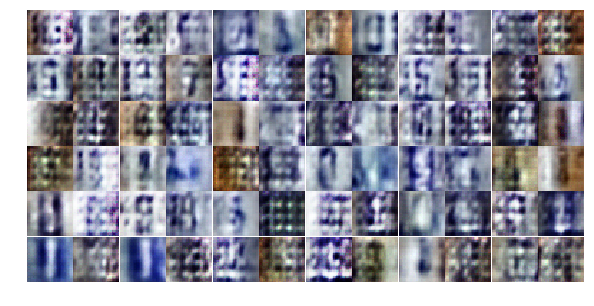

Epoch 3/25... Discriminator Loss: 0.6561... Generator Loss: 1.4878
Epoch 3/25... Discriminator Loss: 0.8032... Generator Loss: 1.0426
Epoch 3/25... Discriminator Loss: 1.2852... Generator Loss: 0.5170
Epoch 3/25... Discriminator Loss: 0.6426... Generator Loss: 1.8385
Epoch 3/25... Discriminator Loss: 0.7862... Generator Loss: 0.9408
Epoch 3/25... Discriminator Loss: 0.4701... Generator Loss: 1.7337
Epoch 3/25... Discriminator Loss: 0.5576... Generator Loss: 1.1594
Epoch 3/25... Discriminator Loss: 0.7433... Generator Loss: 1.0885
Epoch 3/25... Discriminator Loss: 0.4140... Generator Loss: 2.4030
Epoch 3/25... Discriminator Loss: 0.6260... Generator Loss: 1.2580


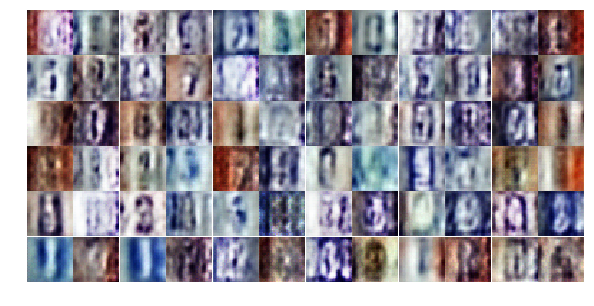

Epoch 3/25... Discriminator Loss: 0.6542... Generator Loss: 1.7303
Epoch 3/25... Discriminator Loss: 0.7250... Generator Loss: 1.1080
Epoch 3/25... Discriminator Loss: 0.5178... Generator Loss: 1.4864
Epoch 3/25... Discriminator Loss: 0.7310... Generator Loss: 0.9474
Epoch 3/25... Discriminator Loss: 0.6388... Generator Loss: 1.3576
Epoch 3/25... Discriminator Loss: 0.8430... Generator Loss: 0.8540
Epoch 3/25... Discriminator Loss: 0.7420... Generator Loss: 1.6206
Epoch 3/25... Discriminator Loss: 0.6069... Generator Loss: 1.2657
Epoch 3/25... Discriminator Loss: 0.5116... Generator Loss: 1.8634
Epoch 3/25... Discriminator Loss: 0.6227... Generator Loss: 1.5099


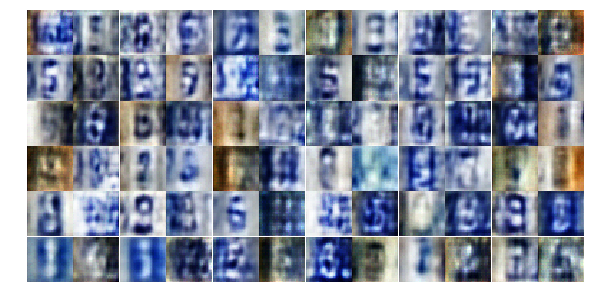

Epoch 3/25... Discriminator Loss: 0.8156... Generator Loss: 3.0522
Epoch 3/25... Discriminator Loss: 0.3653... Generator Loss: 2.4583
Epoch 3/25... Discriminator Loss: 0.4211... Generator Loss: 1.5980
Epoch 3/25... Discriminator Loss: 0.7320... Generator Loss: 1.0213
Epoch 3/25... Discriminator Loss: 0.6321... Generator Loss: 1.8778
Epoch 3/25... Discriminator Loss: 0.3245... Generator Loss: 2.0625
Epoch 3/25... Discriminator Loss: 0.8264... Generator Loss: 1.0570
Epoch 3/25... Discriminator Loss: 0.5365... Generator Loss: 1.7599
Epoch 3/25... Discriminator Loss: 1.6968... Generator Loss: 0.2981
Epoch 3/25... Discriminator Loss: 0.7254... Generator Loss: 1.3265


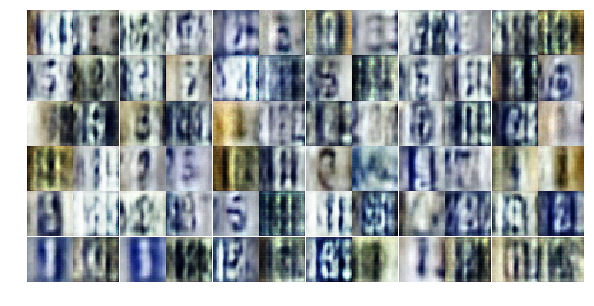

Epoch 3/25... Discriminator Loss: 0.9519... Generator Loss: 0.7977
Epoch 3/25... Discriminator Loss: 0.6038... Generator Loss: 1.5726
Epoch 3/25... Discriminator Loss: 0.6075... Generator Loss: 1.2239
Epoch 3/25... Discriminator Loss: 0.6628... Generator Loss: 1.1051
Epoch 3/25... Discriminator Loss: 0.4953... Generator Loss: 2.2909
Epoch 3/25... Discriminator Loss: 0.4381... Generator Loss: 2.0119
Epoch 3/25... Discriminator Loss: 0.5147... Generator Loss: 2.3637
Epoch 3/25... Discriminator Loss: 0.5224... Generator Loss: 2.0224
Epoch 3/25... Discriminator Loss: 0.4706... Generator Loss: 1.7180
Epoch 3/25... Discriminator Loss: 0.3789... Generator Loss: 2.1256


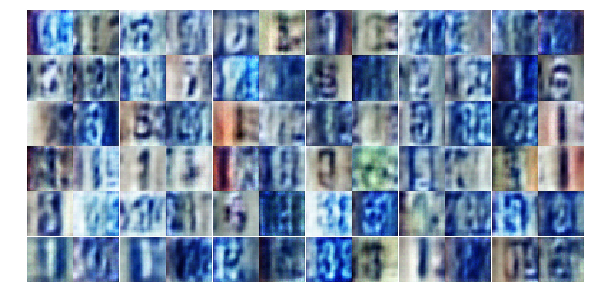

Epoch 3/25... Discriminator Loss: 1.2156... Generator Loss: 0.6335
Epoch 4/25... Discriminator Loss: 1.0611... Generator Loss: 0.5707
Epoch 4/25... Discriminator Loss: 0.7205... Generator Loss: 1.4231
Epoch 4/25... Discriminator Loss: 1.1770... Generator Loss: 0.5319
Epoch 4/25... Discriminator Loss: 0.6390... Generator Loss: 1.2662
Epoch 4/25... Discriminator Loss: 0.3952... Generator Loss: 2.1798
Epoch 4/25... Discriminator Loss: 0.8413... Generator Loss: 2.0875
Epoch 4/25... Discriminator Loss: 0.7879... Generator Loss: 1.7035
Epoch 4/25... Discriminator Loss: 0.7209... Generator Loss: 1.0444
Epoch 4/25... Discriminator Loss: 0.3656... Generator Loss: 1.9028


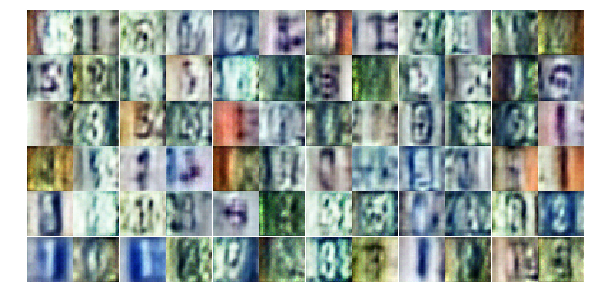

Epoch 4/25... Discriminator Loss: 0.4361... Generator Loss: 1.5987
Epoch 4/25... Discriminator Loss: 1.0090... Generator Loss: 0.7377
Epoch 4/25... Discriminator Loss: 0.8081... Generator Loss: 1.0598
Epoch 4/25... Discriminator Loss: 0.7747... Generator Loss: 0.8387
Epoch 4/25... Discriminator Loss: 0.7176... Generator Loss: 1.9076
Epoch 4/25... Discriminator Loss: 1.2022... Generator Loss: 0.4742
Epoch 4/25... Discriminator Loss: 1.6011... Generator Loss: 0.3322
Epoch 4/25... Discriminator Loss: 0.6316... Generator Loss: 1.1888
Epoch 4/25... Discriminator Loss: 0.9495... Generator Loss: 0.6879
Epoch 4/25... Discriminator Loss: 0.7431... Generator Loss: 2.2671


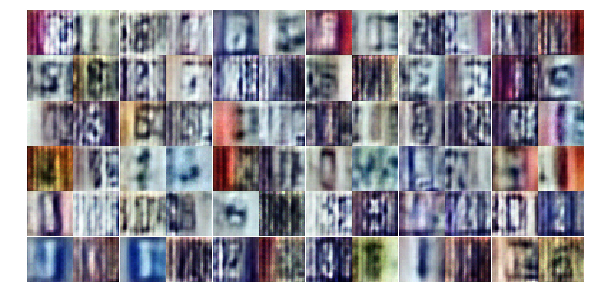

Epoch 4/25... Discriminator Loss: 0.6937... Generator Loss: 1.0669
Epoch 4/25... Discriminator Loss: 0.3100... Generator Loss: 2.1203
Epoch 4/25... Discriminator Loss: 0.7608... Generator Loss: 0.9281
Epoch 4/25... Discriminator Loss: 0.4374... Generator Loss: 1.5951
Epoch 4/25... Discriminator Loss: 0.5039... Generator Loss: 1.2563
Epoch 4/25... Discriminator Loss: 0.2150... Generator Loss: 2.9017
Epoch 4/25... Discriminator Loss: 1.2341... Generator Loss: 0.5485
Epoch 4/25... Discriminator Loss: 1.2864... Generator Loss: 0.6434
Epoch 4/25... Discriminator Loss: 0.4576... Generator Loss: 1.9446
Epoch 4/25... Discriminator Loss: 0.4800... Generator Loss: 1.4216


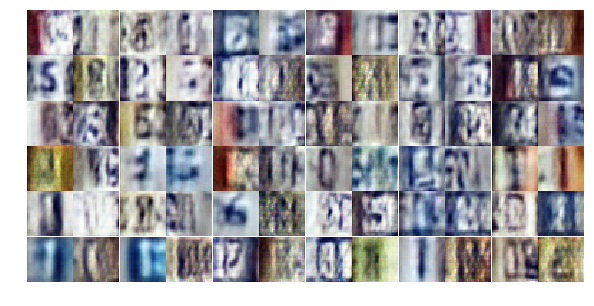

Epoch 4/25... Discriminator Loss: 0.4572... Generator Loss: 1.6784
Epoch 4/25... Discriminator Loss: 0.4350... Generator Loss: 1.7639
Epoch 4/25... Discriminator Loss: 0.5299... Generator Loss: 1.3785
Epoch 4/25... Discriminator Loss: 0.3576... Generator Loss: 1.9297
Epoch 4/25... Discriminator Loss: 0.3464... Generator Loss: 2.0568
Epoch 4/25... Discriminator Loss: 0.6253... Generator Loss: 1.1024
Epoch 4/25... Discriminator Loss: 0.4356... Generator Loss: 1.5119
Epoch 4/25... Discriminator Loss: 1.4605... Generator Loss: 0.3834
Epoch 4/25... Discriminator Loss: 0.8863... Generator Loss: 0.8119
Epoch 4/25... Discriminator Loss: 0.7861... Generator Loss: 1.0529


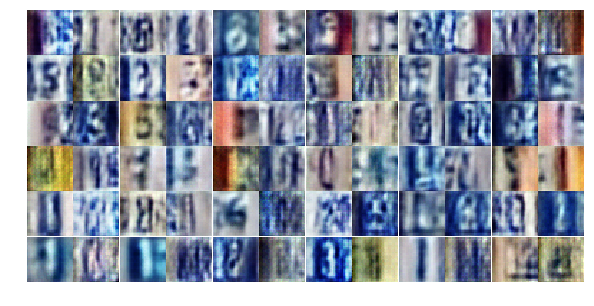

Epoch 4/25... Discriminator Loss: 0.4977... Generator Loss: 2.4184
Epoch 4/25... Discriminator Loss: 0.3364... Generator Loss: 1.6660
Epoch 4/25... Discriminator Loss: 0.3266... Generator Loss: 1.8497
Epoch 4/25... Discriminator Loss: 0.2961... Generator Loss: 2.2934
Epoch 4/25... Discriminator Loss: 0.2871... Generator Loss: 2.1241
Epoch 4/25... Discriminator Loss: 0.6531... Generator Loss: 2.4672
Epoch 4/25... Discriminator Loss: 0.7639... Generator Loss: 1.7822
Epoch 4/25... Discriminator Loss: 0.5419... Generator Loss: 2.2048
Epoch 4/25... Discriminator Loss: 0.5585... Generator Loss: 1.3646
Epoch 4/25... Discriminator Loss: 0.5291... Generator Loss: 1.3182


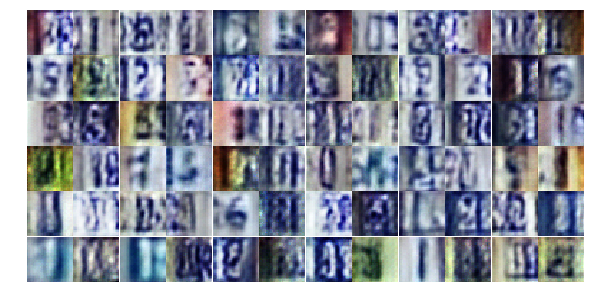

Epoch 4/25... Discriminator Loss: 0.5541... Generator Loss: 1.2430
Epoch 4/25... Discriminator Loss: 0.4207... Generator Loss: 1.5475
Epoch 4/25... Discriminator Loss: 0.3102... Generator Loss: 2.3376
Epoch 4/25... Discriminator Loss: 0.5044... Generator Loss: 1.2690
Epoch 4/25... Discriminator Loss: 0.9509... Generator Loss: 0.7339
Epoch 4/25... Discriminator Loss: 0.9515... Generator Loss: 2.8738
Epoch 4/25... Discriminator Loss: 0.6798... Generator Loss: 1.0013
Epoch 4/25... Discriminator Loss: 1.2252... Generator Loss: 2.8735
Epoch 4/25... Discriminator Loss: 0.7363... Generator Loss: 2.5223
Epoch 5/25... Discriminator Loss: 0.4060... Generator Loss: 1.5462


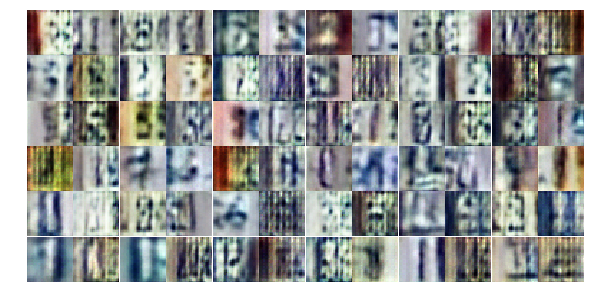

Epoch 5/25... Discriminator Loss: 0.4898... Generator Loss: 1.7316
Epoch 5/25... Discriminator Loss: 0.6071... Generator Loss: 1.4019
Epoch 5/25... Discriminator Loss: 0.6728... Generator Loss: 1.0676
Epoch 5/25... Discriminator Loss: 0.5940... Generator Loss: 1.1040
Epoch 5/25... Discriminator Loss: 0.4956... Generator Loss: 1.6182
Epoch 5/25... Discriminator Loss: 0.8453... Generator Loss: 0.7907
Epoch 5/25... Discriminator Loss: 0.4038... Generator Loss: 1.6707
Epoch 5/25... Discriminator Loss: 0.6419... Generator Loss: 1.0219
Epoch 5/25... Discriminator Loss: 0.5478... Generator Loss: 1.5019
Epoch 5/25... Discriminator Loss: 0.7313... Generator Loss: 1.4443


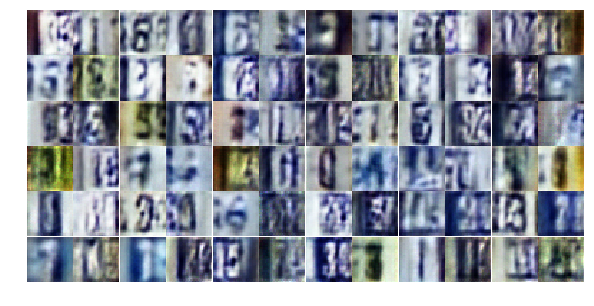

Epoch 5/25... Discriminator Loss: 0.5383... Generator Loss: 1.4427
Epoch 5/25... Discriminator Loss: 0.4288... Generator Loss: 1.5289
Epoch 5/25... Discriminator Loss: 0.3582... Generator Loss: 2.0959
Epoch 5/25... Discriminator Loss: 1.2500... Generator Loss: 1.0632
Epoch 5/25... Discriminator Loss: 1.0412... Generator Loss: 3.0066
Epoch 5/25... Discriminator Loss: 0.7450... Generator Loss: 1.1554
Epoch 5/25... Discriminator Loss: 0.7328... Generator Loss: 1.0242
Epoch 5/25... Discriminator Loss: 1.6062... Generator Loss: 0.3357
Epoch 5/25... Discriminator Loss: 0.4656... Generator Loss: 1.9574
Epoch 5/25... Discriminator Loss: 0.6100... Generator Loss: 1.1928


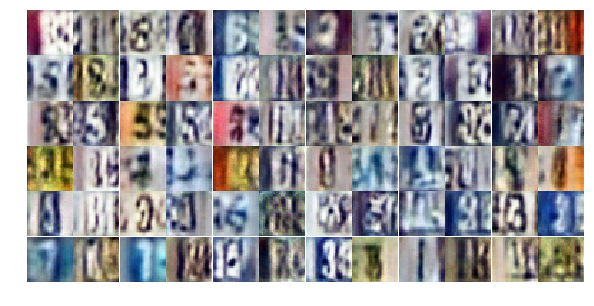

Epoch 5/25... Discriminator Loss: 0.4677... Generator Loss: 1.5091
Epoch 5/25... Discriminator Loss: 0.8132... Generator Loss: 0.8614
Epoch 5/25... Discriminator Loss: 0.4261... Generator Loss: 1.8556
Epoch 5/25... Discriminator Loss: 0.7407... Generator Loss: 0.9442
Epoch 5/25... Discriminator Loss: 0.6014... Generator Loss: 1.1301
Epoch 5/25... Discriminator Loss: 0.7755... Generator Loss: 0.7734
Epoch 5/25... Discriminator Loss: 0.6676... Generator Loss: 0.9896
Epoch 5/25... Discriminator Loss: 2.8478... Generator Loss: 0.1269
Epoch 5/25... Discriminator Loss: 1.0175... Generator Loss: 0.7645
Epoch 5/25... Discriminator Loss: 0.7445... Generator Loss: 1.1808


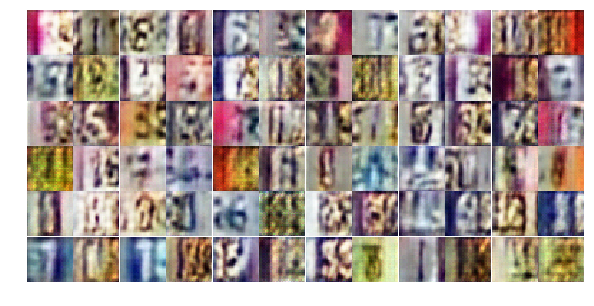

Epoch 5/25... Discriminator Loss: 0.6456... Generator Loss: 1.3477
Epoch 5/25... Discriminator Loss: 0.8386... Generator Loss: 1.5736
Epoch 5/25... Discriminator Loss: 0.6422... Generator Loss: 1.0881
Epoch 5/25... Discriminator Loss: 1.0490... Generator Loss: 0.5997
Epoch 5/25... Discriminator Loss: 0.5518... Generator Loss: 1.4207
Epoch 5/25... Discriminator Loss: 0.4560... Generator Loss: 2.5250
Epoch 5/25... Discriminator Loss: 0.6574... Generator Loss: 1.0454
Epoch 5/25... Discriminator Loss: 0.8655... Generator Loss: 0.7170
Epoch 5/25... Discriminator Loss: 0.7795... Generator Loss: 0.8066
Epoch 5/25... Discriminator Loss: 0.5890... Generator Loss: 1.1660


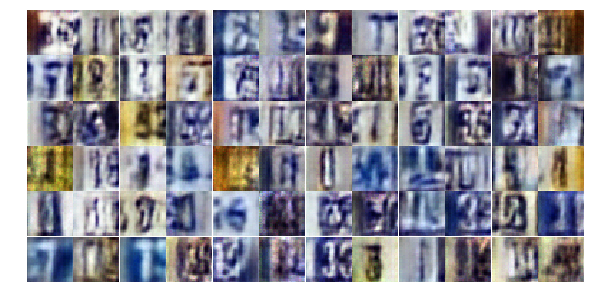

Epoch 5/25... Discriminator Loss: 0.2983... Generator Loss: 2.6242
Epoch 5/25... Discriminator Loss: 1.0138... Generator Loss: 0.6200
Epoch 5/25... Discriminator Loss: 1.5617... Generator Loss: 0.3301
Epoch 5/25... Discriminator Loss: 0.7054... Generator Loss: 1.1321
Epoch 5/25... Discriminator Loss: 1.3263... Generator Loss: 2.7357
Epoch 5/25... Discriminator Loss: 0.7994... Generator Loss: 0.9026
Epoch 5/25... Discriminator Loss: 0.7715... Generator Loss: 0.9820
Epoch 5/25... Discriminator Loss: 0.6127... Generator Loss: 1.1461
Epoch 5/25... Discriminator Loss: 0.8717... Generator Loss: 1.8183
Epoch 5/25... Discriminator Loss: 0.4653... Generator Loss: 1.6400


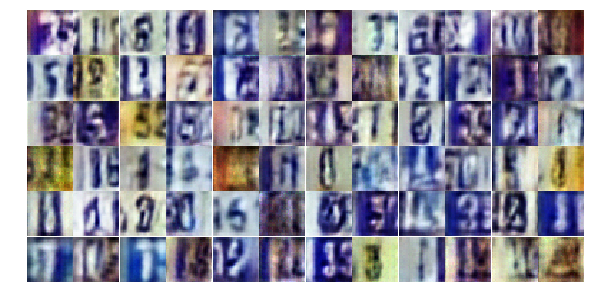

Epoch 5/25... Discriminator Loss: 0.7542... Generator Loss: 1.5399
Epoch 5/25... Discriminator Loss: 0.6180... Generator Loss: 1.1704
Epoch 5/25... Discriminator Loss: 0.8547... Generator Loss: 0.8175
Epoch 5/25... Discriminator Loss: 0.6562... Generator Loss: 0.9680
Epoch 5/25... Discriminator Loss: 1.0465... Generator Loss: 0.5908
Epoch 5/25... Discriminator Loss: 0.7027... Generator Loss: 1.4610
Epoch 6/25... Discriminator Loss: 0.6117... Generator Loss: 1.1368
Epoch 6/25... Discriminator Loss: 0.4161... Generator Loss: 1.6580
Epoch 6/25... Discriminator Loss: 0.5546... Generator Loss: 1.2069
Epoch 6/25... Discriminator Loss: 0.7064... Generator Loss: 0.9302


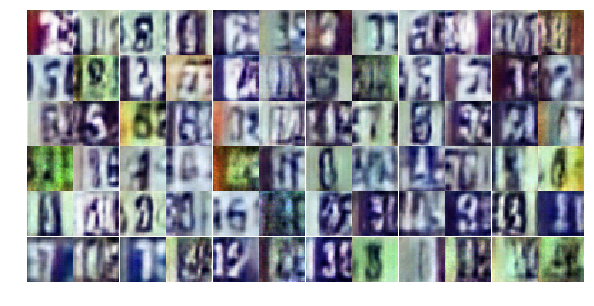

Epoch 6/25... Discriminator Loss: 1.0843... Generator Loss: 0.5653
Epoch 6/25... Discriminator Loss: 0.4569... Generator Loss: 1.6131
Epoch 6/25... Discriminator Loss: 0.5712... Generator Loss: 1.2212
Epoch 6/25... Discriminator Loss: 1.8084... Generator Loss: 4.5963
Epoch 6/25... Discriminator Loss: 1.1903... Generator Loss: 0.5046
Epoch 6/25... Discriminator Loss: 0.8007... Generator Loss: 0.8740
Epoch 6/25... Discriminator Loss: 0.5771... Generator Loss: 1.1449
Epoch 6/25... Discriminator Loss: 1.0085... Generator Loss: 0.7115
Epoch 6/25... Discriminator Loss: 0.9735... Generator Loss: 0.6078
Epoch 6/25... Discriminator Loss: 0.6498... Generator Loss: 2.0724


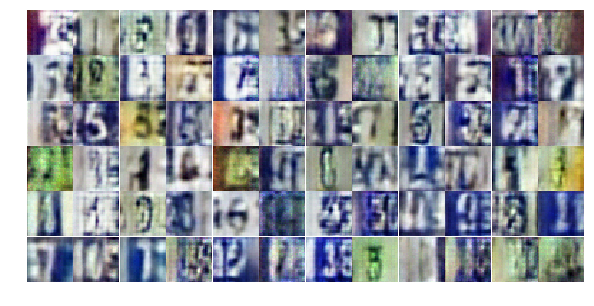

Epoch 6/25... Discriminator Loss: 0.9212... Generator Loss: 1.1704
Epoch 6/25... Discriminator Loss: 0.6868... Generator Loss: 1.2431
Epoch 6/25... Discriminator Loss: 1.4735... Generator Loss: 0.4093
Epoch 6/25... Discriminator Loss: 0.4494... Generator Loss: 1.4615
Epoch 6/25... Discriminator Loss: 0.9785... Generator Loss: 2.3146
Epoch 6/25... Discriminator Loss: 0.4675... Generator Loss: 1.5896
Epoch 6/25... Discriminator Loss: 0.6517... Generator Loss: 1.0906
Epoch 6/25... Discriminator Loss: 0.6571... Generator Loss: 1.1153
Epoch 6/25... Discriminator Loss: 0.6920... Generator Loss: 1.9965
Epoch 6/25... Discriminator Loss: 0.6307... Generator Loss: 1.7035


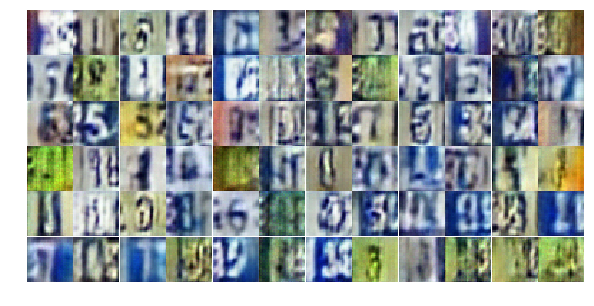

Epoch 6/25... Discriminator Loss: 0.7155... Generator Loss: 1.0078
Epoch 6/25... Discriminator Loss: 0.6791... Generator Loss: 1.0943
Epoch 6/25... Discriminator Loss: 1.1721... Generator Loss: 0.5820
Epoch 6/25... Discriminator Loss: 1.9870... Generator Loss: 0.3896
Epoch 6/25... Discriminator Loss: 1.2514... Generator Loss: 4.0742
Epoch 6/25... Discriminator Loss: 1.4268... Generator Loss: 0.4460
Epoch 6/25... Discriminator Loss: 0.8780... Generator Loss: 0.7714
Epoch 6/25... Discriminator Loss: 0.4671... Generator Loss: 1.3966
Epoch 6/25... Discriminator Loss: 0.5977... Generator Loss: 1.1985
Epoch 6/25... Discriminator Loss: 0.5997... Generator Loss: 1.3003


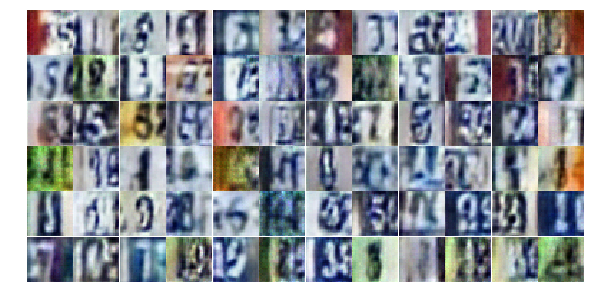

Epoch 6/25... Discriminator Loss: 0.6484... Generator Loss: 1.0979
Epoch 6/25... Discriminator Loss: 0.7947... Generator Loss: 0.9425
Epoch 6/25... Discriminator Loss: 1.1858... Generator Loss: 0.5337
Epoch 6/25... Discriminator Loss: 0.8674... Generator Loss: 0.7249
Epoch 6/25... Discriminator Loss: 0.7048... Generator Loss: 0.9892
Epoch 6/25... Discriminator Loss: 0.5424... Generator Loss: 1.4777
Epoch 6/25... Discriminator Loss: 0.5472... Generator Loss: 1.6413
Epoch 6/25... Discriminator Loss: 0.6513... Generator Loss: 1.8673
Epoch 6/25... Discriminator Loss: 0.7295... Generator Loss: 0.9523
Epoch 6/25... Discriminator Loss: 0.3567... Generator Loss: 1.9882


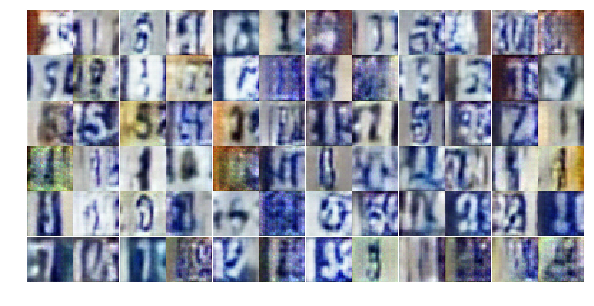

Epoch 6/25... Discriminator Loss: 1.0814... Generator Loss: 0.6735
Epoch 6/25... Discriminator Loss: 0.8169... Generator Loss: 1.8417
Epoch 6/25... Discriminator Loss: 0.7788... Generator Loss: 0.9112
Epoch 6/25... Discriminator Loss: 0.3977... Generator Loss: 2.0991
Epoch 6/25... Discriminator Loss: 0.4500... Generator Loss: 1.5714
Epoch 6/25... Discriminator Loss: 0.6235... Generator Loss: 1.3411
Epoch 6/25... Discriminator Loss: 0.9331... Generator Loss: 0.7020
Epoch 6/25... Discriminator Loss: 1.3153... Generator Loss: 0.4365
Epoch 6/25... Discriminator Loss: 0.7325... Generator Loss: 1.2267
Epoch 6/25... Discriminator Loss: 1.3514... Generator Loss: 0.4230


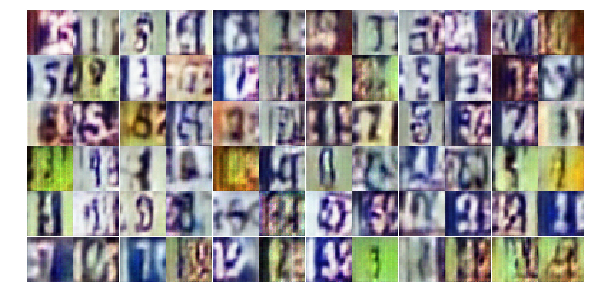

Epoch 6/25... Discriminator Loss: 0.4652... Generator Loss: 1.3916
Epoch 6/25... Discriminator Loss: 0.5603... Generator Loss: 1.2288
Epoch 6/25... Discriminator Loss: 0.6447... Generator Loss: 1.6325
Epoch 7/25... Discriminator Loss: 0.4915... Generator Loss: 1.7287
Epoch 7/25... Discriminator Loss: 0.6636... Generator Loss: 1.0157
Epoch 7/25... Discriminator Loss: 0.6595... Generator Loss: 1.2373
Epoch 7/25... Discriminator Loss: 1.0510... Generator Loss: 0.6316
Epoch 7/25... Discriminator Loss: 0.3359... Generator Loss: 1.8833
Epoch 7/25... Discriminator Loss: 0.3912... Generator Loss: 1.7301
Epoch 7/25... Discriminator Loss: 1.0396... Generator Loss: 0.6000


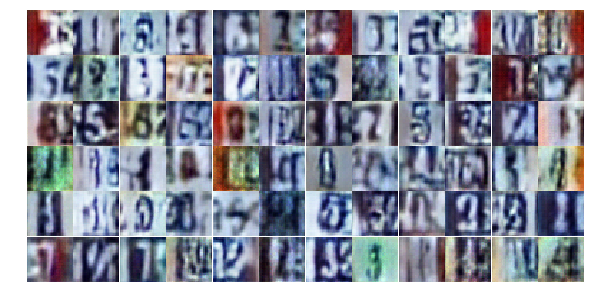

Epoch 7/25... Discriminator Loss: 0.5315... Generator Loss: 2.0801
Epoch 7/25... Discriminator Loss: 1.2328... Generator Loss: 0.4841
Epoch 7/25... Discriminator Loss: 0.6479... Generator Loss: 1.0954
Epoch 7/25... Discriminator Loss: 1.1083... Generator Loss: 2.9503
Epoch 7/25... Discriminator Loss: 0.7640... Generator Loss: 0.9196
Epoch 7/25... Discriminator Loss: 0.8013... Generator Loss: 0.9118
Epoch 7/25... Discriminator Loss: 0.8082... Generator Loss: 2.1179
Epoch 7/25... Discriminator Loss: 0.7710... Generator Loss: 1.0546
Epoch 7/25... Discriminator Loss: 1.0948... Generator Loss: 3.4684
Epoch 7/25... Discriminator Loss: 1.2664... Generator Loss: 0.5668


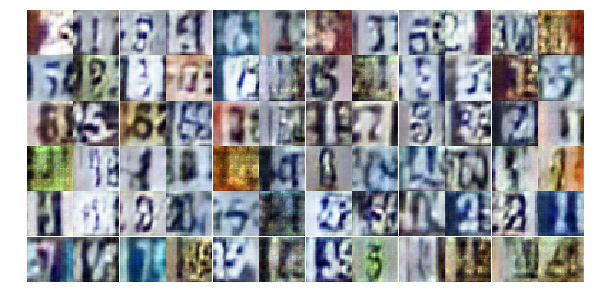

Epoch 7/25... Discriminator Loss: 0.9451... Generator Loss: 0.7588
Epoch 7/25... Discriminator Loss: 0.6716... Generator Loss: 1.6673
Epoch 7/25... Discriminator Loss: 1.0418... Generator Loss: 0.6181
Epoch 7/25... Discriminator Loss: 0.6039... Generator Loss: 1.8236
Epoch 7/25... Discriminator Loss: 0.5217... Generator Loss: 1.2796
Epoch 7/25... Discriminator Loss: 0.6596... Generator Loss: 1.1057
Epoch 7/25... Discriminator Loss: 0.5018... Generator Loss: 1.3076
Epoch 7/25... Discriminator Loss: 1.0118... Generator Loss: 0.6519
Epoch 7/25... Discriminator Loss: 0.4995... Generator Loss: 1.4323
Epoch 7/25... Discriminator Loss: 0.5670... Generator Loss: 2.3422


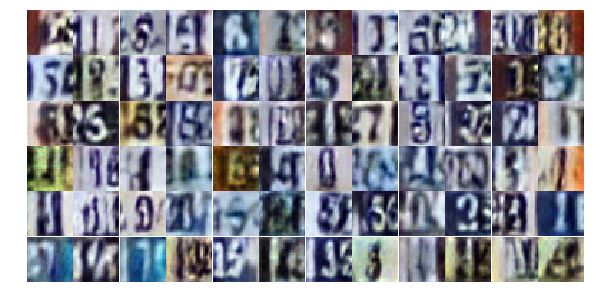

Epoch 7/25... Discriminator Loss: 0.9863... Generator Loss: 0.6320
Epoch 7/25... Discriminator Loss: 0.7943... Generator Loss: 1.0683
Epoch 7/25... Discriminator Loss: 0.5116... Generator Loss: 1.3446
Epoch 7/25... Discriminator Loss: 0.8881... Generator Loss: 0.7384
Epoch 7/25... Discriminator Loss: 0.6976... Generator Loss: 1.0214
Epoch 7/25... Discriminator Loss: 0.6394... Generator Loss: 1.1816
Epoch 7/25... Discriminator Loss: 0.6215... Generator Loss: 1.0765
Epoch 7/25... Discriminator Loss: 0.8251... Generator Loss: 0.9026
Epoch 7/25... Discriminator Loss: 1.2442... Generator Loss: 0.4296
Epoch 7/25... Discriminator Loss: 0.7113... Generator Loss: 2.9709


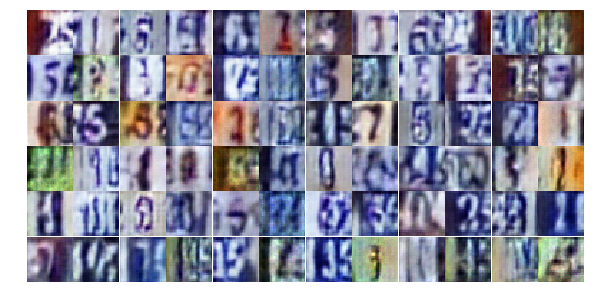

Epoch 7/25... Discriminator Loss: 0.9862... Generator Loss: 2.0389
Epoch 7/25... Discriminator Loss: 0.6778... Generator Loss: 1.3075
Epoch 7/25... Discriminator Loss: 0.4096... Generator Loss: 1.5813
Epoch 7/25... Discriminator Loss: 1.1624... Generator Loss: 0.5485
Epoch 7/25... Discriminator Loss: 0.9911... Generator Loss: 0.7726
Epoch 7/25... Discriminator Loss: 0.4360... Generator Loss: 1.5365
Epoch 7/25... Discriminator Loss: 0.6371... Generator Loss: 1.0605
Epoch 7/25... Discriminator Loss: 1.2109... Generator Loss: 1.5330
Epoch 7/25... Discriminator Loss: 0.4212... Generator Loss: 2.9521
Epoch 7/25... Discriminator Loss: 0.7234... Generator Loss: 1.0504


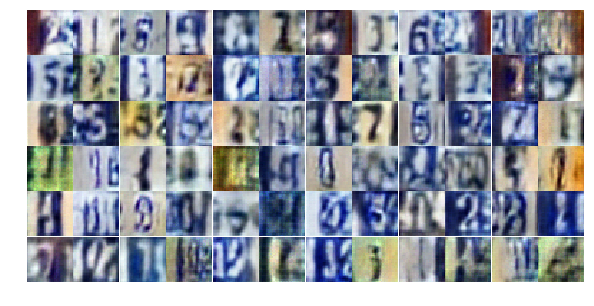

Epoch 7/25... Discriminator Loss: 0.3271... Generator Loss: 1.7414
Epoch 7/25... Discriminator Loss: 0.4696... Generator Loss: 1.4525
Epoch 7/25... Discriminator Loss: 0.9718... Generator Loss: 0.6315
Epoch 7/25... Discriminator Loss: 0.6144... Generator Loss: 1.0836
Epoch 7/25... Discriminator Loss: 0.7835... Generator Loss: 1.7002
Epoch 7/25... Discriminator Loss: 0.9137... Generator Loss: 0.8283
Epoch 7/25... Discriminator Loss: 0.9822... Generator Loss: 0.6192
Epoch 7/25... Discriminator Loss: 0.7193... Generator Loss: 1.2499
Epoch 7/25... Discriminator Loss: 0.8030... Generator Loss: 1.0366
Epoch 7/25... Discriminator Loss: 0.9763... Generator Loss: 0.6476


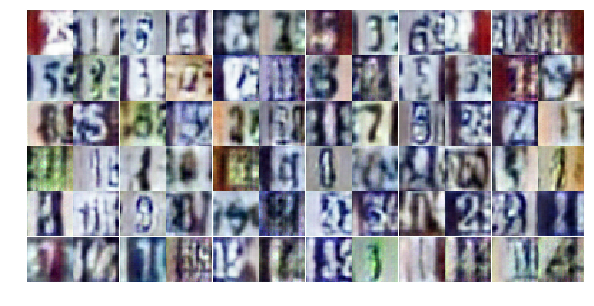

Epoch 7/25... Discriminator Loss: 0.4926... Generator Loss: 1.8589
Epoch 8/25... Discriminator Loss: 0.9469... Generator Loss: 0.6508
Epoch 8/25... Discriminator Loss: 0.8261... Generator Loss: 0.7673
Epoch 8/25... Discriminator Loss: 0.7089... Generator Loss: 1.0706
Epoch 8/25... Discriminator Loss: 0.5801... Generator Loss: 1.8422
Epoch 8/25... Discriminator Loss: 0.9823... Generator Loss: 0.6599
Epoch 8/25... Discriminator Loss: 0.6319... Generator Loss: 1.2293
Epoch 8/25... Discriminator Loss: 0.3985... Generator Loss: 1.9166
Epoch 8/25... Discriminator Loss: 0.7372... Generator Loss: 1.0063
Epoch 8/25... Discriminator Loss: 0.7282... Generator Loss: 0.9591


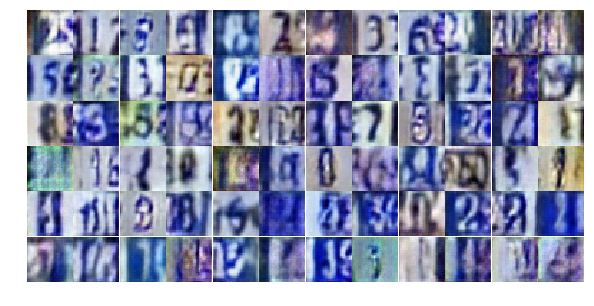

Epoch 8/25... Discriminator Loss: 0.4549... Generator Loss: 2.1515
Epoch 8/25... Discriminator Loss: 0.5647... Generator Loss: 2.9096
Epoch 8/25... Discriminator Loss: 0.7251... Generator Loss: 1.0502
Epoch 8/25... Discriminator Loss: 0.5159... Generator Loss: 1.8337
Epoch 8/25... Discriminator Loss: 0.6423... Generator Loss: 1.0120
Epoch 8/25... Discriminator Loss: 1.6647... Generator Loss: 3.1043
Epoch 8/25... Discriminator Loss: 0.4268... Generator Loss: 1.8791
Epoch 8/25... Discriminator Loss: 0.4430... Generator Loss: 1.6019
Epoch 8/25... Discriminator Loss: 0.5134... Generator Loss: 1.2941
Epoch 8/25... Discriminator Loss: 1.5316... Generator Loss: 0.3862


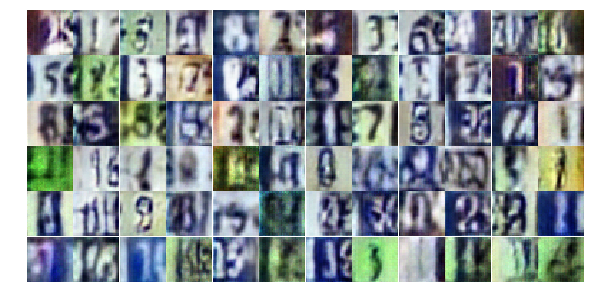

Epoch 8/25... Discriminator Loss: 0.5614... Generator Loss: 1.6080
Epoch 8/25... Discriminator Loss: 0.6037... Generator Loss: 1.1441
Epoch 8/25... Discriminator Loss: 0.7569... Generator Loss: 0.9952
Epoch 8/25... Discriminator Loss: 0.6469... Generator Loss: 1.0656
Epoch 8/25... Discriminator Loss: 0.3370... Generator Loss: 1.8345
Epoch 8/25... Discriminator Loss: 0.5546... Generator Loss: 1.2648
Epoch 8/25... Discriminator Loss: 0.6932... Generator Loss: 1.0105
Epoch 8/25... Discriminator Loss: 0.3538... Generator Loss: 1.6326
Epoch 8/25... Discriminator Loss: 0.6943... Generator Loss: 1.8291
Epoch 8/25... Discriminator Loss: 0.9258... Generator Loss: 0.6810


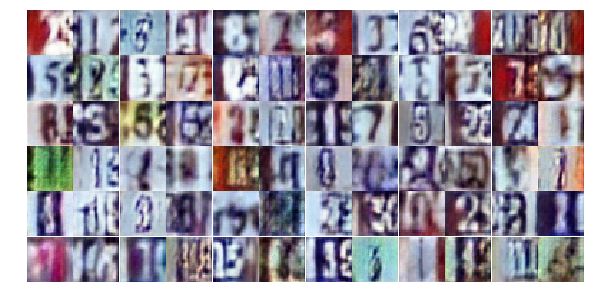

Epoch 8/25... Discriminator Loss: 0.7602... Generator Loss: 1.0601
Epoch 8/25... Discriminator Loss: 0.5861... Generator Loss: 1.1557
Epoch 8/25... Discriminator Loss: 0.9554... Generator Loss: 0.7408
Epoch 8/25... Discriminator Loss: 1.0085... Generator Loss: 0.6513
Epoch 8/25... Discriminator Loss: 0.5459... Generator Loss: 1.6783
Epoch 8/25... Discriminator Loss: 0.7041... Generator Loss: 0.9407
Epoch 8/25... Discriminator Loss: 0.3989... Generator Loss: 1.9402
Epoch 8/25... Discriminator Loss: 0.6336... Generator Loss: 1.1649
Epoch 8/25... Discriminator Loss: 0.8664... Generator Loss: 1.6916
Epoch 8/25... Discriminator Loss: 0.5634... Generator Loss: 1.3017


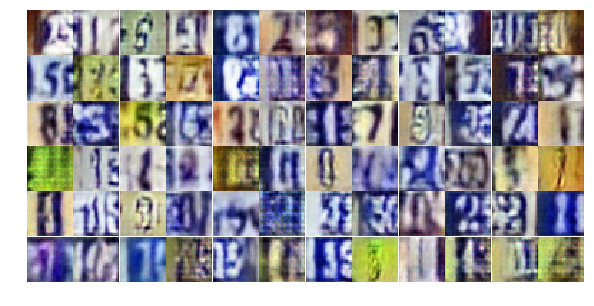

Epoch 8/25... Discriminator Loss: 0.3322... Generator Loss: 2.1287
Epoch 8/25... Discriminator Loss: 1.2251... Generator Loss: 0.4597
Epoch 8/25... Discriminator Loss: 0.7472... Generator Loss: 0.8658
Epoch 8/25... Discriminator Loss: 0.5846... Generator Loss: 1.3194
Epoch 8/25... Discriminator Loss: 2.2785... Generator Loss: 3.7644
Epoch 8/25... Discriminator Loss: 1.1837... Generator Loss: 0.4980
Epoch 8/25... Discriminator Loss: 0.5149... Generator Loss: 2.0834
Epoch 8/25... Discriminator Loss: 0.4115... Generator Loss: 1.6747
Epoch 8/25... Discriminator Loss: 0.4774... Generator Loss: 1.5456
Epoch 8/25... Discriminator Loss: 0.7124... Generator Loss: 0.9742


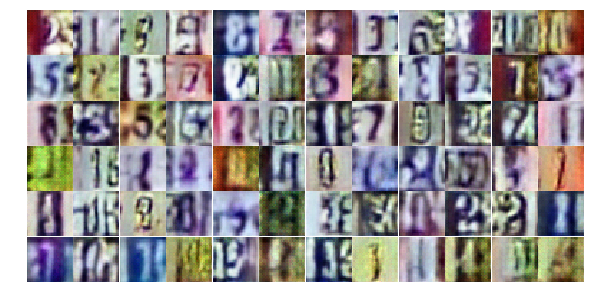

Epoch 8/25... Discriminator Loss: 0.6928... Generator Loss: 1.1912
Epoch 8/25... Discriminator Loss: 0.6524... Generator Loss: 1.1425
Epoch 8/25... Discriminator Loss: 0.6873... Generator Loss: 2.8370
Epoch 8/25... Discriminator Loss: 1.1552... Generator Loss: 0.4908
Epoch 8/25... Discriminator Loss: 0.3556... Generator Loss: 2.1483
Epoch 8/25... Discriminator Loss: 1.2763... Generator Loss: 0.4644
Epoch 8/25... Discriminator Loss: 0.5390... Generator Loss: 1.2252
Epoch 8/25... Discriminator Loss: 0.5080... Generator Loss: 3.0614
Epoch 9/25... Discriminator Loss: 1.2832... Generator Loss: 0.5300
Epoch 9/25... Discriminator Loss: 0.7084... Generator Loss: 0.9994


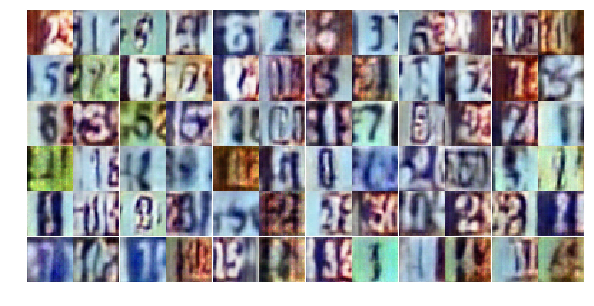

Epoch 9/25... Discriminator Loss: 0.6501... Generator Loss: 1.0346
Epoch 9/25... Discriminator Loss: 0.6281... Generator Loss: 1.1535
Epoch 9/25... Discriminator Loss: 0.7196... Generator Loss: 0.9113
Epoch 9/25... Discriminator Loss: 1.1615... Generator Loss: 0.5720
Epoch 9/25... Discriminator Loss: 1.3163... Generator Loss: 0.5428
Epoch 9/25... Discriminator Loss: 0.5666... Generator Loss: 1.6260
Epoch 9/25... Discriminator Loss: 0.6693... Generator Loss: 1.7694
Epoch 9/25... Discriminator Loss: 0.4997... Generator Loss: 1.4068
Epoch 9/25... Discriminator Loss: 0.9538... Generator Loss: 0.7521
Epoch 9/25... Discriminator Loss: 0.5813... Generator Loss: 1.6163


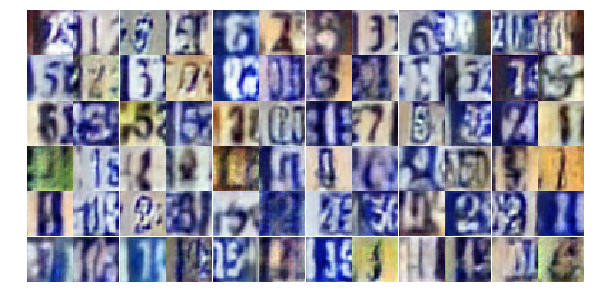

Epoch 9/25... Discriminator Loss: 0.7680... Generator Loss: 0.9062
Epoch 9/25... Discriminator Loss: 1.4826... Generator Loss: 0.3863
Epoch 9/25... Discriminator Loss: 1.3411... Generator Loss: 2.6232
Epoch 9/25... Discriminator Loss: 0.7763... Generator Loss: 0.8665
Epoch 9/25... Discriminator Loss: 0.6051... Generator Loss: 1.2555
Epoch 9/25... Discriminator Loss: 0.5901... Generator Loss: 1.2701
Epoch 9/25... Discriminator Loss: 0.9358... Generator Loss: 0.9094
Epoch 9/25... Discriminator Loss: 0.2948... Generator Loss: 2.0004
Epoch 9/25... Discriminator Loss: 1.2218... Generator Loss: 0.5038
Epoch 9/25... Discriminator Loss: 0.7810... Generator Loss: 0.8727


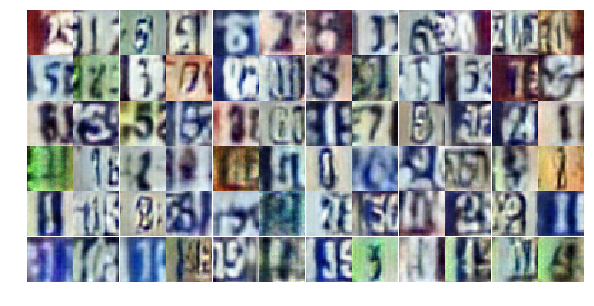

Epoch 9/25... Discriminator Loss: 0.9818... Generator Loss: 0.7976
Epoch 9/25... Discriminator Loss: 0.8077... Generator Loss: 0.8361
Epoch 9/25... Discriminator Loss: 0.7036... Generator Loss: 1.1859
Epoch 9/25... Discriminator Loss: 0.4417... Generator Loss: 1.8919
Epoch 9/25... Discriminator Loss: 0.5460... Generator Loss: 1.7516
Epoch 9/25... Discriminator Loss: 0.4701... Generator Loss: 1.5781
Epoch 9/25... Discriminator Loss: 0.9590... Generator Loss: 0.7295
Epoch 9/25... Discriminator Loss: 0.5716... Generator Loss: 1.2028
Epoch 9/25... Discriminator Loss: 0.6840... Generator Loss: 0.9680
Epoch 9/25... Discriminator Loss: 0.6033... Generator Loss: 1.0499


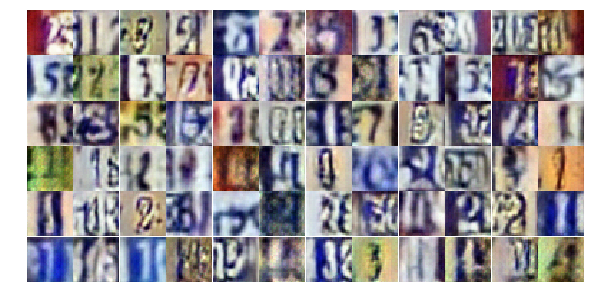

Epoch 9/25... Discriminator Loss: 0.7576... Generator Loss: 0.9171
Epoch 9/25... Discriminator Loss: 0.7769... Generator Loss: 0.8963
Epoch 9/25... Discriminator Loss: 0.6352... Generator Loss: 1.9156
Epoch 9/25... Discriminator Loss: 0.6817... Generator Loss: 2.6913
Epoch 9/25... Discriminator Loss: 0.7270... Generator Loss: 1.1139
Epoch 9/25... Discriminator Loss: 0.7223... Generator Loss: 1.0945
Epoch 9/25... Discriminator Loss: 0.5415... Generator Loss: 1.4420
Epoch 9/25... Discriminator Loss: 0.3447... Generator Loss: 1.6247
Epoch 9/25... Discriminator Loss: 1.0720... Generator Loss: 0.5884
Epoch 9/25... Discriminator Loss: 0.6842... Generator Loss: 0.9719


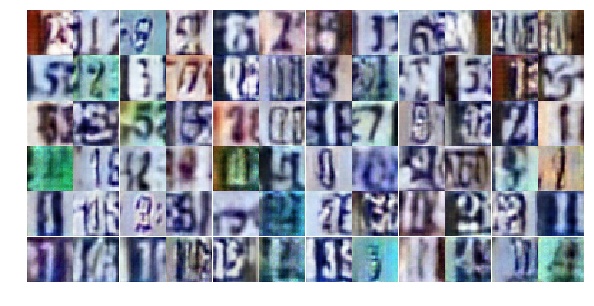

Epoch 9/25... Discriminator Loss: 0.4072... Generator Loss: 2.4188
Epoch 9/25... Discriminator Loss: 0.6321... Generator Loss: 1.3180
Epoch 9/25... Discriminator Loss: 0.5525... Generator Loss: 1.5335
Epoch 9/25... Discriminator Loss: 0.6470... Generator Loss: 1.1029
Epoch 9/25... Discriminator Loss: 0.3883... Generator Loss: 1.6285
Epoch 9/25... Discriminator Loss: 0.5943... Generator Loss: 1.1292
Epoch 9/25... Discriminator Loss: 0.6567... Generator Loss: 1.1168
Epoch 9/25... Discriminator Loss: 0.8573... Generator Loss: 0.7646
Epoch 9/25... Discriminator Loss: 0.4625... Generator Loss: 1.6157
Epoch 9/25... Discriminator Loss: 0.7957... Generator Loss: 2.7066


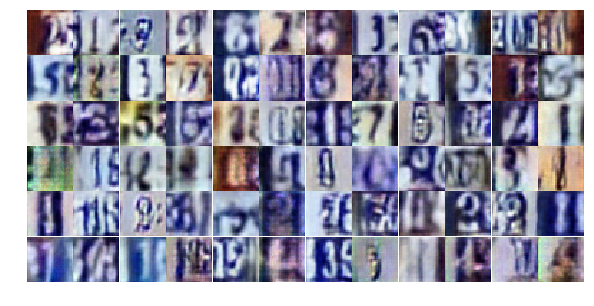

Epoch 9/25... Discriminator Loss: 1.2226... Generator Loss: 1.4777
Epoch 9/25... Discriminator Loss: 1.8212... Generator Loss: 3.6935
Epoch 9/25... Discriminator Loss: 0.7117... Generator Loss: 1.0931
Epoch 9/25... Discriminator Loss: 1.1756... Generator Loss: 0.5486
Epoch 9/25... Discriminator Loss: 0.7086... Generator Loss: 1.0299
Epoch 10/25... Discriminator Loss: 0.4947... Generator Loss: 1.4740
Epoch 10/25... Discriminator Loss: 0.6279... Generator Loss: 1.1448
Epoch 10/25... Discriminator Loss: 0.8314... Generator Loss: 0.8473
Epoch 10/25... Discriminator Loss: 0.8055... Generator Loss: 0.8876
Epoch 10/25... Discriminator Loss: 1.0151... Generator Loss: 0.6104


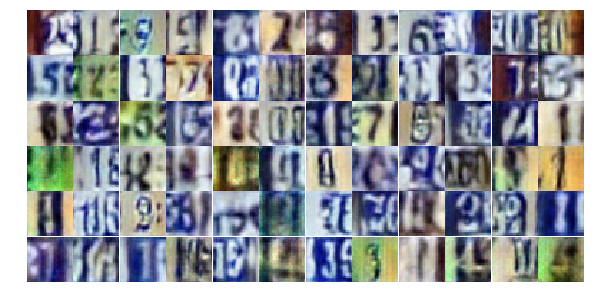

Epoch 10/25... Discriminator Loss: 1.5789... Generator Loss: 0.3360
Epoch 10/25... Discriminator Loss: 0.7108... Generator Loss: 1.8740
Epoch 10/25... Discriminator Loss: 0.6195... Generator Loss: 1.3385
Epoch 10/25... Discriminator Loss: 0.7046... Generator Loss: 1.5336
Epoch 10/25... Discriminator Loss: 0.5919... Generator Loss: 1.4601
Epoch 10/25... Discriminator Loss: 0.5850... Generator Loss: 1.1494
Epoch 10/25... Discriminator Loss: 0.8214... Generator Loss: 0.8860
Epoch 10/25... Discriminator Loss: 1.0748... Generator Loss: 0.6308
Epoch 10/25... Discriminator Loss: 0.7901... Generator Loss: 0.8842
Epoch 10/25... Discriminator Loss: 0.7711... Generator Loss: 2.3320


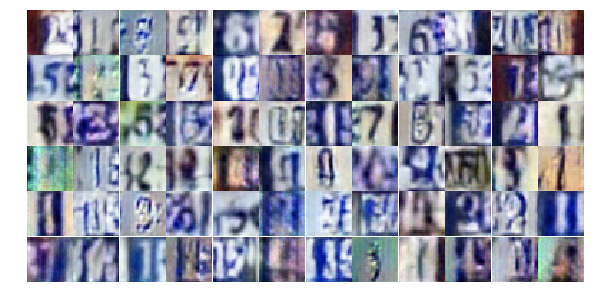

Epoch 10/25... Discriminator Loss: 0.4764... Generator Loss: 1.6467
Epoch 10/25... Discriminator Loss: 0.9562... Generator Loss: 0.7053
Epoch 10/25... Discriminator Loss: 0.9348... Generator Loss: 0.7020
Epoch 10/25... Discriminator Loss: 1.4440... Generator Loss: 0.3997
Epoch 10/25... Discriminator Loss: 0.5713... Generator Loss: 1.6030
Epoch 10/25... Discriminator Loss: 0.7963... Generator Loss: 0.8652
Epoch 10/25... Discriminator Loss: 1.0228... Generator Loss: 0.7221
Epoch 10/25... Discriminator Loss: 0.5745... Generator Loss: 1.3052
Epoch 10/25... Discriminator Loss: 0.8669... Generator Loss: 0.8051
Epoch 10/25... Discriminator Loss: 0.7539... Generator Loss: 3.4532


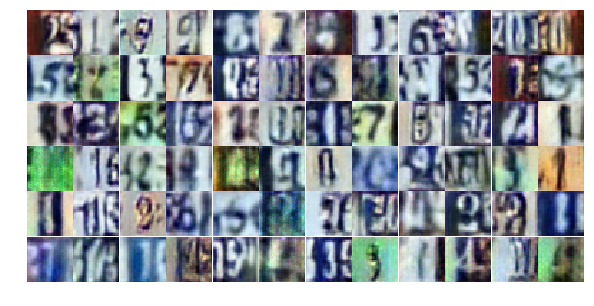

Epoch 10/25... Discriminator Loss: 1.4079... Generator Loss: 0.3812
Epoch 10/25... Discriminator Loss: 0.7788... Generator Loss: 1.2274
Epoch 10/25... Discriminator Loss: 0.4392... Generator Loss: 1.3836
Epoch 10/25... Discriminator Loss: 0.4165... Generator Loss: 2.3042
Epoch 10/25... Discriminator Loss: 1.0422... Generator Loss: 0.5864
Epoch 10/25... Discriminator Loss: 0.6501... Generator Loss: 1.1196
Epoch 10/25... Discriminator Loss: 0.2849... Generator Loss: 1.8793
Epoch 10/25... Discriminator Loss: 0.9744... Generator Loss: 0.6445
Epoch 10/25... Discriminator Loss: 0.7407... Generator Loss: 0.9267
Epoch 10/25... Discriminator Loss: 0.8056... Generator Loss: 0.8085


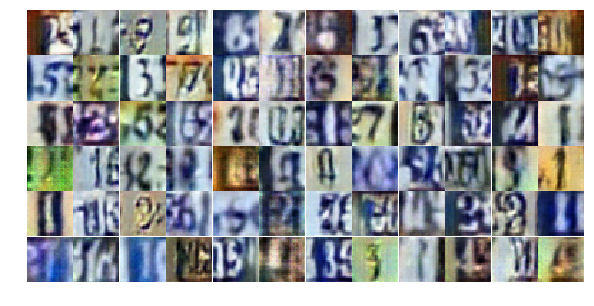

Epoch 10/25... Discriminator Loss: 0.6093... Generator Loss: 1.2652
Epoch 10/25... Discriminator Loss: 0.9464... Generator Loss: 0.6811
Epoch 10/25... Discriminator Loss: 0.5504... Generator Loss: 1.6960
Epoch 10/25... Discriminator Loss: 0.7251... Generator Loss: 2.1256
Epoch 10/25... Discriminator Loss: 0.9975... Generator Loss: 0.7579
Epoch 10/25... Discriminator Loss: 0.7332... Generator Loss: 0.9426
Epoch 10/25... Discriminator Loss: 0.7681... Generator Loss: 0.9818
Epoch 10/25... Discriminator Loss: 1.4657... Generator Loss: 0.3860
Epoch 10/25... Discriminator Loss: 0.9457... Generator Loss: 0.6870
Epoch 10/25... Discriminator Loss: 0.5112... Generator Loss: 1.5929


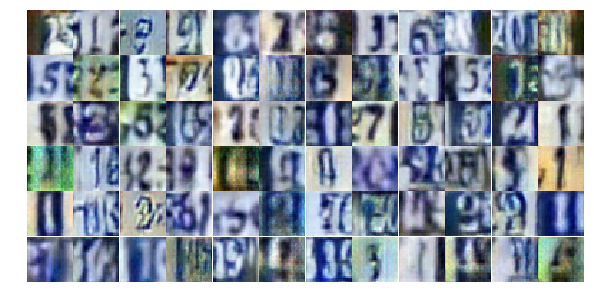

Epoch 10/25... Discriminator Loss: 0.6945... Generator Loss: 1.0594
Epoch 10/25... Discriminator Loss: 0.6939... Generator Loss: 1.4479
Epoch 10/25... Discriminator Loss: 0.6099... Generator Loss: 1.1149
Epoch 10/25... Discriminator Loss: 0.7995... Generator Loss: 0.9109
Epoch 10/25... Discriminator Loss: 0.4657... Generator Loss: 2.2597
Epoch 10/25... Discriminator Loss: 0.6853... Generator Loss: 1.9179
Epoch 10/25... Discriminator Loss: 0.7908... Generator Loss: 0.8410
Epoch 10/25... Discriminator Loss: 0.4432... Generator Loss: 1.5013
Epoch 10/25... Discriminator Loss: 0.5975... Generator Loss: 1.5267
Epoch 10/25... Discriminator Loss: 0.5043... Generator Loss: 2.4193


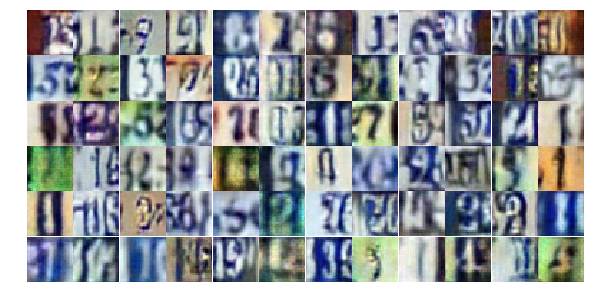

Epoch 10/25... Discriminator Loss: 1.2216... Generator Loss: 0.5512
Epoch 10/25... Discriminator Loss: 0.6996... Generator Loss: 0.9902
Epoch 10/25... Discriminator Loss: 0.5076... Generator Loss: 1.4042
Epoch 11/25... Discriminator Loss: 1.0316... Generator Loss: 0.6496
Epoch 11/25... Discriminator Loss: 0.6194... Generator Loss: 1.1690
Epoch 11/25... Discriminator Loss: 1.2738... Generator Loss: 0.4323
Epoch 11/25... Discriminator Loss: 0.7209... Generator Loss: 0.9677
Epoch 11/25... Discriminator Loss: 1.0208... Generator Loss: 2.5637
Epoch 11/25... Discriminator Loss: 1.4785... Generator Loss: 0.4040
Epoch 11/25... Discriminator Loss: 0.4633... Generator Loss: 1.7957


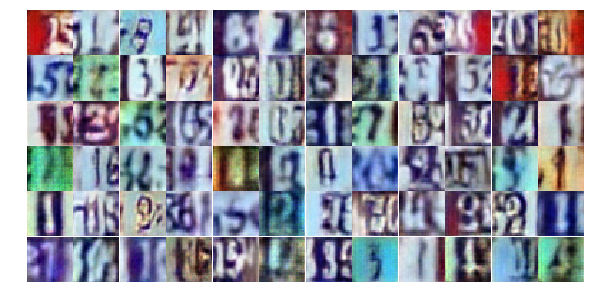

Epoch 11/25... Discriminator Loss: 0.4758... Generator Loss: 1.5789
Epoch 11/25... Discriminator Loss: 0.6945... Generator Loss: 1.0862
Epoch 11/25... Discriminator Loss: 0.4238... Generator Loss: 1.6611
Epoch 11/25... Discriminator Loss: 0.7967... Generator Loss: 0.8718
Epoch 11/25... Discriminator Loss: 0.8654... Generator Loss: 0.7460
Epoch 11/25... Discriminator Loss: 0.4517... Generator Loss: 1.4777
Epoch 11/25... Discriminator Loss: 0.6853... Generator Loss: 1.1601
Epoch 11/25... Discriminator Loss: 0.3286... Generator Loss: 2.0816
Epoch 11/25... Discriminator Loss: 0.4965... Generator Loss: 1.6689
Epoch 11/25... Discriminator Loss: 1.5275... Generator Loss: 0.3417


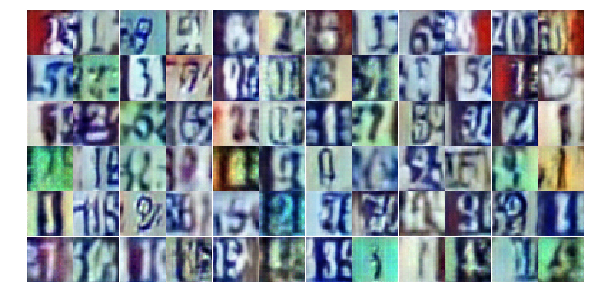

Epoch 11/25... Discriminator Loss: 0.8887... Generator Loss: 0.7496
Epoch 11/25... Discriminator Loss: 0.4712... Generator Loss: 1.3536
Epoch 11/25... Discriminator Loss: 1.2442... Generator Loss: 0.5227
Epoch 11/25... Discriminator Loss: 0.6761... Generator Loss: 0.9906
Epoch 11/25... Discriminator Loss: 0.4179... Generator Loss: 2.1308
Epoch 11/25... Discriminator Loss: 0.4243... Generator Loss: 1.6050
Epoch 11/25... Discriminator Loss: 0.6201... Generator Loss: 1.1383
Epoch 11/25... Discriminator Loss: 0.6791... Generator Loss: 1.2910
Epoch 11/25... Discriminator Loss: 0.3453... Generator Loss: 1.7540
Epoch 11/25... Discriminator Loss: 1.0732... Generator Loss: 0.5597


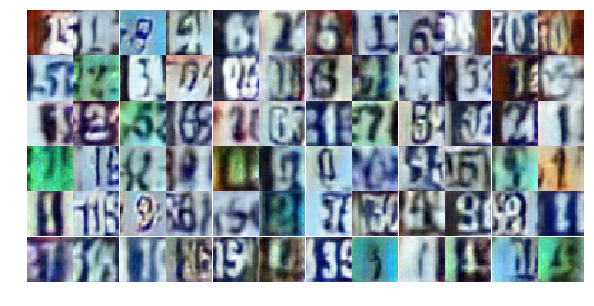

Epoch 11/25... Discriminator Loss: 0.6370... Generator Loss: 1.2909
Epoch 11/25... Discriminator Loss: 0.6608... Generator Loss: 1.2189
Epoch 11/25... Discriminator Loss: 0.7271... Generator Loss: 1.1380
Epoch 11/25... Discriminator Loss: 0.4889... Generator Loss: 1.3744
Epoch 11/25... Discriminator Loss: 0.7039... Generator Loss: 1.0952
Epoch 11/25... Discriminator Loss: 1.1969... Generator Loss: 0.4824
Epoch 11/25... Discriminator Loss: 1.1665... Generator Loss: 0.5269
Epoch 11/25... Discriminator Loss: 0.8730... Generator Loss: 0.7272
Epoch 11/25... Discriminator Loss: 0.5347... Generator Loss: 1.3553
Epoch 11/25... Discriminator Loss: 0.8529... Generator Loss: 0.8417


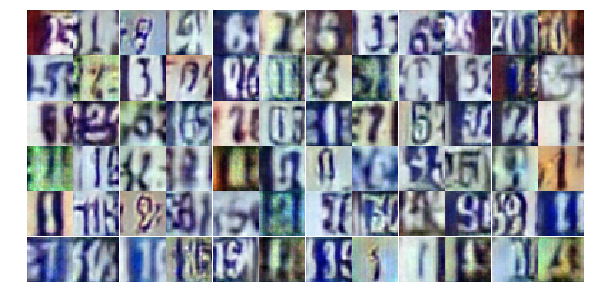

Epoch 11/25... Discriminator Loss: 0.5116... Generator Loss: 1.3252
Epoch 11/25... Discriminator Loss: 0.5267... Generator Loss: 1.3169
Epoch 11/25... Discriminator Loss: 0.8187... Generator Loss: 0.8502
Epoch 11/25... Discriminator Loss: 0.7480... Generator Loss: 1.0993
Epoch 11/25... Discriminator Loss: 1.2532... Generator Loss: 0.4776
Epoch 11/25... Discriminator Loss: 0.5651... Generator Loss: 1.2211
Epoch 11/25... Discriminator Loss: 0.7328... Generator Loss: 0.8945
Epoch 11/25... Discriminator Loss: 0.6290... Generator Loss: 1.8386
Epoch 11/25... Discriminator Loss: 1.0120... Generator Loss: 0.6634
Epoch 11/25... Discriminator Loss: 0.4961... Generator Loss: 1.3906


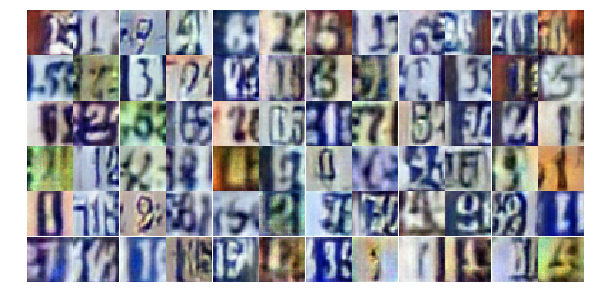

Epoch 11/25... Discriminator Loss: 0.6781... Generator Loss: 1.0827
Epoch 11/25... Discriminator Loss: 0.4060... Generator Loss: 2.0350
Epoch 11/25... Discriminator Loss: 0.6404... Generator Loss: 2.3163
Epoch 11/25... Discriminator Loss: 0.7154... Generator Loss: 0.8936
Epoch 11/25... Discriminator Loss: 1.4156... Generator Loss: 0.4653
Epoch 11/25... Discriminator Loss: 0.5546... Generator Loss: 1.9482
Epoch 11/25... Discriminator Loss: 1.2858... Generator Loss: 0.4697
Epoch 11/25... Discriminator Loss: 0.5826... Generator Loss: 1.4346
Epoch 11/25... Discriminator Loss: 0.9848... Generator Loss: 0.7191
Epoch 11/25... Discriminator Loss: 0.8603... Generator Loss: 0.8578


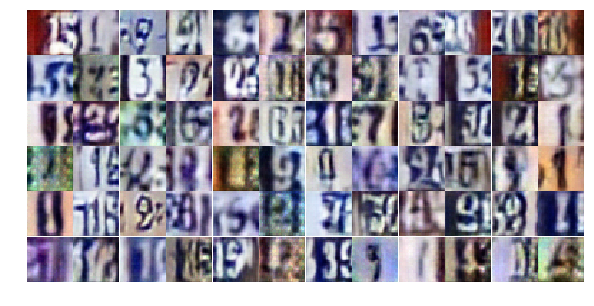

Epoch 12/25... Discriminator Loss: 1.0473... Generator Loss: 2.3662
Epoch 12/25... Discriminator Loss: 0.6685... Generator Loss: 1.4067
Epoch 12/25... Discriminator Loss: 0.8521... Generator Loss: 0.9611
Epoch 12/25... Discriminator Loss: 0.5390... Generator Loss: 1.4594
Epoch 12/25... Discriminator Loss: 0.5116... Generator Loss: 1.4008
Epoch 12/25... Discriminator Loss: 1.3834... Generator Loss: 0.4668
Epoch 12/25... Discriminator Loss: 0.6618... Generator Loss: 2.3145
Epoch 12/25... Discriminator Loss: 0.6540... Generator Loss: 1.6243
Epoch 12/25... Discriminator Loss: 0.6722... Generator Loss: 1.2709
Epoch 12/25... Discriminator Loss: 1.2568... Generator Loss: 0.4839


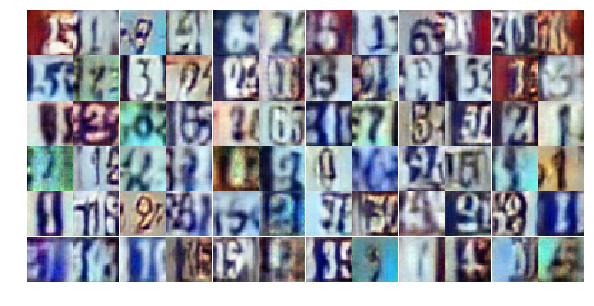

Epoch 12/25... Discriminator Loss: 0.4497... Generator Loss: 1.4166
Epoch 12/25... Discriminator Loss: 0.9103... Generator Loss: 0.7965
Epoch 12/25... Discriminator Loss: 0.5483... Generator Loss: 1.2029
Epoch 12/25... Discriminator Loss: 0.8941... Generator Loss: 0.9725
Epoch 12/25... Discriminator Loss: 0.4512... Generator Loss: 1.8647
Epoch 12/25... Discriminator Loss: 0.9604... Generator Loss: 0.8959
Epoch 12/25... Discriminator Loss: 1.4424... Generator Loss: 0.3812
Epoch 12/25... Discriminator Loss: 0.4261... Generator Loss: 1.7369
Epoch 12/25... Discriminator Loss: 0.5590... Generator Loss: 1.1022
Epoch 12/25... Discriminator Loss: 1.0375... Generator Loss: 0.6553


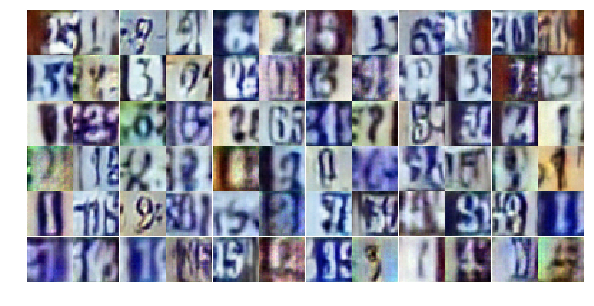

Epoch 12/25... Discriminator Loss: 0.3417... Generator Loss: 2.3579
Epoch 12/25... Discriminator Loss: 0.3851... Generator Loss: 1.4692
Epoch 12/25... Discriminator Loss: 0.5390... Generator Loss: 1.3405
Epoch 12/25... Discriminator Loss: 0.3291... Generator Loss: 2.2867
Epoch 12/25... Discriminator Loss: 0.4686... Generator Loss: 1.5915
Epoch 12/25... Discriminator Loss: 1.1181... Generator Loss: 0.5966
Epoch 12/25... Discriminator Loss: 0.5283... Generator Loss: 1.4208
Epoch 12/25... Discriminator Loss: 0.4454... Generator Loss: 1.6930
Epoch 12/25... Discriminator Loss: 0.6879... Generator Loss: 0.9798
Epoch 12/25... Discriminator Loss: 0.6321... Generator Loss: 1.1172


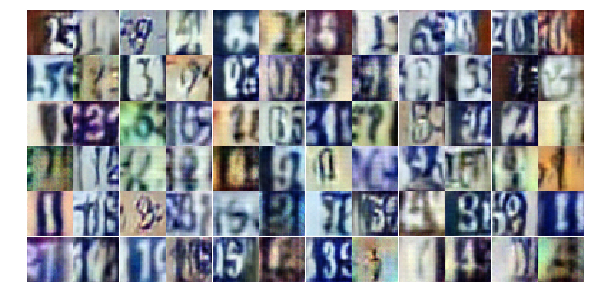

Epoch 12/25... Discriminator Loss: 0.6368... Generator Loss: 1.1149
Epoch 12/25... Discriminator Loss: 0.7330... Generator Loss: 1.0502
Epoch 12/25... Discriminator Loss: 0.8998... Generator Loss: 0.7584
Epoch 12/25... Discriminator Loss: 1.6260... Generator Loss: 0.3003
Epoch 12/25... Discriminator Loss: 0.8105... Generator Loss: 2.5101
Epoch 12/25... Discriminator Loss: 1.1578... Generator Loss: 0.5298
Epoch 12/25... Discriminator Loss: 1.4247... Generator Loss: 0.3473
Epoch 12/25... Discriminator Loss: 0.6526... Generator Loss: 1.2529
Epoch 12/25... Discriminator Loss: 0.6369... Generator Loss: 1.1598
Epoch 12/25... Discriminator Loss: 0.3883... Generator Loss: 1.5335


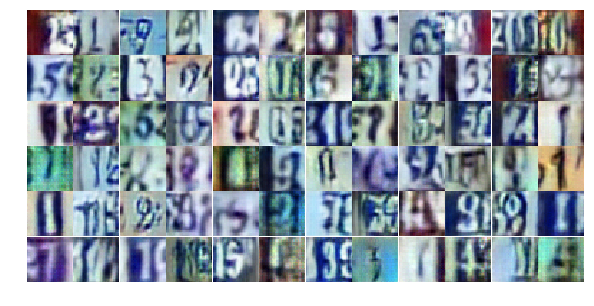

Epoch 12/25... Discriminator Loss: 0.5315... Generator Loss: 1.2493
Epoch 12/25... Discriminator Loss: 0.5143... Generator Loss: 1.3158
Epoch 12/25... Discriminator Loss: 0.4404... Generator Loss: 1.6376
Epoch 12/25... Discriminator Loss: 1.4268... Generator Loss: 0.5360
Epoch 12/25... Discriminator Loss: 0.7172... Generator Loss: 0.9559
Epoch 12/25... Discriminator Loss: 1.3938... Generator Loss: 0.3969
Epoch 12/25... Discriminator Loss: 0.9834... Generator Loss: 0.8289
Epoch 12/25... Discriminator Loss: 0.9788... Generator Loss: 0.6467
Epoch 12/25... Discriminator Loss: 0.5433... Generator Loss: 1.5837
Epoch 12/25... Discriminator Loss: 0.5648... Generator Loss: 1.2686


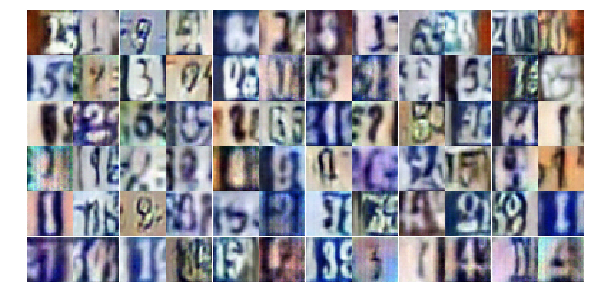

Epoch 12/25... Discriminator Loss: 0.9577... Generator Loss: 0.8440
Epoch 12/25... Discriminator Loss: 0.6732... Generator Loss: 0.9975
Epoch 12/25... Discriminator Loss: 0.5246... Generator Loss: 1.2384
Epoch 12/25... Discriminator Loss: 1.5234... Generator Loss: 0.4074
Epoch 12/25... Discriminator Loss: 0.7283... Generator Loss: 1.0120
Epoch 12/25... Discriminator Loss: 0.6907... Generator Loss: 2.3826
Epoch 12/25... Discriminator Loss: 1.1319... Generator Loss: 0.6184
Epoch 13/25... Discriminator Loss: 0.5645... Generator Loss: 1.2141
Epoch 13/25... Discriminator Loss: 0.4489... Generator Loss: 1.5751
Epoch 13/25... Discriminator Loss: 0.6999... Generator Loss: 1.2671


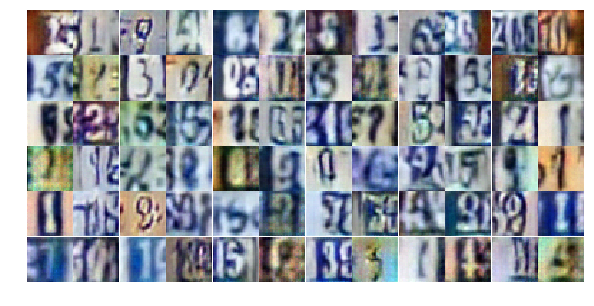

Epoch 13/25... Discriminator Loss: 0.4258... Generator Loss: 1.6731
Epoch 13/25... Discriminator Loss: 0.6522... Generator Loss: 2.1312
Epoch 13/25... Discriminator Loss: 1.4734... Generator Loss: 0.3395
Epoch 13/25... Discriminator Loss: 0.7423... Generator Loss: 1.0405
Epoch 13/25... Discriminator Loss: 0.7238... Generator Loss: 0.9590
Epoch 13/25... Discriminator Loss: 0.5248... Generator Loss: 1.2459
Epoch 13/25... Discriminator Loss: 0.3765... Generator Loss: 1.9553
Epoch 13/25... Discriminator Loss: 0.4998... Generator Loss: 1.4311
Epoch 13/25... Discriminator Loss: 0.3923... Generator Loss: 1.4889
Epoch 13/25... Discriminator Loss: 0.6213... Generator Loss: 1.2311


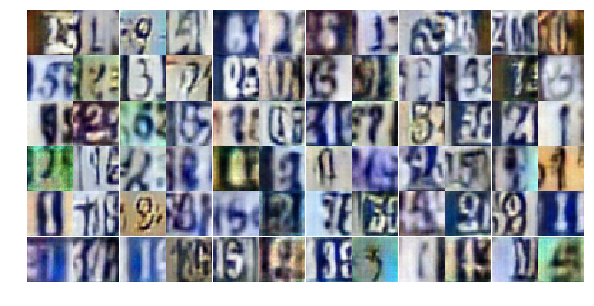

Epoch 13/25... Discriminator Loss: 0.5787... Generator Loss: 1.2526
Epoch 13/25... Discriminator Loss: 0.6870... Generator Loss: 1.0224
Epoch 13/25... Discriminator Loss: 1.3890... Generator Loss: 0.4697
Epoch 13/25... Discriminator Loss: 0.9055... Generator Loss: 0.7183
Epoch 13/25... Discriminator Loss: 0.5112... Generator Loss: 1.3579
Epoch 13/25... Discriminator Loss: 0.8835... Generator Loss: 0.7533
Epoch 13/25... Discriminator Loss: 0.6559... Generator Loss: 1.2289
Epoch 13/25... Discriminator Loss: 1.0423... Generator Loss: 0.6663
Epoch 13/25... Discriminator Loss: 0.5207... Generator Loss: 1.3318
Epoch 13/25... Discriminator Loss: 1.4668... Generator Loss: 0.3908


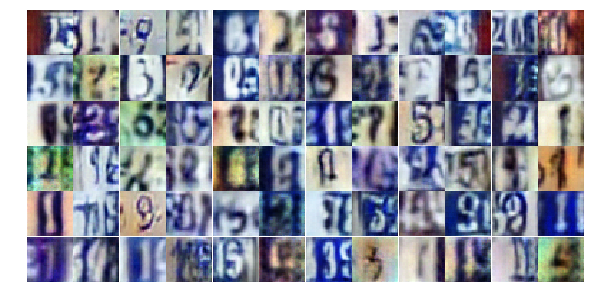

Epoch 13/25... Discriminator Loss: 0.5810... Generator Loss: 1.2427
Epoch 13/25... Discriminator Loss: 0.6533... Generator Loss: 1.0209
Epoch 13/25... Discriminator Loss: 0.5445... Generator Loss: 1.7461
Epoch 13/25... Discriminator Loss: 0.7292... Generator Loss: 0.9697
Epoch 13/25... Discriminator Loss: 0.6173... Generator Loss: 1.3039
Epoch 13/25... Discriminator Loss: 0.9264... Generator Loss: 0.6865
Epoch 13/25... Discriminator Loss: 0.5776... Generator Loss: 2.1179
Epoch 13/25... Discriminator Loss: 0.5119... Generator Loss: 1.4162
Epoch 13/25... Discriminator Loss: 0.5974... Generator Loss: 1.1012
Epoch 13/25... Discriminator Loss: 0.5960... Generator Loss: 1.3668


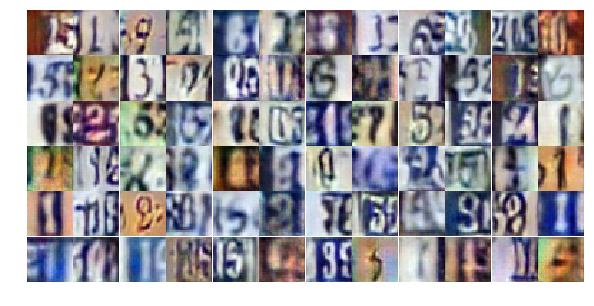

Epoch 13/25... Discriminator Loss: 0.9898... Generator Loss: 0.6276
Epoch 13/25... Discriminator Loss: 0.7479... Generator Loss: 0.9008
Epoch 13/25... Discriminator Loss: 0.7314... Generator Loss: 0.8984
Epoch 13/25... Discriminator Loss: 1.2131... Generator Loss: 0.4842
Epoch 13/25... Discriminator Loss: 0.5628... Generator Loss: 1.2416
Epoch 13/25... Discriminator Loss: 0.4544... Generator Loss: 1.7517
Epoch 13/25... Discriminator Loss: 0.5742... Generator Loss: 1.1281
Epoch 13/25... Discriminator Loss: 0.5561... Generator Loss: 2.0704
Epoch 13/25... Discriminator Loss: 0.8697... Generator Loss: 1.3212
Epoch 13/25... Discriminator Loss: 0.7493... Generator Loss: 0.9203


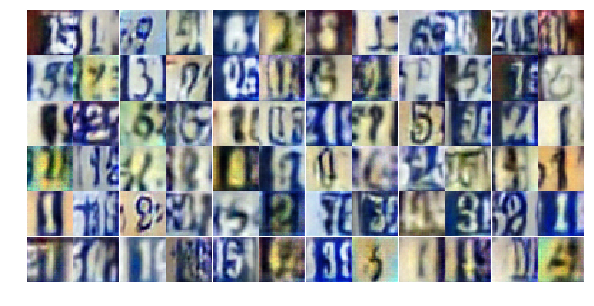

Epoch 13/25... Discriminator Loss: 0.5951... Generator Loss: 1.0773
Epoch 13/25... Discriminator Loss: 0.8631... Generator Loss: 2.5892
Epoch 13/25... Discriminator Loss: 0.6897... Generator Loss: 1.0934
Epoch 13/25... Discriminator Loss: 0.4058... Generator Loss: 1.9413
Epoch 13/25... Discriminator Loss: 1.0443... Generator Loss: 0.6257
Epoch 13/25... Discriminator Loss: 0.6045... Generator Loss: 1.5539
Epoch 13/25... Discriminator Loss: 0.9904... Generator Loss: 0.6843
Epoch 13/25... Discriminator Loss: 0.7824... Generator Loss: 0.8730
Epoch 13/25... Discriminator Loss: 1.0937... Generator Loss: 0.5621
Epoch 13/25... Discriminator Loss: 0.8349... Generator Loss: 0.8218


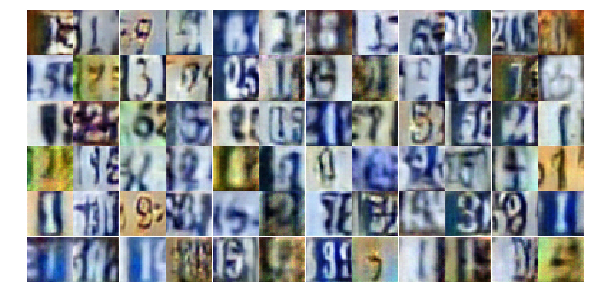

Epoch 13/25... Discriminator Loss: 0.2918... Generator Loss: 2.5903
Epoch 13/25... Discriminator Loss: 1.3082... Generator Loss: 0.4751
Epoch 13/25... Discriminator Loss: 0.5793... Generator Loss: 1.9867
Epoch 13/25... Discriminator Loss: 1.1126... Generator Loss: 0.5651
Epoch 14/25... Discriminator Loss: 0.8977... Generator Loss: 0.7682
Epoch 14/25... Discriminator Loss: 0.6320... Generator Loss: 1.0808
Epoch 14/25... Discriminator Loss: 0.9304... Generator Loss: 0.7633
Epoch 14/25... Discriminator Loss: 0.6369... Generator Loss: 2.6977
Epoch 14/25... Discriminator Loss: 0.5268... Generator Loss: 1.4750
Epoch 14/25... Discriminator Loss: 0.6041... Generator Loss: 1.1873


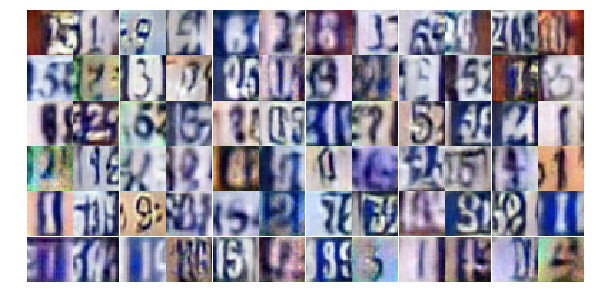

Epoch 14/25... Discriminator Loss: 0.6057... Generator Loss: 1.8279
Epoch 14/25... Discriminator Loss: 0.5745... Generator Loss: 1.1311
Epoch 14/25... Discriminator Loss: 0.6247... Generator Loss: 1.0889
Epoch 14/25... Discriminator Loss: 0.6930... Generator Loss: 1.1277
Epoch 14/25... Discriminator Loss: 1.5408... Generator Loss: 0.3111
Epoch 14/25... Discriminator Loss: 0.2803... Generator Loss: 1.9982
Epoch 14/25... Discriminator Loss: 0.4987... Generator Loss: 2.3004
Epoch 14/25... Discriminator Loss: 2.0744... Generator Loss: 0.2273
Epoch 14/25... Discriminator Loss: 2.0288... Generator Loss: 0.2012
Epoch 14/25... Discriminator Loss: 1.0802... Generator Loss: 0.6229


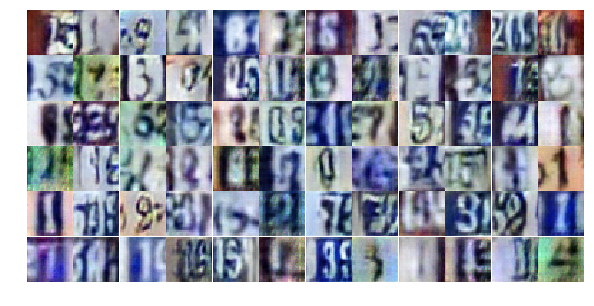

Epoch 14/25... Discriminator Loss: 0.5761... Generator Loss: 1.0847
Epoch 14/25... Discriminator Loss: 0.5998... Generator Loss: 3.0695
Epoch 14/25... Discriminator Loss: 0.9063... Generator Loss: 0.7821
Epoch 14/25... Discriminator Loss: 0.4967... Generator Loss: 1.8577
Epoch 14/25... Discriminator Loss: 0.8357... Generator Loss: 0.9731
Epoch 14/25... Discriminator Loss: 0.7012... Generator Loss: 1.0688
Epoch 14/25... Discriminator Loss: 0.6637... Generator Loss: 1.0487
Epoch 14/25... Discriminator Loss: 0.5990... Generator Loss: 1.0889
Epoch 14/25... Discriminator Loss: 0.5290... Generator Loss: 1.5428
Epoch 14/25... Discriminator Loss: 0.5277... Generator Loss: 1.2308


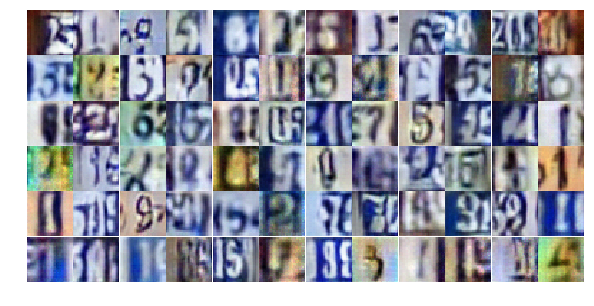

Epoch 14/25... Discriminator Loss: 1.1479... Generator Loss: 0.5959
Epoch 14/25... Discriminator Loss: 0.4322... Generator Loss: 1.4033
Epoch 14/25... Discriminator Loss: 0.4555... Generator Loss: 1.4025
Epoch 14/25... Discriminator Loss: 0.4873... Generator Loss: 1.4404
Epoch 14/25... Discriminator Loss: 0.7129... Generator Loss: 1.1958
Epoch 14/25... Discriminator Loss: 0.8713... Generator Loss: 0.8041
Epoch 14/25... Discriminator Loss: 0.7952... Generator Loss: 0.8227
Epoch 14/25... Discriminator Loss: 0.5035... Generator Loss: 1.2251
Epoch 14/25... Discriminator Loss: 0.3884... Generator Loss: 2.4842
Epoch 14/25... Discriminator Loss: 0.7445... Generator Loss: 1.4054


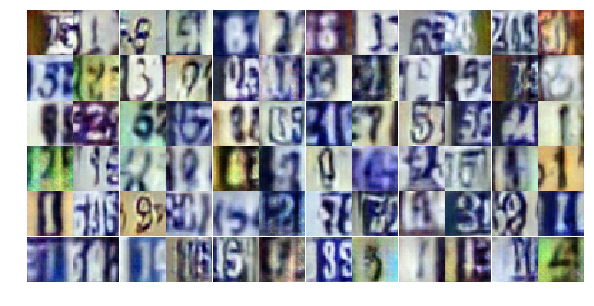

Epoch 14/25... Discriminator Loss: 1.1784... Generator Loss: 0.5366
Epoch 14/25... Discriminator Loss: 0.7518... Generator Loss: 0.9743
Epoch 14/25... Discriminator Loss: 0.9086... Generator Loss: 0.7316
Epoch 14/25... Discriminator Loss: 1.1124... Generator Loss: 0.5820
Epoch 14/25... Discriminator Loss: 0.6293... Generator Loss: 1.6642
Epoch 14/25... Discriminator Loss: 0.7457... Generator Loss: 0.9614
Epoch 14/25... Discriminator Loss: 0.5265... Generator Loss: 1.3266
Epoch 14/25... Discriminator Loss: 0.6097... Generator Loss: 1.0622
Epoch 14/25... Discriminator Loss: 1.6480... Generator Loss: 0.3268
Epoch 14/25... Discriminator Loss: 1.8161... Generator Loss: 0.2945


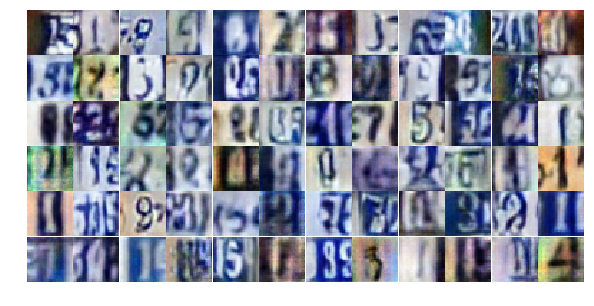

Epoch 14/25... Discriminator Loss: 0.7871... Generator Loss: 0.9929
Epoch 14/25... Discriminator Loss: 1.5599... Generator Loss: 0.3227
Epoch 14/25... Discriminator Loss: 0.5829... Generator Loss: 1.4739
Epoch 14/25... Discriminator Loss: 0.6633... Generator Loss: 1.0457
Epoch 14/25... Discriminator Loss: 0.4477... Generator Loss: 1.5712
Epoch 14/25... Discriminator Loss: 0.7581... Generator Loss: 1.0409
Epoch 14/25... Discriminator Loss: 0.5132... Generator Loss: 1.5227
Epoch 14/25... Discriminator Loss: 0.6371... Generator Loss: 1.1529
Epoch 14/25... Discriminator Loss: 1.1970... Generator Loss: 1.9579
Epoch 14/25... Discriminator Loss: 1.5003... Generator Loss: 0.3936


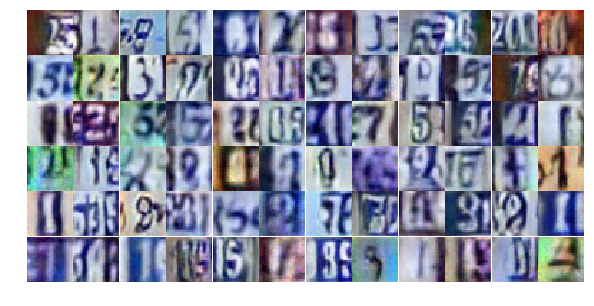

Epoch 14/25... Discriminator Loss: 0.5430... Generator Loss: 1.7633
Epoch 14/25... Discriminator Loss: 0.9757... Generator Loss: 0.6814
Epoch 15/25... Discriminator Loss: 0.8037... Generator Loss: 0.8522
Epoch 15/25... Discriminator Loss: 0.5274... Generator Loss: 1.6662
Epoch 15/25... Discriminator Loss: 0.6914... Generator Loss: 0.9626
Epoch 15/25... Discriminator Loss: 0.9778... Generator Loss: 0.6137
Epoch 15/25... Discriminator Loss: 0.9093... Generator Loss: 0.6922
Epoch 15/25... Discriminator Loss: 0.8590... Generator Loss: 0.7345
Epoch 15/25... Discriminator Loss: 1.1622... Generator Loss: 0.5082
Epoch 15/25... Discriminator Loss: 0.7145... Generator Loss: 0.9149


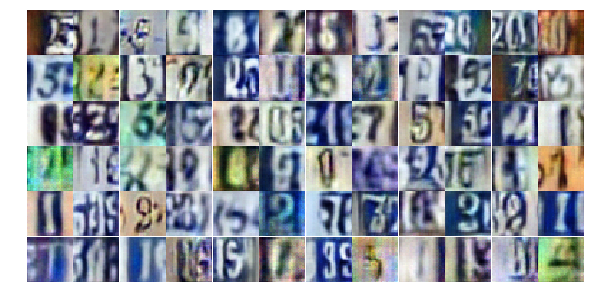

Epoch 15/25... Discriminator Loss: 0.6576... Generator Loss: 1.0876
Epoch 15/25... Discriminator Loss: 0.7092... Generator Loss: 1.1799
Epoch 15/25... Discriminator Loss: 1.1714... Generator Loss: 0.5034
Epoch 15/25... Discriminator Loss: 0.4847... Generator Loss: 1.4712
Epoch 15/25... Discriminator Loss: 0.9400... Generator Loss: 0.7575
Epoch 15/25... Discriminator Loss: 0.4698... Generator Loss: 1.7526
Epoch 15/25... Discriminator Loss: 1.2787... Generator Loss: 0.4534
Epoch 15/25... Discriminator Loss: 0.6615... Generator Loss: 1.2360
Epoch 15/25... Discriminator Loss: 0.8955... Generator Loss: 3.2764
Epoch 15/25... Discriminator Loss: 0.9838... Generator Loss: 0.9817


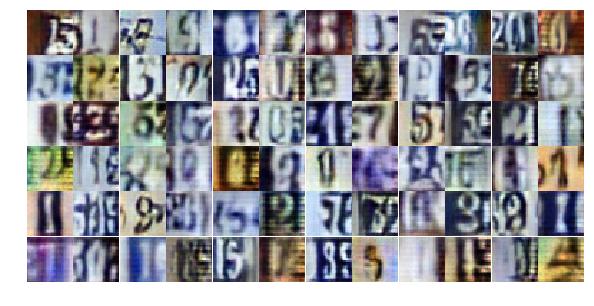

Epoch 15/25... Discriminator Loss: 0.9208... Generator Loss: 0.8089
Epoch 15/25... Discriminator Loss: 0.7214... Generator Loss: 0.9246
Epoch 15/25... Discriminator Loss: 0.4021... Generator Loss: 1.8150
Epoch 15/25... Discriminator Loss: 1.0648... Generator Loss: 0.6237
Epoch 15/25... Discriminator Loss: 1.2556... Generator Loss: 0.4939
Epoch 15/25... Discriminator Loss: 0.5697... Generator Loss: 1.3273
Epoch 15/25... Discriminator Loss: 0.9818... Generator Loss: 0.7419
Epoch 15/25... Discriminator Loss: 0.8925... Generator Loss: 0.7823
Epoch 15/25... Discriminator Loss: 0.5619... Generator Loss: 1.1787
Epoch 15/25... Discriminator Loss: 1.6591... Generator Loss: 0.3111


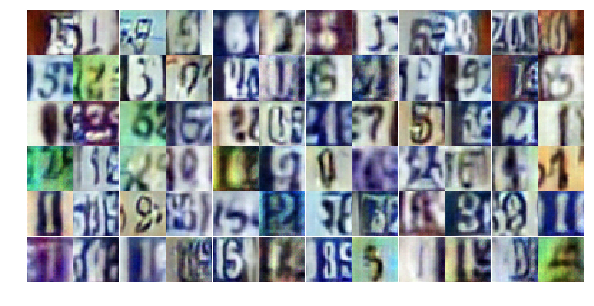

Epoch 15/25... Discriminator Loss: 0.5827... Generator Loss: 1.3066
Epoch 15/25... Discriminator Loss: 0.8489... Generator Loss: 0.8451
Epoch 15/25... Discriminator Loss: 0.5544... Generator Loss: 1.3067
Epoch 15/25... Discriminator Loss: 0.7105... Generator Loss: 1.0153
Epoch 15/25... Discriminator Loss: 0.6111... Generator Loss: 1.1931
Epoch 15/25... Discriminator Loss: 2.0080... Generator Loss: 4.6835
Epoch 15/25... Discriminator Loss: 0.5355... Generator Loss: 1.3848
Epoch 15/25... Discriminator Loss: 0.7479... Generator Loss: 0.9151
Epoch 15/25... Discriminator Loss: 0.6914... Generator Loss: 0.9599
Epoch 15/25... Discriminator Loss: 0.7128... Generator Loss: 1.2490


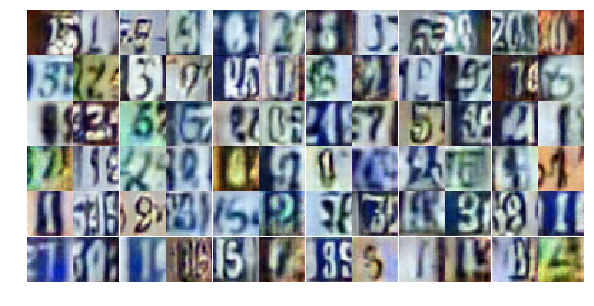

Epoch 15/25... Discriminator Loss: 0.8572... Generator Loss: 0.7640
Epoch 15/25... Discriminator Loss: 1.2986... Generator Loss: 0.5039
Epoch 15/25... Discriminator Loss: 0.5281... Generator Loss: 1.6267
Epoch 15/25... Discriminator Loss: 0.6080... Generator Loss: 1.1019
Epoch 15/25... Discriminator Loss: 0.5774... Generator Loss: 1.1158
Epoch 15/25... Discriminator Loss: 1.8559... Generator Loss: 0.2733
Epoch 15/25... Discriminator Loss: 0.3927... Generator Loss: 1.9425
Epoch 15/25... Discriminator Loss: 0.6568... Generator Loss: 1.5934
Epoch 15/25... Discriminator Loss: 0.7051... Generator Loss: 0.9668
Epoch 15/25... Discriminator Loss: 0.7744... Generator Loss: 0.9515


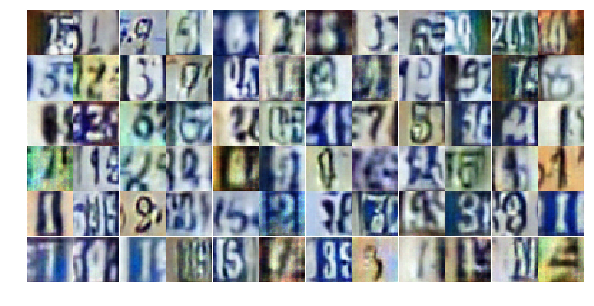

Epoch 15/25... Discriminator Loss: 0.6436... Generator Loss: 0.9554
Epoch 15/25... Discriminator Loss: 0.6945... Generator Loss: 1.0065
Epoch 15/25... Discriminator Loss: 0.4126... Generator Loss: 1.4819
Epoch 15/25... Discriminator Loss: 2.2429... Generator Loss: 3.7554
Epoch 15/25... Discriminator Loss: 0.6908... Generator Loss: 0.9498
Epoch 15/25... Discriminator Loss: 0.8510... Generator Loss: 2.2688
Epoch 15/25... Discriminator Loss: 0.9362... Generator Loss: 0.8671
Epoch 15/25... Discriminator Loss: 0.4660... Generator Loss: 1.5589
Epoch 15/25... Discriminator Loss: 1.4262... Generator Loss: 0.3896
Epoch 16/25... Discriminator Loss: 0.7194... Generator Loss: 0.8981


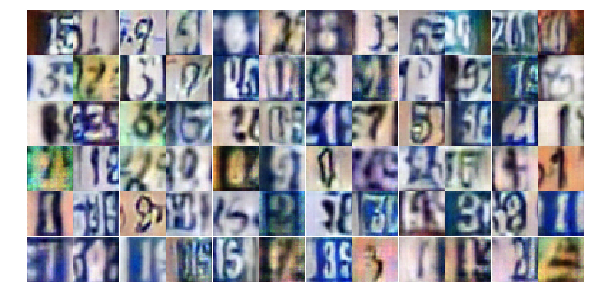

Epoch 16/25... Discriminator Loss: 0.5836... Generator Loss: 1.1432
Epoch 16/25... Discriminator Loss: 0.9451... Generator Loss: 0.7048
Epoch 16/25... Discriminator Loss: 1.1587... Generator Loss: 0.4988
Epoch 16/25... Discriminator Loss: 0.6127... Generator Loss: 1.3377
Epoch 16/25... Discriminator Loss: 0.4583... Generator Loss: 1.5357
Epoch 16/25... Discriminator Loss: 0.8851... Generator Loss: 2.1873
Epoch 16/25... Discriminator Loss: 1.4765... Generator Loss: 0.3615
Epoch 16/25... Discriminator Loss: 0.9124... Generator Loss: 0.7346
Epoch 16/25... Discriminator Loss: 0.4329... Generator Loss: 1.5115
Epoch 16/25... Discriminator Loss: 0.5654... Generator Loss: 1.2662


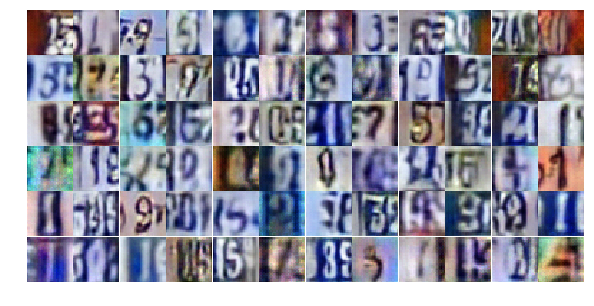

Epoch 16/25... Discriminator Loss: 1.1294... Generator Loss: 0.5987
Epoch 16/25... Discriminator Loss: 0.5603... Generator Loss: 1.2929
Epoch 16/25... Discriminator Loss: 0.4845... Generator Loss: 1.5384
Epoch 16/25... Discriminator Loss: 1.1602... Generator Loss: 0.5212
Epoch 16/25... Discriminator Loss: 0.4630... Generator Loss: 1.3016
Epoch 16/25... Discriminator Loss: 0.5777... Generator Loss: 1.2019
Epoch 16/25... Discriminator Loss: 1.0354... Generator Loss: 2.0778
Epoch 16/25... Discriminator Loss: 0.7608... Generator Loss: 1.0575
Epoch 16/25... Discriminator Loss: 0.5496... Generator Loss: 1.3554
Epoch 16/25... Discriminator Loss: 0.8145... Generator Loss: 2.6255


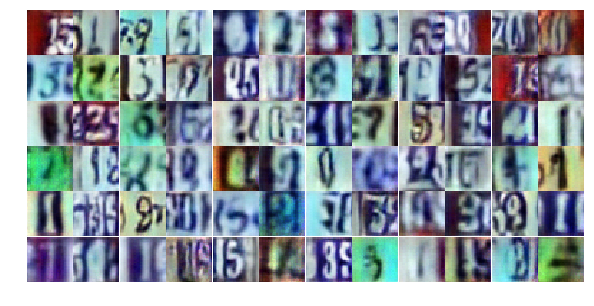

Epoch 16/25... Discriminator Loss: 0.6939... Generator Loss: 1.1031
Epoch 16/25... Discriminator Loss: 0.6511... Generator Loss: 0.9860
Epoch 16/25... Discriminator Loss: 0.7179... Generator Loss: 0.9695
Epoch 16/25... Discriminator Loss: 1.1716... Generator Loss: 0.4735
Epoch 16/25... Discriminator Loss: 0.7789... Generator Loss: 0.8855
Epoch 16/25... Discriminator Loss: 0.8335... Generator Loss: 0.7681
Epoch 16/25... Discriminator Loss: 0.9126... Generator Loss: 0.7145
Epoch 16/25... Discriminator Loss: 0.4882... Generator Loss: 1.4640
Epoch 16/25... Discriminator Loss: 1.1363... Generator Loss: 0.5821
Epoch 16/25... Discriminator Loss: 0.8068... Generator Loss: 0.8204


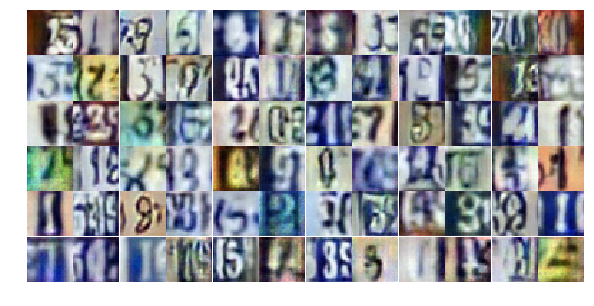

Epoch 16/25... Discriminator Loss: 0.5841... Generator Loss: 1.0815
Epoch 16/25... Discriminator Loss: 0.5776... Generator Loss: 1.3610
Epoch 16/25... Discriminator Loss: 0.8247... Generator Loss: 2.6317
Epoch 16/25... Discriminator Loss: 0.8566... Generator Loss: 0.9680
Epoch 16/25... Discriminator Loss: 1.0125... Generator Loss: 2.1195
Epoch 16/25... Discriminator Loss: 0.6119... Generator Loss: 1.1982
Epoch 16/25... Discriminator Loss: 0.9718... Generator Loss: 0.6675
Epoch 16/25... Discriminator Loss: 1.0760... Generator Loss: 0.5683
Epoch 16/25... Discriminator Loss: 0.7907... Generator Loss: 0.9376
Epoch 16/25... Discriminator Loss: 0.4285... Generator Loss: 1.8352


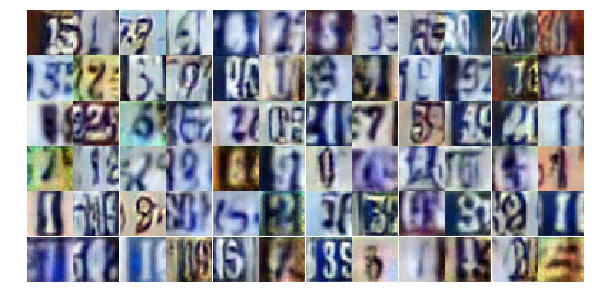

Epoch 16/25... Discriminator Loss: 0.5935... Generator Loss: 1.3459
Epoch 16/25... Discriminator Loss: 0.5187... Generator Loss: 1.4214
Epoch 16/25... Discriminator Loss: 0.7574... Generator Loss: 0.8781
Epoch 16/25... Discriminator Loss: 0.4973... Generator Loss: 1.6234
Epoch 16/25... Discriminator Loss: 1.9812... Generator Loss: 0.3129
Epoch 16/25... Discriminator Loss: 3.5418... Generator Loss: 0.0781
Epoch 16/25... Discriminator Loss: 0.6219... Generator Loss: 1.7323
Epoch 16/25... Discriminator Loss: 0.7567... Generator Loss: 1.1233
Epoch 16/25... Discriminator Loss: 0.5335... Generator Loss: 1.3885
Epoch 16/25... Discriminator Loss: 0.8199... Generator Loss: 0.9342


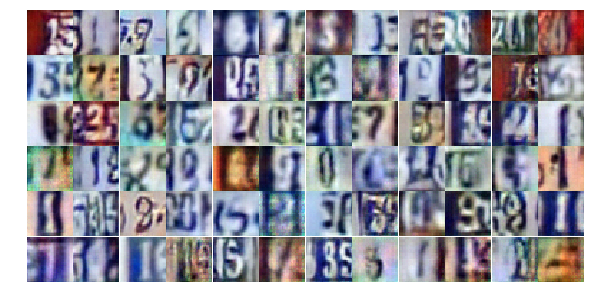

Epoch 16/25... Discriminator Loss: 1.3900... Generator Loss: 0.4212
Epoch 16/25... Discriminator Loss: 0.5758... Generator Loss: 1.3914
Epoch 16/25... Discriminator Loss: 1.1044... Generator Loss: 0.6615
Epoch 16/25... Discriminator Loss: 0.4822... Generator Loss: 1.4121
Epoch 16/25... Discriminator Loss: 0.6735... Generator Loss: 0.9583
Epoch 16/25... Discriminator Loss: 0.6867... Generator Loss: 1.0899
Epoch 17/25... Discriminator Loss: 0.8129... Generator Loss: 0.9301
Epoch 17/25... Discriminator Loss: 1.0952... Generator Loss: 0.5954
Epoch 17/25... Discriminator Loss: 0.7757... Generator Loss: 1.0377
Epoch 17/25... Discriminator Loss: 0.6226... Generator Loss: 1.3109


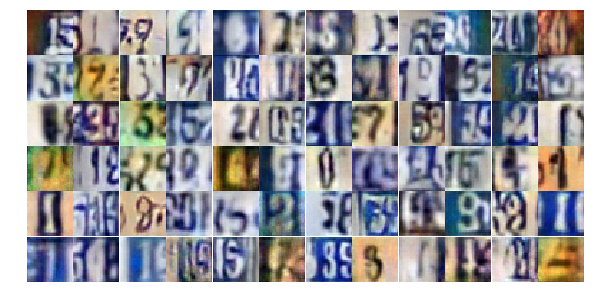

Epoch 17/25... Discriminator Loss: 0.3971... Generator Loss: 2.0058
Epoch 17/25... Discriminator Loss: 0.5214... Generator Loss: 1.3818
Epoch 17/25... Discriminator Loss: 0.7249... Generator Loss: 1.1467
Epoch 17/25... Discriminator Loss: 0.8807... Generator Loss: 0.8055
Epoch 17/25... Discriminator Loss: 0.8998... Generator Loss: 0.7092
Epoch 17/25... Discriminator Loss: 1.1386... Generator Loss: 0.5999
Epoch 17/25... Discriminator Loss: 1.0031... Generator Loss: 0.6107
Epoch 17/25... Discriminator Loss: 0.5981... Generator Loss: 1.1076
Epoch 17/25... Discriminator Loss: 0.4282... Generator Loss: 1.5327
Epoch 17/25... Discriminator Loss: 0.5960... Generator Loss: 1.1785


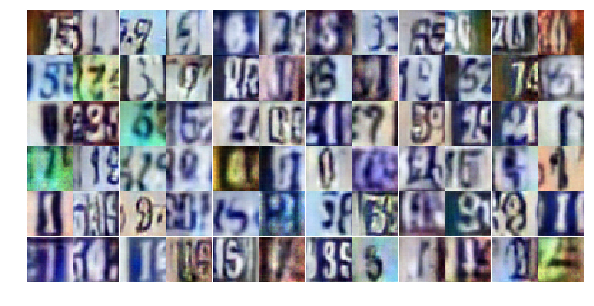

Epoch 17/25... Discriminator Loss: 0.9958... Generator Loss: 0.6388
Epoch 17/25... Discriminator Loss: 0.7567... Generator Loss: 0.9263
Epoch 17/25... Discriminator Loss: 0.7385... Generator Loss: 0.9019
Epoch 17/25... Discriminator Loss: 0.6770... Generator Loss: 1.1716
Epoch 17/25... Discriminator Loss: 0.5293... Generator Loss: 1.3318
Epoch 17/25... Discriminator Loss: 0.6189... Generator Loss: 1.0713
Epoch 17/25... Discriminator Loss: 0.6784... Generator Loss: 1.1746
Epoch 17/25... Discriminator Loss: 0.6045... Generator Loss: 1.1572
Epoch 17/25... Discriminator Loss: 0.6919... Generator Loss: 0.9935
Epoch 17/25... Discriminator Loss: 0.4797... Generator Loss: 1.3307


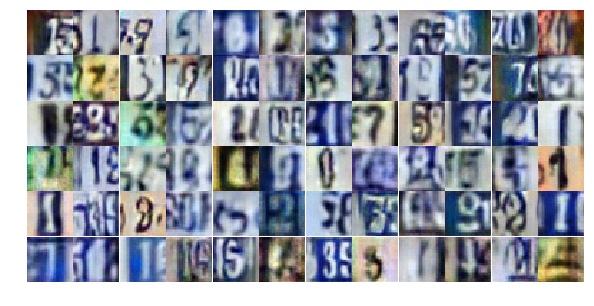

Epoch 17/25... Discriminator Loss: 1.8277... Generator Loss: 0.2433
Epoch 17/25... Discriminator Loss: 0.5697... Generator Loss: 1.2197
Epoch 17/25... Discriminator Loss: 0.4337... Generator Loss: 1.5464
Epoch 17/25... Discriminator Loss: 1.5913... Generator Loss: 0.3230
Epoch 17/25... Discriminator Loss: 1.0297... Generator Loss: 0.6905
Epoch 17/25... Discriminator Loss: 0.4515... Generator Loss: 1.3705
Epoch 17/25... Discriminator Loss: 0.7348... Generator Loss: 0.9998
Epoch 17/25... Discriminator Loss: 0.9131... Generator Loss: 0.7287
Epoch 17/25... Discriminator Loss: 1.2437... Generator Loss: 0.5127
Epoch 17/25... Discriminator Loss: 0.4302... Generator Loss: 1.8614


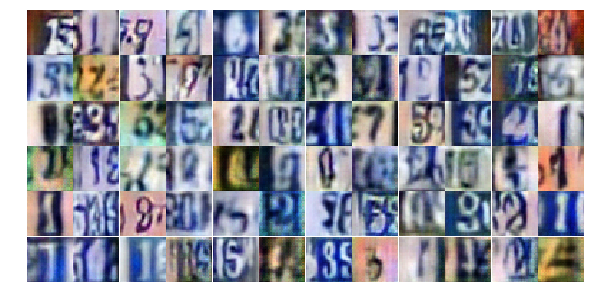

Epoch 17/25... Discriminator Loss: 0.5287... Generator Loss: 1.4889
Epoch 17/25... Discriminator Loss: 1.3468... Generator Loss: 0.4439
Epoch 17/25... Discriminator Loss: 0.7177... Generator Loss: 1.0500
Epoch 17/25... Discriminator Loss: 0.6949... Generator Loss: 2.2456
Epoch 17/25... Discriminator Loss: 0.8726... Generator Loss: 0.7474
Epoch 17/25... Discriminator Loss: 0.6854... Generator Loss: 1.5115
Epoch 17/25... Discriminator Loss: 0.8624... Generator Loss: 0.8037
Epoch 17/25... Discriminator Loss: 0.6985... Generator Loss: 0.9626
Epoch 17/25... Discriminator Loss: 0.3125... Generator Loss: 2.0131
Epoch 17/25... Discriminator Loss: 0.8683... Generator Loss: 0.8303


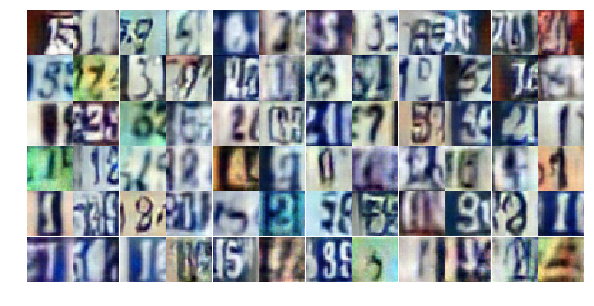

Epoch 17/25... Discriminator Loss: 0.8849... Generator Loss: 1.5929
Epoch 17/25... Discriminator Loss: 0.2820... Generator Loss: 2.7765
Epoch 17/25... Discriminator Loss: 0.8623... Generator Loss: 1.2975
Epoch 17/25... Discriminator Loss: 0.4087... Generator Loss: 1.5485
Epoch 17/25... Discriminator Loss: 0.8292... Generator Loss: 0.8126
Epoch 17/25... Discriminator Loss: 0.9339... Generator Loss: 0.7325
Epoch 17/25... Discriminator Loss: 1.8220... Generator Loss: 0.3173
Epoch 17/25... Discriminator Loss: 0.6889... Generator Loss: 1.1316
Epoch 17/25... Discriminator Loss: 0.6630... Generator Loss: 1.1218
Epoch 17/25... Discriminator Loss: 1.2116... Generator Loss: 0.4844


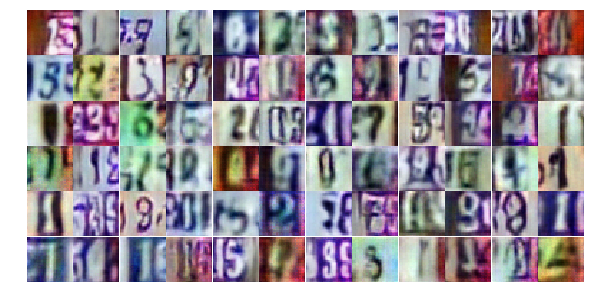

Epoch 17/25... Discriminator Loss: 0.9191... Generator Loss: 2.2250
Epoch 17/25... Discriminator Loss: 0.9269... Generator Loss: 1.0147
Epoch 17/25... Discriminator Loss: 0.5738... Generator Loss: 1.2528
Epoch 17/25... Discriminator Loss: 0.7619... Generator Loss: 0.8991
Epoch 18/25... Discriminator Loss: 1.1886... Generator Loss: 0.5387
Epoch 18/25... Discriminator Loss: 1.0442... Generator Loss: 0.5646
Epoch 18/25... Discriminator Loss: 0.7243... Generator Loss: 1.0371
Epoch 18/25... Discriminator Loss: 0.6479... Generator Loss: 1.0086
Epoch 18/25... Discriminator Loss: 0.7702... Generator Loss: 1.3220
Epoch 18/25... Discriminator Loss: 0.6110... Generator Loss: 1.3197


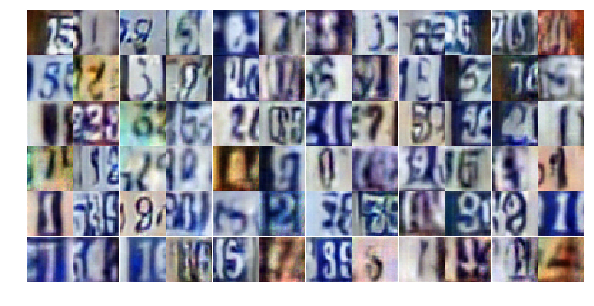

Epoch 18/25... Discriminator Loss: 0.4773... Generator Loss: 2.3926
Epoch 18/25... Discriminator Loss: 1.5281... Generator Loss: 0.3683
Epoch 18/25... Discriminator Loss: 0.6949... Generator Loss: 0.9547
Epoch 18/25... Discriminator Loss: 0.4690... Generator Loss: 1.7867
Epoch 18/25... Discriminator Loss: 0.6377... Generator Loss: 1.1340
Epoch 18/25... Discriminator Loss: 1.0012... Generator Loss: 0.6570
Epoch 18/25... Discriminator Loss: 0.3736... Generator Loss: 2.0576
Epoch 18/25... Discriminator Loss: 0.7232... Generator Loss: 0.9618
Epoch 18/25... Discriminator Loss: 0.9553... Generator Loss: 2.5027
Epoch 18/25... Discriminator Loss: 0.6789... Generator Loss: 2.1518


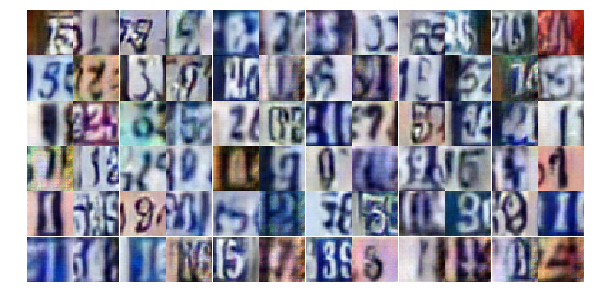

Epoch 18/25... Discriminator Loss: 0.6048... Generator Loss: 1.2439
Epoch 18/25... Discriminator Loss: 0.9466... Generator Loss: 0.7221
Epoch 18/25... Discriminator Loss: 1.4090... Generator Loss: 0.4599
Epoch 18/25... Discriminator Loss: 0.6333... Generator Loss: 1.1295
Epoch 18/25... Discriminator Loss: 0.8441... Generator Loss: 0.7646
Epoch 18/25... Discriminator Loss: 1.0142... Generator Loss: 0.6377
Epoch 18/25... Discriminator Loss: 0.8457... Generator Loss: 1.5316
Epoch 18/25... Discriminator Loss: 0.9294... Generator Loss: 0.7985
Epoch 18/25... Discriminator Loss: 0.8881... Generator Loss: 0.7991
Epoch 18/25... Discriminator Loss: 0.5183... Generator Loss: 1.2355


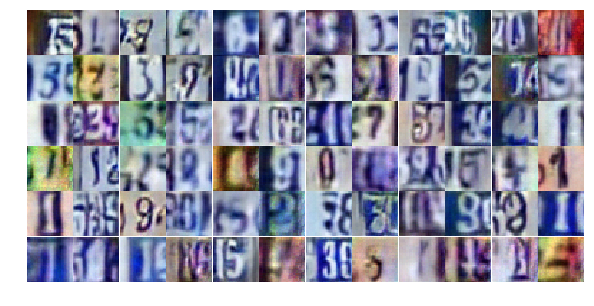

Epoch 18/25... Discriminator Loss: 0.3974... Generator Loss: 1.6079
Epoch 18/25... Discriminator Loss: 0.8113... Generator Loss: 0.8668
Epoch 18/25... Discriminator Loss: 0.7070... Generator Loss: 0.9636
Epoch 18/25... Discriminator Loss: 0.7498... Generator Loss: 0.9496
Epoch 18/25... Discriminator Loss: 0.7918... Generator Loss: 0.8930
Epoch 18/25... Discriminator Loss: 0.7087... Generator Loss: 1.0272
Epoch 18/25... Discriminator Loss: 0.5804... Generator Loss: 1.2640
Epoch 18/25... Discriminator Loss: 0.4914... Generator Loss: 1.6306
Epoch 18/25... Discriminator Loss: 0.7230... Generator Loss: 0.9767
Epoch 18/25... Discriminator Loss: 0.6398... Generator Loss: 1.0775


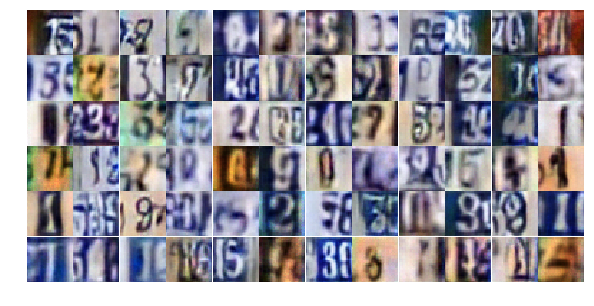

Epoch 18/25... Discriminator Loss: 0.4565... Generator Loss: 1.5147
Epoch 18/25... Discriminator Loss: 0.6803... Generator Loss: 1.0017
Epoch 18/25... Discriminator Loss: 0.6981... Generator Loss: 0.9302
Epoch 18/25... Discriminator Loss: 0.9813... Generator Loss: 0.6917
Epoch 18/25... Discriminator Loss: 0.8200... Generator Loss: 0.9159
Epoch 18/25... Discriminator Loss: 0.5797... Generator Loss: 1.0965
Epoch 18/25... Discriminator Loss: 1.0321... Generator Loss: 0.7024
Epoch 18/25... Discriminator Loss: 1.2927... Generator Loss: 2.9428
Epoch 18/25... Discriminator Loss: 2.2392... Generator Loss: 3.1088
Epoch 18/25... Discriminator Loss: 0.3068... Generator Loss: 3.3151


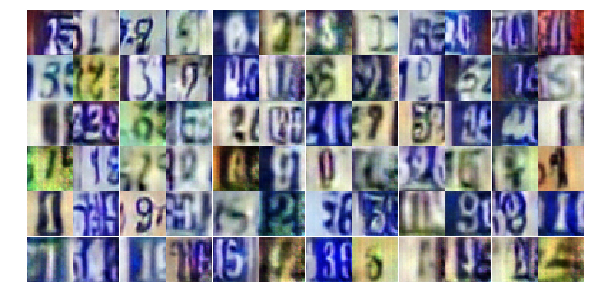

Epoch 18/25... Discriminator Loss: 0.8129... Generator Loss: 0.9398
Epoch 18/25... Discriminator Loss: 0.8828... Generator Loss: 0.7965
Epoch 18/25... Discriminator Loss: 0.7424... Generator Loss: 1.1989
Epoch 18/25... Discriminator Loss: 0.8094... Generator Loss: 1.0277
Epoch 18/25... Discriminator Loss: 1.0290... Generator Loss: 0.6496
Epoch 18/25... Discriminator Loss: 0.5323... Generator Loss: 1.5433
Epoch 18/25... Discriminator Loss: 0.4837... Generator Loss: 1.3637
Epoch 18/25... Discriminator Loss: 0.3948... Generator Loss: 2.0061
Epoch 18/25... Discriminator Loss: 0.9368... Generator Loss: 0.7470
Epoch 18/25... Discriminator Loss: 0.8567... Generator Loss: 0.7900


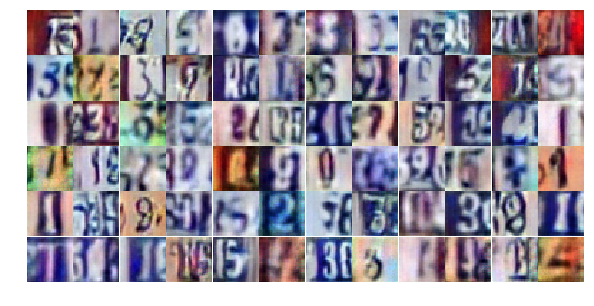

Epoch 18/25... Discriminator Loss: 0.5687... Generator Loss: 1.5066
Epoch 19/25... Discriminator Loss: 1.0828... Generator Loss: 0.6176
Epoch 19/25... Discriminator Loss: 1.2266... Generator Loss: 0.5384
Epoch 19/25... Discriminator Loss: 0.7854... Generator Loss: 1.4565
Epoch 19/25... Discriminator Loss: 0.5938... Generator Loss: 1.1696
Epoch 19/25... Discriminator Loss: 0.8766... Generator Loss: 0.8036
Epoch 19/25... Discriminator Loss: 0.4666... Generator Loss: 1.6613
Epoch 19/25... Discriminator Loss: 0.9086... Generator Loss: 0.7853
Epoch 19/25... Discriminator Loss: 0.5736... Generator Loss: 1.2717
Epoch 19/25... Discriminator Loss: 0.8021... Generator Loss: 0.8844


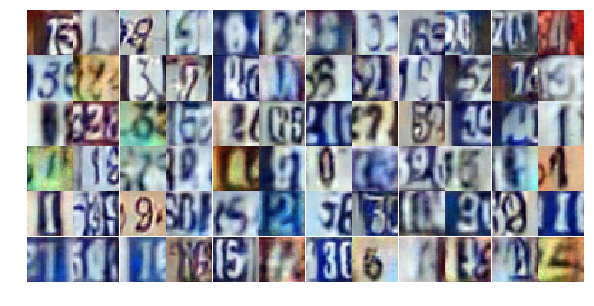

Epoch 19/25... Discriminator Loss: 0.8629... Generator Loss: 0.7672
Epoch 19/25... Discriminator Loss: 0.8839... Generator Loss: 0.7817
Epoch 19/25... Discriminator Loss: 0.6926... Generator Loss: 1.3497
Epoch 19/25... Discriminator Loss: 0.9064... Generator Loss: 0.7452
Epoch 19/25... Discriminator Loss: 0.7688... Generator Loss: 0.8315
Epoch 19/25... Discriminator Loss: 0.6314... Generator Loss: 1.2268
Epoch 19/25... Discriminator Loss: 1.2004... Generator Loss: 0.5586
Epoch 19/25... Discriminator Loss: 0.7420... Generator Loss: 0.8682
Epoch 19/25... Discriminator Loss: 1.0046... Generator Loss: 0.8543
Epoch 19/25... Discriminator Loss: 0.8400... Generator Loss: 0.8364


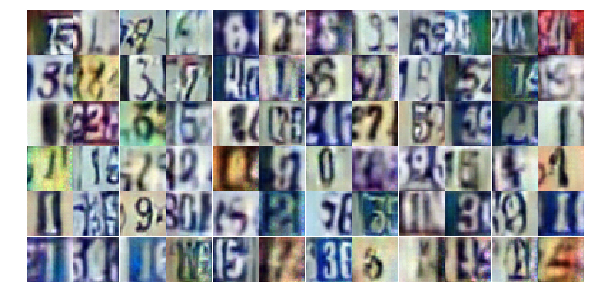

Epoch 19/25... Discriminator Loss: 0.7500... Generator Loss: 0.9043
Epoch 19/25... Discriminator Loss: 1.3139... Generator Loss: 0.4419
Epoch 19/25... Discriminator Loss: 1.0497... Generator Loss: 0.7021
Epoch 19/25... Discriminator Loss: 0.9000... Generator Loss: 0.8408
Epoch 19/25... Discriminator Loss: 1.3195... Generator Loss: 0.4642
Epoch 19/25... Discriminator Loss: 0.6649... Generator Loss: 1.3777
Epoch 19/25... Discriminator Loss: 0.6907... Generator Loss: 2.0560
Epoch 19/25... Discriminator Loss: 0.6325... Generator Loss: 1.0876
Epoch 19/25... Discriminator Loss: 0.6935... Generator Loss: 1.0193
Epoch 19/25... Discriminator Loss: 1.0739... Generator Loss: 0.6118


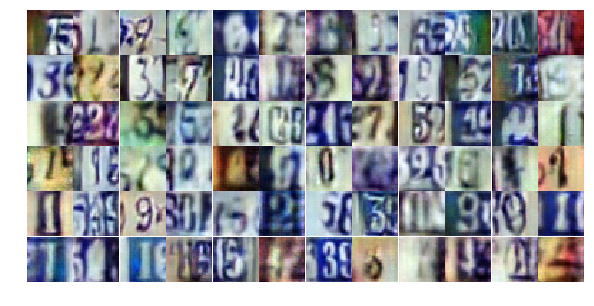

Epoch 19/25... Discriminator Loss: 1.1001... Generator Loss: 0.6156
Epoch 19/25... Discriminator Loss: 0.8902... Generator Loss: 0.7836
Epoch 19/25... Discriminator Loss: 1.0093... Generator Loss: 0.6176
Epoch 19/25... Discriminator Loss: 0.7242... Generator Loss: 0.9165
Epoch 19/25... Discriminator Loss: 0.5786... Generator Loss: 1.1922
Epoch 19/25... Discriminator Loss: 1.2123... Generator Loss: 0.5923
Epoch 19/25... Discriminator Loss: 0.6894... Generator Loss: 1.3517
Epoch 19/25... Discriminator Loss: 0.5270... Generator Loss: 1.5733
Epoch 19/25... Discriminator Loss: 0.9388... Generator Loss: 0.7611
Epoch 19/25... Discriminator Loss: 0.8020... Generator Loss: 2.9927


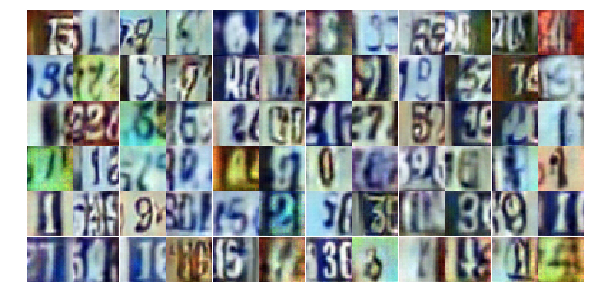

Epoch 19/25... Discriminator Loss: 0.6954... Generator Loss: 0.9118
Epoch 19/25... Discriminator Loss: 0.9214... Generator Loss: 0.7146
Epoch 19/25... Discriminator Loss: 1.6066... Generator Loss: 0.3345
Epoch 19/25... Discriminator Loss: 0.6554... Generator Loss: 1.0320
Epoch 19/25... Discriminator Loss: 0.5087... Generator Loss: 1.5592
Epoch 19/25... Discriminator Loss: 0.5404... Generator Loss: 1.4401
Epoch 19/25... Discriminator Loss: 1.1673... Generator Loss: 0.5189
Epoch 19/25... Discriminator Loss: 0.6085... Generator Loss: 1.1954
Epoch 19/25... Discriminator Loss: 0.7845... Generator Loss: 0.8712
Epoch 19/25... Discriminator Loss: 0.9111... Generator Loss: 0.8275


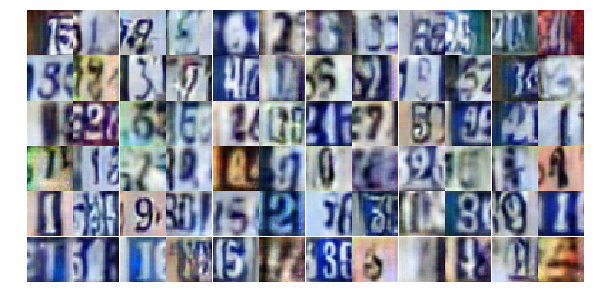

Epoch 19/25... Discriminator Loss: 0.8295... Generator Loss: 0.7712
Epoch 19/25... Discriminator Loss: 0.8210... Generator Loss: 0.8336
Epoch 19/25... Discriminator Loss: 0.5716... Generator Loss: 1.6631
Epoch 19/25... Discriminator Loss: 1.3906... Generator Loss: 0.4425
Epoch 19/25... Discriminator Loss: 1.3616... Generator Loss: 0.4704
Epoch 19/25... Discriminator Loss: 1.2773... Generator Loss: 0.5049
Epoch 19/25... Discriminator Loss: 2.3375... Generator Loss: 0.1703
Epoch 19/25... Discriminator Loss: 0.6369... Generator Loss: 1.0865
Epoch 20/25... Discriminator Loss: 0.9672... Generator Loss: 0.6883
Epoch 20/25... Discriminator Loss: 0.6542... Generator Loss: 1.1398


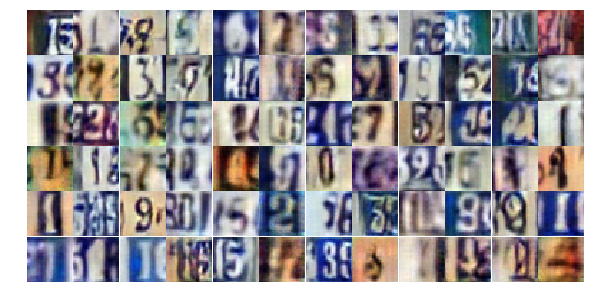

Epoch 20/25... Discriminator Loss: 0.6090... Generator Loss: 1.1336
Epoch 20/25... Discriminator Loss: 0.8417... Generator Loss: 0.8365
Epoch 20/25... Discriminator Loss: 1.2476... Generator Loss: 0.4206
Epoch 20/25... Discriminator Loss: 1.4296... Generator Loss: 0.4309
Epoch 20/25... Discriminator Loss: 0.5115... Generator Loss: 1.5447
Epoch 20/25... Discriminator Loss: 0.7294... Generator Loss: 0.9505
Epoch 20/25... Discriminator Loss: 0.7611... Generator Loss: 1.6079
Epoch 20/25... Discriminator Loss: 0.8361... Generator Loss: 0.8042
Epoch 20/25... Discriminator Loss: 0.9036... Generator Loss: 0.7796
Epoch 20/25... Discriminator Loss: 0.7326... Generator Loss: 0.9652


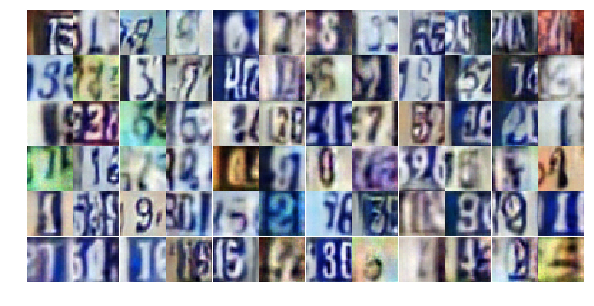

Epoch 20/25... Discriminator Loss: 1.5713... Generator Loss: 0.3447
Epoch 20/25... Discriminator Loss: 0.7873... Generator Loss: 0.9688
Epoch 20/25... Discriminator Loss: 0.6660... Generator Loss: 1.3234
Epoch 20/25... Discriminator Loss: 0.8798... Generator Loss: 0.8315
Epoch 20/25... Discriminator Loss: 1.0841... Generator Loss: 0.6820
Epoch 20/25... Discriminator Loss: 1.2669... Generator Loss: 0.5141
Epoch 20/25... Discriminator Loss: 1.5572... Generator Loss: 0.4387
Epoch 20/25... Discriminator Loss: 0.8027... Generator Loss: 0.8361
Epoch 20/25... Discriminator Loss: 0.5168... Generator Loss: 1.3516
Epoch 20/25... Discriminator Loss: 1.1401... Generator Loss: 0.6449


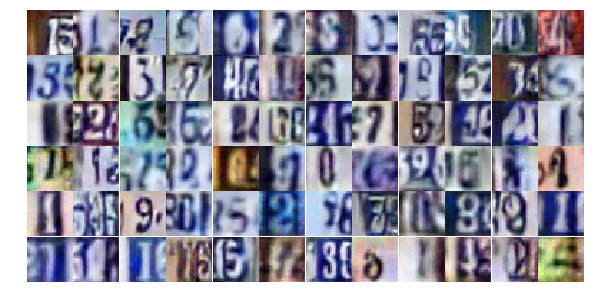

Epoch 20/25... Discriminator Loss: 0.5558... Generator Loss: 1.2327
Epoch 20/25... Discriminator Loss: 0.9343... Generator Loss: 0.7304
Epoch 20/25... Discriminator Loss: 0.2606... Generator Loss: 1.9433
Epoch 20/25... Discriminator Loss: 1.5668... Generator Loss: 0.3488
Epoch 20/25... Discriminator Loss: 1.0189... Generator Loss: 0.6680
Epoch 20/25... Discriminator Loss: 0.4894... Generator Loss: 1.2985
Epoch 20/25... Discriminator Loss: 0.7155... Generator Loss: 1.3111
Epoch 20/25... Discriminator Loss: 1.8294... Generator Loss: 0.2617
Epoch 20/25... Discriminator Loss: 1.1037... Generator Loss: 0.5804
Epoch 20/25... Discriminator Loss: 0.5114... Generator Loss: 1.2176


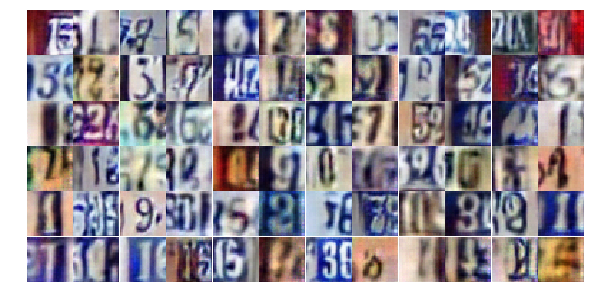

Epoch 20/25... Discriminator Loss: 0.6295... Generator Loss: 1.3648
Epoch 20/25... Discriminator Loss: 0.5012... Generator Loss: 1.3920
Epoch 20/25... Discriminator Loss: 0.6305... Generator Loss: 2.1159
Epoch 20/25... Discriminator Loss: 1.0438... Generator Loss: 2.4693
Epoch 20/25... Discriminator Loss: 1.1145... Generator Loss: 0.7241
Epoch 20/25... Discriminator Loss: 0.8451... Generator Loss: 0.8753
Epoch 20/25... Discriminator Loss: 0.7837... Generator Loss: 1.1446
Epoch 20/25... Discriminator Loss: 0.7362... Generator Loss: 1.3950
Epoch 20/25... Discriminator Loss: 0.7311... Generator Loss: 1.0430
Epoch 20/25... Discriminator Loss: 1.3741... Generator Loss: 0.4371


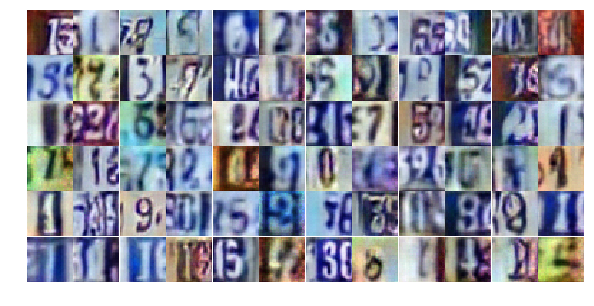

Epoch 20/25... Discriminator Loss: 0.7642... Generator Loss: 0.9228
Epoch 20/25... Discriminator Loss: 0.8485... Generator Loss: 0.7909
Epoch 20/25... Discriminator Loss: 1.4154... Generator Loss: 0.4971
Epoch 20/25... Discriminator Loss: 0.6776... Generator Loss: 1.2033
Epoch 20/25... Discriminator Loss: 0.6051... Generator Loss: 1.3405
Epoch 20/25... Discriminator Loss: 1.1644... Generator Loss: 0.5855
Epoch 20/25... Discriminator Loss: 1.0084... Generator Loss: 0.6222
Epoch 20/25... Discriminator Loss: 0.3904... Generator Loss: 1.8018
Epoch 20/25... Discriminator Loss: 0.8181... Generator Loss: 0.8067
Epoch 20/25... Discriminator Loss: 0.7153... Generator Loss: 1.0181


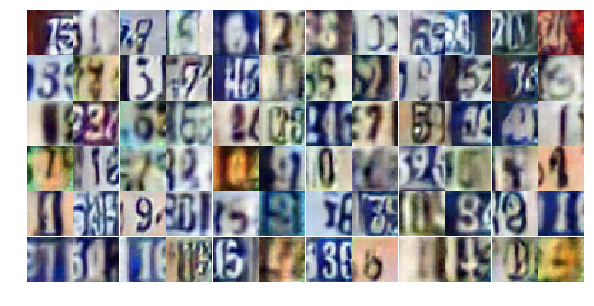

Epoch 20/25... Discriminator Loss: 0.4907... Generator Loss: 1.6095
Epoch 20/25... Discriminator Loss: 0.6676... Generator Loss: 1.4102
Epoch 20/25... Discriminator Loss: 0.5369... Generator Loss: 1.2926
Epoch 20/25... Discriminator Loss: 0.7319... Generator Loss: 1.4312
Epoch 20/25... Discriminator Loss: 0.7738... Generator Loss: 0.8395
Epoch 20/25... Discriminator Loss: 0.7387... Generator Loss: 0.9158
Epoch 21/25... Discriminator Loss: 0.8269... Generator Loss: 0.8790
Epoch 21/25... Discriminator Loss: 0.7960... Generator Loss: 0.7790
Epoch 21/25... Discriminator Loss: 1.1895... Generator Loss: 0.5041
Epoch 21/25... Discriminator Loss: 1.0158... Generator Loss: 0.6745


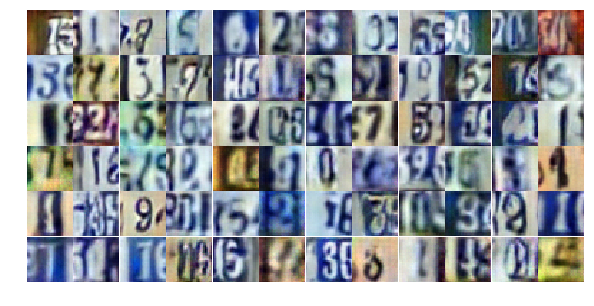

Epoch 21/25... Discriminator Loss: 0.7955... Generator Loss: 0.9073
Epoch 21/25... Discriminator Loss: 1.8844... Generator Loss: 0.3456
Epoch 21/25... Discriminator Loss: 0.5458... Generator Loss: 1.7512
Epoch 21/25... Discriminator Loss: 0.3503... Generator Loss: 1.6527
Epoch 21/25... Discriminator Loss: 1.0348... Generator Loss: 0.6650
Epoch 21/25... Discriminator Loss: 0.4604... Generator Loss: 1.4466
Epoch 21/25... Discriminator Loss: 1.0880... Generator Loss: 0.6025
Epoch 21/25... Discriminator Loss: 0.8118... Generator Loss: 1.9396
Epoch 21/25... Discriminator Loss: 0.7906... Generator Loss: 0.8130
Epoch 21/25... Discriminator Loss: 0.8225... Generator Loss: 0.9309


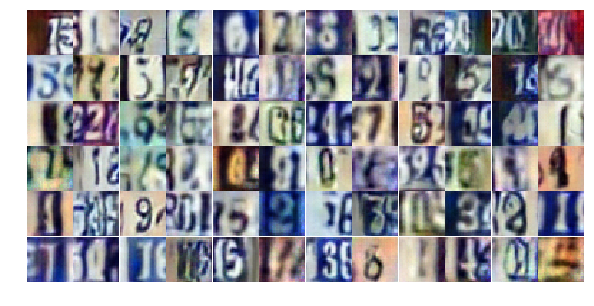

Epoch 21/25... Discriminator Loss: 0.4846... Generator Loss: 1.2600
Epoch 21/25... Discriminator Loss: 0.7717... Generator Loss: 0.8622
Epoch 21/25... Discriminator Loss: 2.6549... Generator Loss: 0.1529
Epoch 21/25... Discriminator Loss: 2.1954... Generator Loss: 0.2005
Epoch 21/25... Discriminator Loss: 0.7397... Generator Loss: 2.2950
Epoch 21/25... Discriminator Loss: 1.4408... Generator Loss: 0.4653
Epoch 21/25... Discriminator Loss: 0.8035... Generator Loss: 0.9416
Epoch 21/25... Discriminator Loss: 0.5637... Generator Loss: 1.2416
Epoch 21/25... Discriminator Loss: 0.5401... Generator Loss: 1.7435
Epoch 21/25... Discriminator Loss: 0.7377... Generator Loss: 1.0374


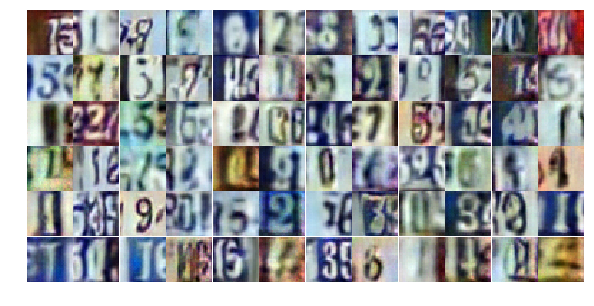

Epoch 21/25... Discriminator Loss: 1.3882... Generator Loss: 0.4295
Epoch 21/25... Discriminator Loss: 0.3956... Generator Loss: 1.9373
Epoch 21/25... Discriminator Loss: 0.8756... Generator Loss: 0.7849
Epoch 21/25... Discriminator Loss: 0.6560... Generator Loss: 1.1157
Epoch 21/25... Discriminator Loss: 0.8874... Generator Loss: 0.7965
Epoch 21/25... Discriminator Loss: 1.0110... Generator Loss: 0.7111
Epoch 21/25... Discriminator Loss: 1.1646... Generator Loss: 0.5233
Epoch 21/25... Discriminator Loss: 1.1830... Generator Loss: 0.5298
Epoch 21/25... Discriminator Loss: 1.0642... Generator Loss: 0.5938
Epoch 21/25... Discriminator Loss: 1.3909... Generator Loss: 0.5300


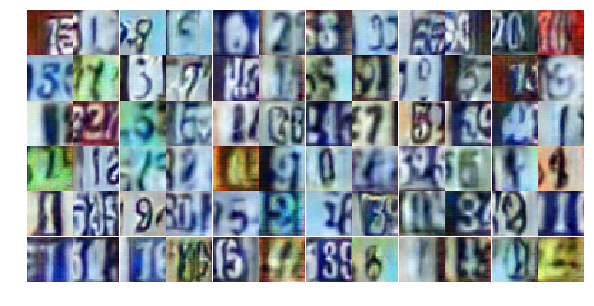

Epoch 21/25... Discriminator Loss: 1.1647... Generator Loss: 0.5549
Epoch 21/25... Discriminator Loss: 0.7449... Generator Loss: 0.9815
Epoch 21/25... Discriminator Loss: 1.0739... Generator Loss: 0.5784
Epoch 21/25... Discriminator Loss: 0.5302... Generator Loss: 1.2450
Epoch 21/25... Discriminator Loss: 0.7655... Generator Loss: 0.9556
Epoch 21/25... Discriminator Loss: 0.9021... Generator Loss: 0.7706
Epoch 21/25... Discriminator Loss: 0.7440... Generator Loss: 0.9706
Epoch 21/25... Discriminator Loss: 1.2630... Generator Loss: 0.5014
Epoch 21/25... Discriminator Loss: 0.7454... Generator Loss: 0.9173
Epoch 21/25... Discriminator Loss: 0.4413... Generator Loss: 1.4180


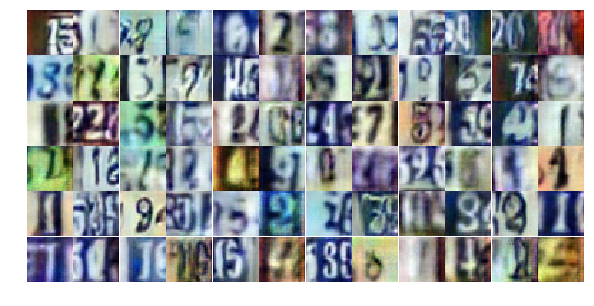

Epoch 21/25... Discriminator Loss: 0.8318... Generator Loss: 2.3125
Epoch 21/25... Discriminator Loss: 2.6281... Generator Loss: 0.1853
Epoch 21/25... Discriminator Loss: 1.1171... Generator Loss: 0.6360
Epoch 21/25... Discriminator Loss: 0.9933... Generator Loss: 0.6923
Epoch 21/25... Discriminator Loss: 0.4895... Generator Loss: 1.4189
Epoch 21/25... Discriminator Loss: 0.8970... Generator Loss: 0.7649
Epoch 21/25... Discriminator Loss: 0.8120... Generator Loss: 0.8420
Epoch 21/25... Discriminator Loss: 1.2929... Generator Loss: 0.4854
Epoch 21/25... Discriminator Loss: 0.8685... Generator Loss: 0.7932
Epoch 21/25... Discriminator Loss: 0.6108... Generator Loss: 1.2272


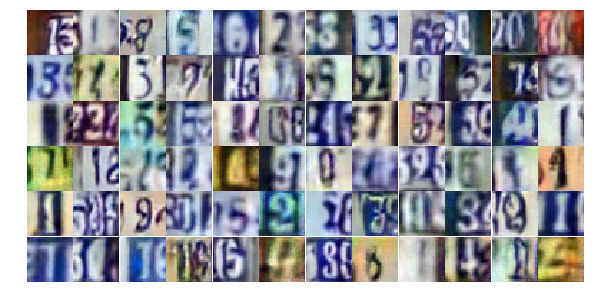

Epoch 21/25... Discriminator Loss: 0.5676... Generator Loss: 1.3354
Epoch 21/25... Discriminator Loss: 1.3954... Generator Loss: 0.4107
Epoch 21/25... Discriminator Loss: 0.8094... Generator Loss: 0.8303
Epoch 22/25... Discriminator Loss: 0.7457... Generator Loss: 0.9733
Epoch 22/25... Discriminator Loss: 1.3768... Generator Loss: 0.4172
Epoch 22/25... Discriminator Loss: 0.7609... Generator Loss: 0.9604
Epoch 22/25... Discriminator Loss: 0.7603... Generator Loss: 0.9115
Epoch 22/25... Discriminator Loss: 0.4237... Generator Loss: 1.4278
Epoch 22/25... Discriminator Loss: 1.0071... Generator Loss: 0.6475
Epoch 22/25... Discriminator Loss: 1.2836... Generator Loss: 0.4334


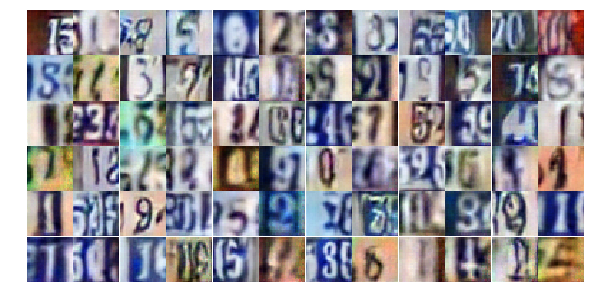

Epoch 22/25... Discriminator Loss: 0.5615... Generator Loss: 1.7103
Epoch 22/25... Discriminator Loss: 0.5949... Generator Loss: 1.2707
Epoch 22/25... Discriminator Loss: 1.6664... Generator Loss: 0.3600
Epoch 22/25... Discriminator Loss: 0.8961... Generator Loss: 0.7517
Epoch 22/25... Discriminator Loss: 1.6226... Generator Loss: 0.3637
Epoch 22/25... Discriminator Loss: 0.6851... Generator Loss: 1.0519
Epoch 22/25... Discriminator Loss: 0.8169... Generator Loss: 0.8233
Epoch 22/25... Discriminator Loss: 0.4978... Generator Loss: 1.3706
Epoch 22/25... Discriminator Loss: 1.0561... Generator Loss: 0.6594
Epoch 22/25... Discriminator Loss: 1.6986... Generator Loss: 0.3028


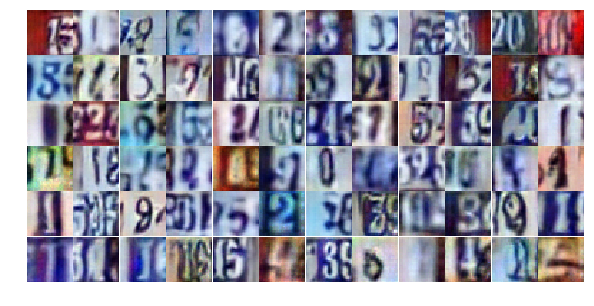

Epoch 22/25... Discriminator Loss: 0.7946... Generator Loss: 1.6837
Epoch 22/25... Discriminator Loss: 0.5438... Generator Loss: 1.2285
Epoch 22/25... Discriminator Loss: 0.9994... Generator Loss: 0.6656
Epoch 22/25... Discriminator Loss: 0.4890... Generator Loss: 1.5765
Epoch 22/25... Discriminator Loss: 0.6177... Generator Loss: 1.1427
Epoch 22/25... Discriminator Loss: 1.4266... Generator Loss: 0.4068
Epoch 22/25... Discriminator Loss: 0.4877... Generator Loss: 1.3241
Epoch 22/25... Discriminator Loss: 0.5717... Generator Loss: 1.1479
Epoch 22/25... Discriminator Loss: 0.8577... Generator Loss: 3.1238
Epoch 22/25... Discriminator Loss: 0.7717... Generator Loss: 1.0103


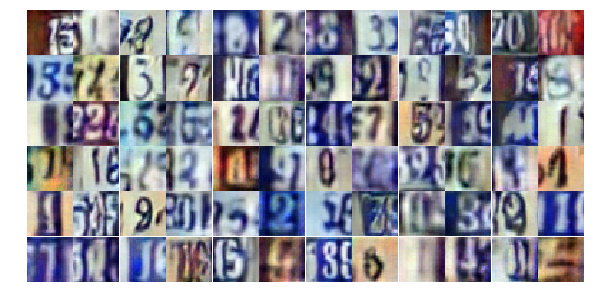

Epoch 22/25... Discriminator Loss: 0.4832... Generator Loss: 1.7154
Epoch 22/25... Discriminator Loss: 0.5097... Generator Loss: 1.3867
Epoch 22/25... Discriminator Loss: 0.6656... Generator Loss: 1.0849
Epoch 22/25... Discriminator Loss: 1.0400... Generator Loss: 0.6338
Epoch 22/25... Discriminator Loss: 1.0961... Generator Loss: 0.5829
Epoch 22/25... Discriminator Loss: 0.7374... Generator Loss: 0.9379
Epoch 22/25... Discriminator Loss: 1.5329... Generator Loss: 0.3799
Epoch 22/25... Discriminator Loss: 0.6292... Generator Loss: 1.0665
Epoch 22/25... Discriminator Loss: 1.2546... Generator Loss: 0.4810
Epoch 22/25... Discriminator Loss: 0.9408... Generator Loss: 0.7533


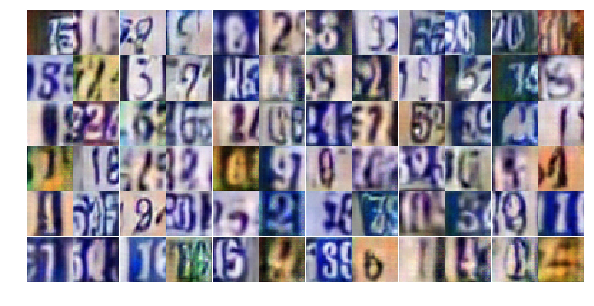

Epoch 22/25... Discriminator Loss: 0.7430... Generator Loss: 1.3492
Epoch 22/25... Discriminator Loss: 0.5927... Generator Loss: 1.1530
Epoch 22/25... Discriminator Loss: 0.3837... Generator Loss: 1.7232
Epoch 22/25... Discriminator Loss: 0.5518... Generator Loss: 1.8820
Epoch 22/25... Discriminator Loss: 0.3447... Generator Loss: 1.9489
Epoch 22/25... Discriminator Loss: 0.4611... Generator Loss: 1.3388
Epoch 22/25... Discriminator Loss: 0.7172... Generator Loss: 1.4706
Epoch 22/25... Discriminator Loss: 0.6593... Generator Loss: 1.1096
Epoch 22/25... Discriminator Loss: 0.9600... Generator Loss: 0.7425
Epoch 22/25... Discriminator Loss: 0.7029... Generator Loss: 1.2557


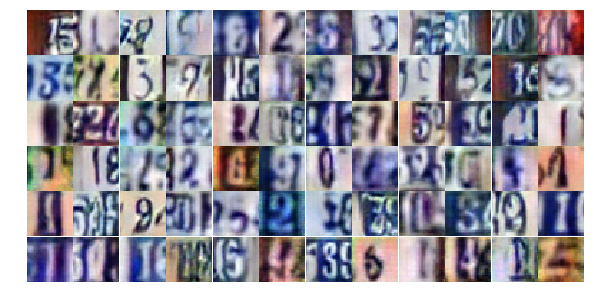

Epoch 22/25... Discriminator Loss: 1.0130... Generator Loss: 0.6950
Epoch 22/25... Discriminator Loss: 0.6240... Generator Loss: 1.1658
Epoch 22/25... Discriminator Loss: 1.0000... Generator Loss: 0.6262
Epoch 22/25... Discriminator Loss: 1.1951... Generator Loss: 0.5457
Epoch 22/25... Discriminator Loss: 2.1483... Generator Loss: 0.1891
Epoch 22/25... Discriminator Loss: 2.0416... Generator Loss: 4.4570
Epoch 22/25... Discriminator Loss: 1.0025... Generator Loss: 0.7675
Epoch 22/25... Discriminator Loss: 0.6427... Generator Loss: 1.0863
Epoch 22/25... Discriminator Loss: 1.1944... Generator Loss: 0.6539
Epoch 22/25... Discriminator Loss: 0.7567... Generator Loss: 0.9407


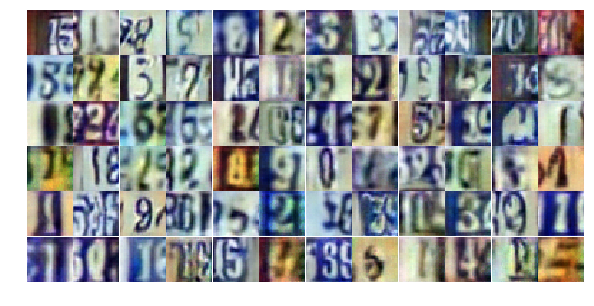

Epoch 23/25... Discriminator Loss: 0.6700... Generator Loss: 1.1958
Epoch 23/25... Discriminator Loss: 0.5074... Generator Loss: 1.3786
Epoch 23/25... Discriminator Loss: 0.8404... Generator Loss: 0.7871
Epoch 23/25... Discriminator Loss: 0.6741... Generator Loss: 1.0076
Epoch 23/25... Discriminator Loss: 0.6575... Generator Loss: 0.9946
Epoch 23/25... Discriminator Loss: 0.9758... Generator Loss: 0.8149
Epoch 23/25... Discriminator Loss: 0.7746... Generator Loss: 0.8606
Epoch 23/25... Discriminator Loss: 1.0089... Generator Loss: 0.6962
Epoch 23/25... Discriminator Loss: 0.7728... Generator Loss: 0.9097
Epoch 23/25... Discriminator Loss: 0.4286... Generator Loss: 1.5097


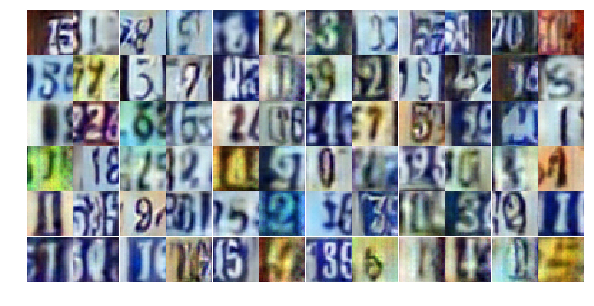

Epoch 23/25... Discriminator Loss: 0.8162... Generator Loss: 0.8358
Epoch 23/25... Discriminator Loss: 0.5414... Generator Loss: 1.1740
Epoch 23/25... Discriminator Loss: 0.7729... Generator Loss: 0.9304
Epoch 23/25... Discriminator Loss: 0.5460... Generator Loss: 2.1216
Epoch 23/25... Discriminator Loss: 0.6286... Generator Loss: 1.0784
Epoch 23/25... Discriminator Loss: 0.9927... Generator Loss: 0.7160
Epoch 23/25... Discriminator Loss: 0.8799... Generator Loss: 0.7367
Epoch 23/25... Discriminator Loss: 0.8460... Generator Loss: 0.8013
Epoch 23/25... Discriminator Loss: 0.8685... Generator Loss: 0.8137
Epoch 23/25... Discriminator Loss: 0.8255... Generator Loss: 0.7718


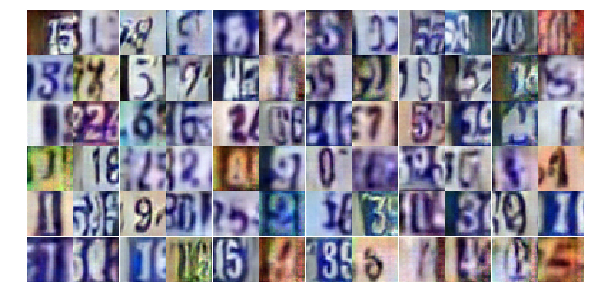

Epoch 23/25... Discriminator Loss: 0.9663... Generator Loss: 0.6743
Epoch 23/25... Discriminator Loss: 0.9494... Generator Loss: 0.7225
Epoch 23/25... Discriminator Loss: 1.2588... Generator Loss: 0.5584
Epoch 23/25... Discriminator Loss: 0.8708... Generator Loss: 0.7245
Epoch 23/25... Discriminator Loss: 0.5695... Generator Loss: 1.5482
Epoch 23/25... Discriminator Loss: 0.8007... Generator Loss: 0.8190
Epoch 23/25... Discriminator Loss: 0.6758... Generator Loss: 1.1355
Epoch 23/25... Discriminator Loss: 1.0985... Generator Loss: 0.6095
Epoch 23/25... Discriminator Loss: 0.5958... Generator Loss: 1.1881
Epoch 23/25... Discriminator Loss: 1.1066... Generator Loss: 0.6672


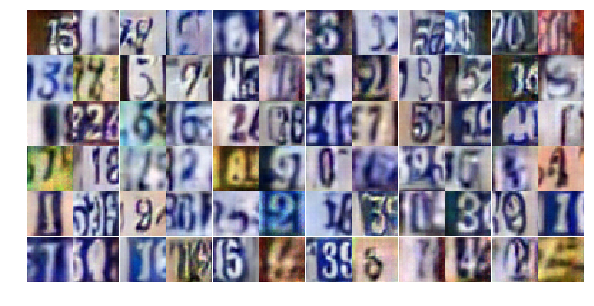

Epoch 23/25... Discriminator Loss: 0.7120... Generator Loss: 0.9268
Epoch 23/25... Discriminator Loss: 0.6004... Generator Loss: 1.1777
Epoch 23/25... Discriminator Loss: 0.6992... Generator Loss: 1.0524
Epoch 23/25... Discriminator Loss: 1.3896... Generator Loss: 0.4061
Epoch 23/25... Discriminator Loss: 0.7979... Generator Loss: 3.0936
Epoch 23/25... Discriminator Loss: 1.0170... Generator Loss: 0.6491
Epoch 23/25... Discriminator Loss: 1.2922... Generator Loss: 0.5248
Epoch 23/25... Discriminator Loss: 0.7304... Generator Loss: 0.9995
Epoch 23/25... Discriminator Loss: 0.5201... Generator Loss: 1.4245
Epoch 23/25... Discriminator Loss: 0.7103... Generator Loss: 0.9852


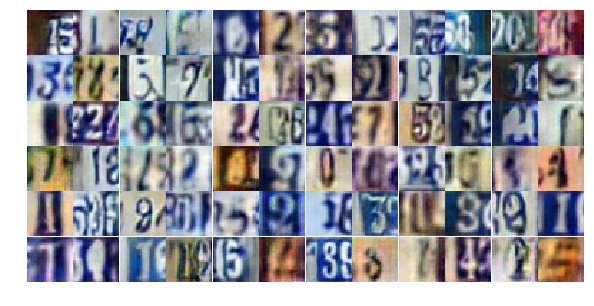

Epoch 23/25... Discriminator Loss: 0.8798... Generator Loss: 0.9249
Epoch 23/25... Discriminator Loss: 0.7737... Generator Loss: 0.9632
Epoch 23/25... Discriminator Loss: 0.6066... Generator Loss: 2.0405
Epoch 23/25... Discriminator Loss: 0.6048... Generator Loss: 1.1627
Epoch 23/25... Discriminator Loss: 1.5306... Generator Loss: 0.4110
Epoch 23/25... Discriminator Loss: 0.9850... Generator Loss: 0.7553
Epoch 23/25... Discriminator Loss: 0.7009... Generator Loss: 1.0431
Epoch 23/25... Discriminator Loss: 1.6096... Generator Loss: 0.3557
Epoch 23/25... Discriminator Loss: 0.6460... Generator Loss: 1.0548
Epoch 23/25... Discriminator Loss: 0.7176... Generator Loss: 1.0707


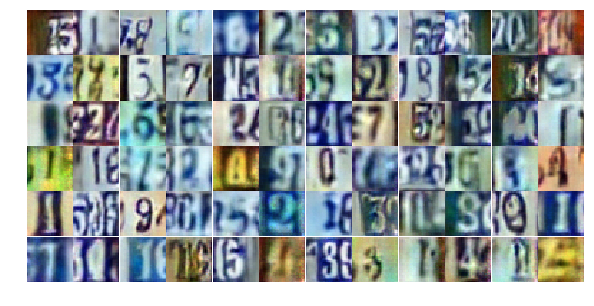

Epoch 23/25... Discriminator Loss: 0.6984... Generator Loss: 1.0146
Epoch 23/25... Discriminator Loss: 1.9505... Generator Loss: 0.2131
Epoch 23/25... Discriminator Loss: 1.8862... Generator Loss: 0.2457
Epoch 23/25... Discriminator Loss: 0.4233... Generator Loss: 1.5152
Epoch 23/25... Discriminator Loss: 1.2912... Generator Loss: 0.5400
Epoch 23/25... Discriminator Loss: 0.7156... Generator Loss: 1.1134
Epoch 23/25... Discriminator Loss: 0.9292... Generator Loss: 0.7302
Epoch 24/25... Discriminator Loss: 1.0354... Generator Loss: 0.6192
Epoch 24/25... Discriminator Loss: 0.7378... Generator Loss: 1.7603
Epoch 24/25... Discriminator Loss: 1.4574... Generator Loss: 0.4218


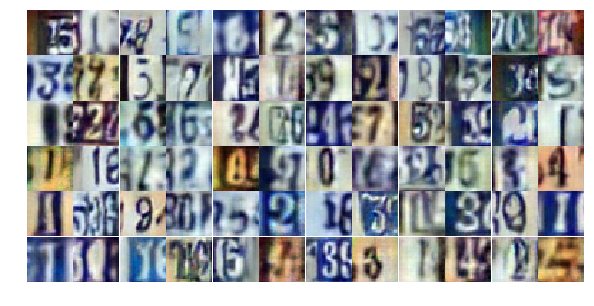

Epoch 24/25... Discriminator Loss: 0.5179... Generator Loss: 1.5297
Epoch 24/25... Discriminator Loss: 0.7241... Generator Loss: 0.9490
Epoch 24/25... Discriminator Loss: 0.7069... Generator Loss: 0.9502
Epoch 24/25... Discriminator Loss: 0.8413... Generator Loss: 0.8908
Epoch 24/25... Discriminator Loss: 1.3527... Generator Loss: 0.4845
Epoch 24/25... Discriminator Loss: 0.5475... Generator Loss: 1.2088
Epoch 24/25... Discriminator Loss: 0.7282... Generator Loss: 1.1698
Epoch 24/25... Discriminator Loss: 1.4711... Generator Loss: 0.3680
Epoch 24/25... Discriminator Loss: 0.4795... Generator Loss: 1.2789
Epoch 24/25... Discriminator Loss: 0.5246... Generator Loss: 1.2003


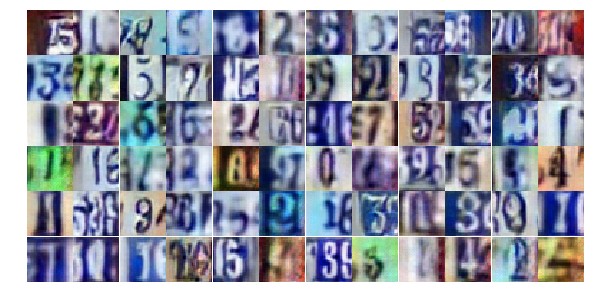

Epoch 24/25... Discriminator Loss: 1.6144... Generator Loss: 0.3247
Epoch 24/25... Discriminator Loss: 0.9463... Generator Loss: 0.8805
Epoch 24/25... Discriminator Loss: 1.0265... Generator Loss: 0.6770
Epoch 24/25... Discriminator Loss: 0.9787... Generator Loss: 0.6313
Epoch 24/25... Discriminator Loss: 0.5940... Generator Loss: 2.5247
Epoch 24/25... Discriminator Loss: 0.8390... Generator Loss: 0.8507
Epoch 24/25... Discriminator Loss: 0.5730... Generator Loss: 1.1673
Epoch 24/25... Discriminator Loss: 0.7295... Generator Loss: 1.2781
Epoch 24/25... Discriminator Loss: 1.2976... Generator Loss: 0.5856
Epoch 24/25... Discriminator Loss: 0.7674... Generator Loss: 0.9645


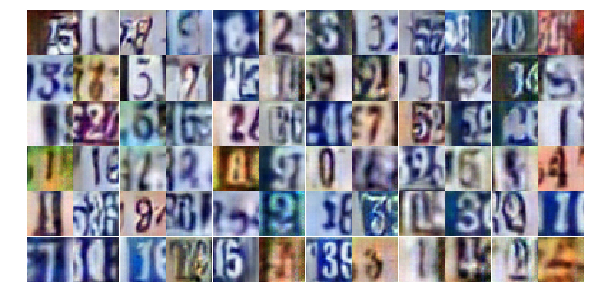

Epoch 24/25... Discriminator Loss: 0.9366... Generator Loss: 0.6913
Epoch 24/25... Discriminator Loss: 0.6288... Generator Loss: 1.3042
Epoch 24/25... Discriminator Loss: 0.6510... Generator Loss: 1.2252
Epoch 24/25... Discriminator Loss: 1.7345... Generator Loss: 0.3037
Epoch 24/25... Discriminator Loss: 0.4944... Generator Loss: 1.3481
Epoch 24/25... Discriminator Loss: 0.5031... Generator Loss: 1.4431
Epoch 24/25... Discriminator Loss: 0.5058... Generator Loss: 1.3145
Epoch 24/25... Discriminator Loss: 2.7276... Generator Loss: 0.2686
Epoch 24/25... Discriminator Loss: 0.8216... Generator Loss: 0.9120
Epoch 24/25... Discriminator Loss: 0.9748... Generator Loss: 0.7672


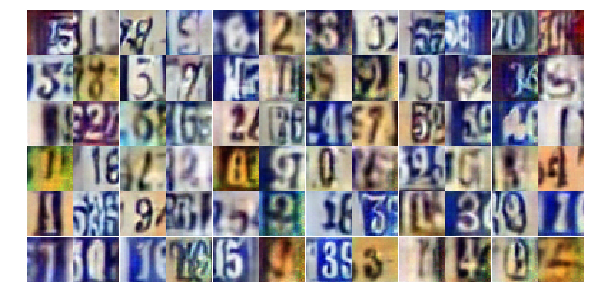

Epoch 24/25... Discriminator Loss: 0.6705... Generator Loss: 1.0815
Epoch 24/25... Discriminator Loss: 0.7861... Generator Loss: 0.7790
Epoch 24/25... Discriminator Loss: 0.9176... Generator Loss: 1.1335
Epoch 24/25... Discriminator Loss: 1.2994... Generator Loss: 0.4504
Epoch 24/25... Discriminator Loss: 1.2780... Generator Loss: 0.4961
Epoch 24/25... Discriminator Loss: 1.1196... Generator Loss: 0.5756
Epoch 24/25... Discriminator Loss: 0.8917... Generator Loss: 0.8448
Epoch 24/25... Discriminator Loss: 0.8930... Generator Loss: 0.7917
Epoch 24/25... Discriminator Loss: 0.6665... Generator Loss: 1.1544
Epoch 24/25... Discriminator Loss: 0.6488... Generator Loss: 1.1539


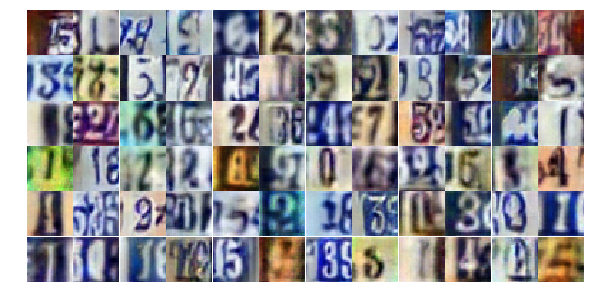

Epoch 24/25... Discriminator Loss: 0.7453... Generator Loss: 1.0274
Epoch 24/25... Discriminator Loss: 0.8831... Generator Loss: 0.7716
Epoch 24/25... Discriminator Loss: 1.0679... Generator Loss: 0.6424
Epoch 24/25... Discriminator Loss: 0.8909... Generator Loss: 1.2416
Epoch 24/25... Discriminator Loss: 1.4208... Generator Loss: 0.5150
Epoch 24/25... Discriminator Loss: 0.6916... Generator Loss: 0.9892
Epoch 24/25... Discriminator Loss: 1.4298... Generator Loss: 0.4068
Epoch 24/25... Discriminator Loss: 0.6723... Generator Loss: 1.1050
Epoch 24/25... Discriminator Loss: 1.0998... Generator Loss: 0.5801
Epoch 24/25... Discriminator Loss: 1.0577... Generator Loss: 0.7874


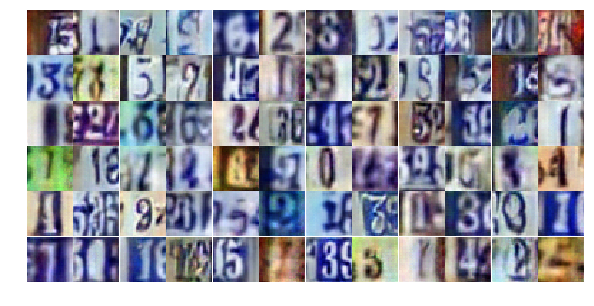

Epoch 24/25... Discriminator Loss: 0.9624... Generator Loss: 0.6880
Epoch 24/25... Discriminator Loss: 2.0005... Generator Loss: 0.2290
Epoch 24/25... Discriminator Loss: 1.3075... Generator Loss: 0.4597
Epoch 24/25... Discriminator Loss: 0.6341... Generator Loss: 1.4367
Epoch 24/25... Discriminator Loss: 1.2032... Generator Loss: 0.5606
Epoch 25/25... Discriminator Loss: 0.6109... Generator Loss: 1.2500
Epoch 25/25... Discriminator Loss: 0.6233... Generator Loss: 1.5201
Epoch 25/25... Discriminator Loss: 0.9329... Generator Loss: 0.7271
Epoch 25/25... Discriminator Loss: 0.8649... Generator Loss: 0.7709
Epoch 25/25... Discriminator Loss: 0.8249... Generator Loss: 0.9021


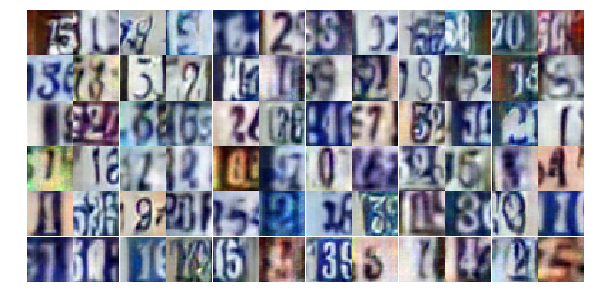

Epoch 25/25... Discriminator Loss: 1.2258... Generator Loss: 0.4734
Epoch 25/25... Discriminator Loss: 0.9917... Generator Loss: 0.8610
Epoch 25/25... Discriminator Loss: 0.8348... Generator Loss: 0.9850
Epoch 25/25... Discriminator Loss: 0.7917... Generator Loss: 0.9307
Epoch 25/25... Discriminator Loss: 0.8595... Generator Loss: 0.8246
Epoch 25/25... Discriminator Loss: 0.9646... Generator Loss: 0.6632
Epoch 25/25... Discriminator Loss: 0.8314... Generator Loss: 0.8529
Epoch 25/25... Discriminator Loss: 0.8521... Generator Loss: 1.5120
Epoch 25/25... Discriminator Loss: 0.6081... Generator Loss: 1.2070
Epoch 25/25... Discriminator Loss: 0.5384... Generator Loss: 1.2326


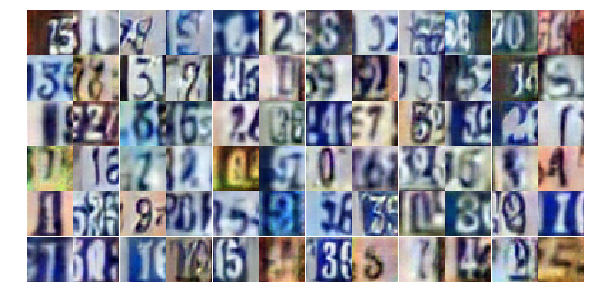

Epoch 25/25... Discriminator Loss: 0.9197... Generator Loss: 0.7257
Epoch 25/25... Discriminator Loss: 0.5629... Generator Loss: 1.2101
Epoch 25/25... Discriminator Loss: 1.1973... Generator Loss: 0.5149
Epoch 25/25... Discriminator Loss: 0.9550... Generator Loss: 0.6719
Epoch 25/25... Discriminator Loss: 0.8100... Generator Loss: 0.8992
Epoch 25/25... Discriminator Loss: 0.6251... Generator Loss: 1.1950
Epoch 25/25... Discriminator Loss: 1.1573... Generator Loss: 0.5821
Epoch 25/25... Discriminator Loss: 0.9784... Generator Loss: 2.1568
Epoch 25/25... Discriminator Loss: 0.6056... Generator Loss: 1.6695
Epoch 25/25... Discriminator Loss: 0.8585... Generator Loss: 0.8162


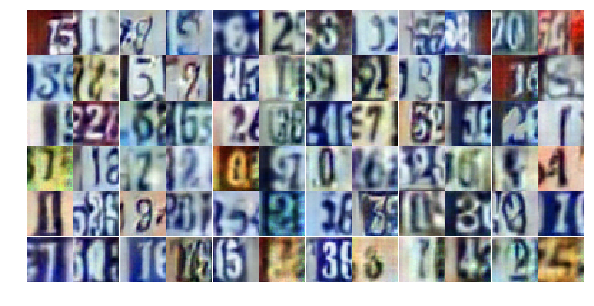

Epoch 25/25... Discriminator Loss: 0.6929... Generator Loss: 1.0327
Epoch 25/25... Discriminator Loss: 0.4674... Generator Loss: 1.9674
Epoch 25/25... Discriminator Loss: 1.7415... Generator Loss: 0.3480
Epoch 25/25... Discriminator Loss: 0.8049... Generator Loss: 0.9749
Epoch 25/25... Discriminator Loss: 0.7773... Generator Loss: 1.0003
Epoch 25/25... Discriminator Loss: 0.5409... Generator Loss: 1.2319
Epoch 25/25... Discriminator Loss: 0.6058... Generator Loss: 1.3606
Epoch 25/25... Discriminator Loss: 0.6745... Generator Loss: 0.9583
Epoch 25/25... Discriminator Loss: 0.7745... Generator Loss: 1.9389
Epoch 25/25... Discriminator Loss: 4.6333... Generator Loss: 0.0297


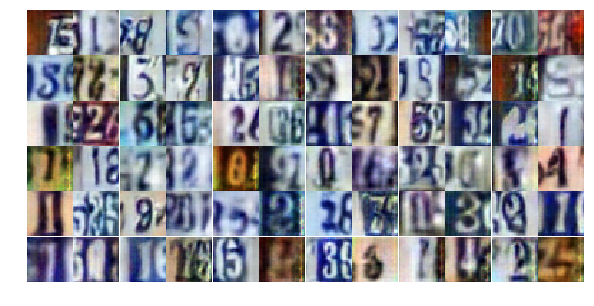

Epoch 25/25... Discriminator Loss: 1.3807... Generator Loss: 0.6361
Epoch 25/25... Discriminator Loss: 1.0738... Generator Loss: 0.7380
Epoch 25/25... Discriminator Loss: 0.7075... Generator Loss: 1.0658
Epoch 25/25... Discriminator Loss: 1.1193... Generator Loss: 0.5463
Epoch 25/25... Discriminator Loss: 0.9041... Generator Loss: 0.8512
Epoch 25/25... Discriminator Loss: 0.9341... Generator Loss: 0.8094
Epoch 25/25... Discriminator Loss: 0.5754... Generator Loss: 1.2864
Epoch 25/25... Discriminator Loss: 1.0718... Generator Loss: 0.6145
Epoch 25/25... Discriminator Loss: 1.3851... Generator Loss: 0.5488
Epoch 25/25... Discriminator Loss: 0.5838... Generator Loss: 1.1522


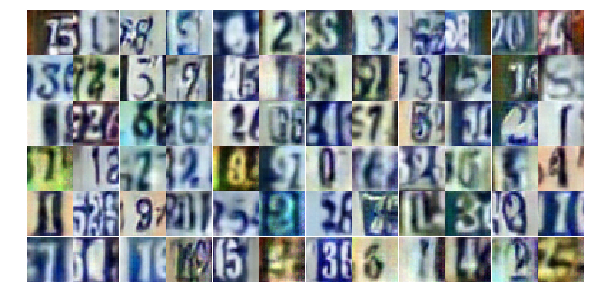

Epoch 25/25... Discriminator Loss: 1.3529... Generator Loss: 0.4508
Epoch 25/25... Discriminator Loss: 0.6936... Generator Loss: 1.0323
Epoch 25/25... Discriminator Loss: 0.8761... Generator Loss: 0.8420
Epoch 25/25... Discriminator Loss: 1.2647... Generator Loss: 0.4788
Epoch 25/25... Discriminator Loss: 1.0543... Generator Loss: 0.7355
Epoch 25/25... Discriminator Loss: 0.5308... Generator Loss: 1.2032
Epoch 25/25... Discriminator Loss: 1.3906... Generator Loss: 0.4144
Epoch 25/25... Discriminator Loss: 0.7449... Generator Loss: 1.5026
Epoch 25/25... Discriminator Loss: 1.1929... Generator Loss: 0.5943
Epoch 25/25... Discriminator Loss: 0.6928... Generator Loss: 0.9834


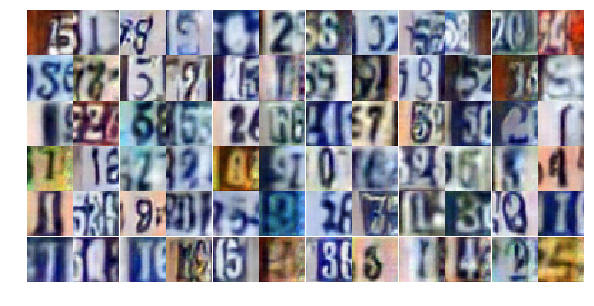

Epoch 25/25... Discriminator Loss: 0.4273... Generator Loss: 1.8142
Epoch 25/25... Discriminator Loss: 1.6919... Generator Loss: 0.2767


In [22]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

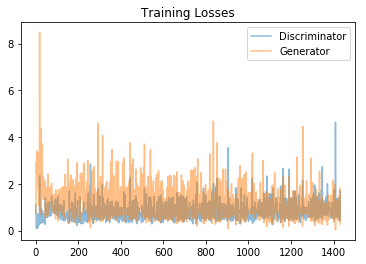

In [23]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

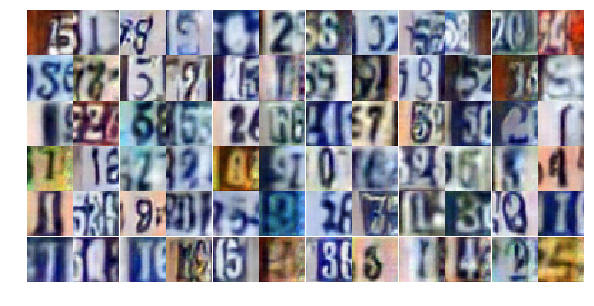

In [24]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))